# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

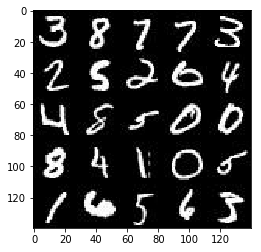

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

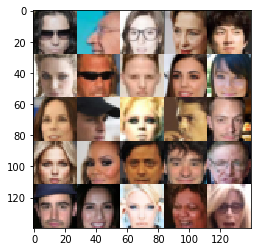

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0


/home/tia/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:14: UserWarning: No GPU found. Please use a GPU to train your neural network.


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    inputs = tf.placeholder(tf.float32, shape=(None,image_width,image_height,image_channels), name='inputs')
    z = tf.placeholder(tf.float32, shape=(None,z_dim), name='z')
    lr = tf.placeholder(tf.float32, name='learning_rate')
    return inputs, z, lr


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [6]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    
    # Hyperparameters
    alpha = 0.2  
    h1_filters = 128
    h2_filters = 256
    h3_filters = 512
    
    #build model
    with tf.variable_scope('discriminator', reuse=reuse):
        #images_channel = images.get_shape().as_list()[3]
        h1 = tf.layers.conv2d(images, h1_filters, 5, strides=2, padding='same')
        h1 = tf.maximum(alpha * h1, h1)
        #now 14 x 14 x 128
        
        h2 = tf.layers.conv2d(h1, h2_filters, 5, strides=2, padding='same')
        h2 = tf.layers.batch_normalization(h2, training=True)
        h2 = tf.maximum(alpha * h2, h2)
        #now 7 x 7 x 256
        
        h3 = tf.layers.conv2d(h2, h3_filters, 3, strides=2, padding='same')
        h3 = tf.layers.batch_normalization(h3, training=True)
        h3 = tf.maximum(alpha * h3, h3)
        #now 4 x 4 x 512
        
        
        flat = tf.reshape(h3, (-1, 4 * 4 * h3_filters))
        
        logits = tf.layers.dense(flat,1)
        out = tf.nn.sigmoid(logits)
        
        return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    
    # Hyperparameters
    alpha = 0.2  
    h1_filters = 512
    h2_filters = 256
    h3_filters = 128
    
    #build model
    with tf.variable_scope('generator', reuse=not is_train):
        h1 = tf.layers.dense(z, 3 * 3 * h1_filters)
        h1 = tf.reshape(h1, (-1, 3, 3, h1_filters))
        h1 = tf.layers.batch_normalization(h1, training=is_train)
        h1 = tf.maximum(alpha * h1, h1)
        #now 3 x 3 x 512
        
        h2 = tf.layers.conv2d_transpose(h1, h2_filters, 3, strides=2, padding='valid')
        h2 = tf.layers.batch_normalization(h2, training=is_train)
        h2 = tf.maximum(alpha * h2, h2)
        #now 7 x 7 x 256
        
        h3 = tf.layers.conv2d_transpose(h2, h3_filters, 5, strides=2, padding='same')
        h3 = tf.layers.batch_normalization(h3, training=is_train)
        h3 = tf.maximum(alpha * h3, h3)
        #now 14 x 14 x 128
        
        logits = tf.layers.conv2d_transpose(h3, out_channel_dim, 5, strides=2, padding='same')
        image = tf.nn.tanh(logits)
        return image


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    
    # Hyperparameters
    smooth = 0.1
    
    out_real, logits_real = discriminator(input_real)
    
    image_fake = generator(input_z, out_channel_dim, is_train=True)
    
    out_fake, logits_fake = discriminator(image_fake, reuse=True)
    
    d_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(labels=tf.ones_like(logits_real) * (1 - smooth), 
                                                     logits=logits_real))
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(labels=tf.zeros_like(logits_fake),
                                                          logits=logits_fake))
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(labels=tf.ones_like(logits_fake),
                                                          logits=logits_fake))
    
    return d_loss + d_loss_fake, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    
    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    #saver = tf.train.Saver()

    steps = 0
        
    input_real, input_z, lr = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])
    
    d_train_opt, g_train_opt = model_opt(d_loss, g_loss, lr, beta1)
        
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                steps += 1
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                # real images rescale
                batch_images = batch_images * 2.0
                
                # Run optimizers
                _ = sess.run(d_train_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr:learning_rate})
                _ = sess.run(g_train_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr:learning_rate})
                
                if steps % 10 == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({input_real: batch_images, input_z: batch_z})
                    train_loss_g = g_loss.eval({input_z: batch_z})

                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))

                if steps % 100 == 0:
                    show_generator_output(sess, 25, input_z, data_shape[3], data_image_mode)


### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2... Discriminator Loss: 0.5156... Generator Loss: 5.7589
Epoch 1/2... Discriminator Loss: 1.5636... Generator Loss: 0.5048
Epoch 1/2... Discriminator Loss: 0.6073... Generator Loss: 2.4074
Epoch 1/2... Discriminator Loss: 1.1610... Generator Loss: 6.2258
Epoch 1/2... Discriminator Loss: 0.6811... Generator Loss: 4.8196
Epoch 1/2... Discriminator Loss: 0.5586... Generator Loss: 2.3557
Epoch 1/2... Discriminator Loss: 0.5487... Generator Loss: 2.3241
Epoch 1/2... Discriminator Loss: 0.4802... Generator Loss: 3.5235
Epoch 1/2... Discriminator Loss: 0.9406... Generator Loss: 3.4780
Epoch 1/2... Discriminator Loss: 0.8560... Generator Loss: 1.1576


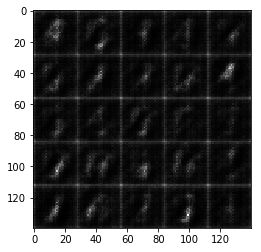

Epoch 1/2... Discriminator Loss: 0.6407... Generator Loss: 2.1974
Epoch 1/2... Discriminator Loss: 0.7361... Generator Loss: 1.8424
Epoch 1/2... Discriminator Loss: 0.6390... Generator Loss: 2.1199
Epoch 1/2... Discriminator Loss: 0.7263... Generator Loss: 1.4493
Epoch 1/2... Discriminator Loss: 0.8940... Generator Loss: 3.7485
Epoch 1/2... Discriminator Loss: 0.5859... Generator Loss: 2.8066
Epoch 1/2... Discriminator Loss: 0.6692... Generator Loss: 1.9261
Epoch 1/2... Discriminator Loss: 0.8702... Generator Loss: 1.2862
Epoch 1/2... Discriminator Loss: 0.7834... Generator Loss: 1.3113
Epoch 1/2... Discriminator Loss: 0.7467... Generator Loss: 1.4407


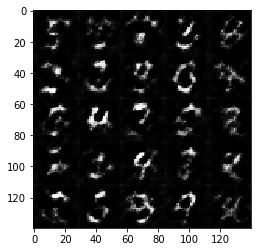

Epoch 1/2... Discriminator Loss: 1.0635... Generator Loss: 3.3336
Epoch 1/2... Discriminator Loss: 0.8711... Generator Loss: 1.1537
Epoch 1/2... Discriminator Loss: 0.7327... Generator Loss: 2.1697
Epoch 1/2... Discriminator Loss: 0.7142... Generator Loss: 1.5911
Epoch 1/2... Discriminator Loss: 0.8927... Generator Loss: 3.3599
Epoch 1/2... Discriminator Loss: 1.1747... Generator Loss: 3.1110
Epoch 1/2... Discriminator Loss: 0.8894... Generator Loss: 1.9892
Epoch 1/2... Discriminator Loss: 0.7548... Generator Loss: 1.6711
Epoch 1/2... Discriminator Loss: 0.6928... Generator Loss: 1.9294
Epoch 1/2... Discriminator Loss: 0.7112... Generator Loss: 1.4647


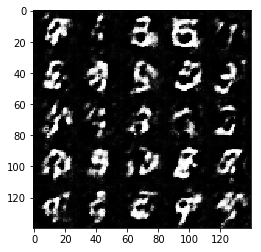

Epoch 1/2... Discriminator Loss: 0.6965... Generator Loss: 2.3144
Epoch 1/2... Discriminator Loss: 0.6658... Generator Loss: 1.7898
Epoch 1/2... Discriminator Loss: 0.8612... Generator Loss: 2.3449
Epoch 1/2... Discriminator Loss: 1.1625... Generator Loss: 4.2994
Epoch 1/2... Discriminator Loss: 0.7560... Generator Loss: 1.2609
Epoch 1/2... Discriminator Loss: 0.6865... Generator Loss: 1.4957
Epoch 1/2... Discriminator Loss: 0.7407... Generator Loss: 1.4043
Epoch 1/2... Discriminator Loss: 0.6019... Generator Loss: 2.1169
Epoch 1/2... Discriminator Loss: 0.7154... Generator Loss: 2.8160
Epoch 1/2... Discriminator Loss: 0.6241... Generator Loss: 2.2607


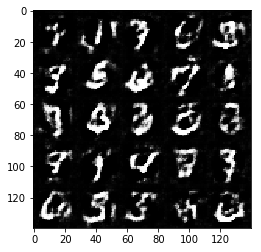

Epoch 1/2... Discriminator Loss: 1.0892... Generator Loss: 3.3974
Epoch 1/2... Discriminator Loss: 0.7623... Generator Loss: 1.2457
Epoch 1/2... Discriminator Loss: 0.6112... Generator Loss: 2.4251
Epoch 1/2... Discriminator Loss: 0.6350... Generator Loss: 1.7797
Epoch 1/2... Discriminator Loss: 0.8125... Generator Loss: 1.2408
Epoch 1/2... Discriminator Loss: 1.0182... Generator Loss: 0.9300
Epoch 1/2... Discriminator Loss: 0.6593... Generator Loss: 2.0481
Epoch 1/2... Discriminator Loss: 0.7620... Generator Loss: 1.3055
Epoch 1/2... Discriminator Loss: 0.6311... Generator Loss: 1.8252
Epoch 1/2... Discriminator Loss: 1.0336... Generator Loss: 0.7815


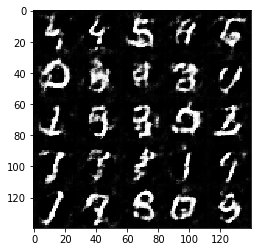

Epoch 1/2... Discriminator Loss: 0.6768... Generator Loss: 1.7385
Epoch 1/2... Discriminator Loss: 0.6733... Generator Loss: 1.7628
Epoch 1/2... Discriminator Loss: 0.9756... Generator Loss: 2.4644
Epoch 1/2... Discriminator Loss: 0.9443... Generator Loss: 0.9789
Epoch 1/2... Discriminator Loss: 0.8015... Generator Loss: 3.0220
Epoch 1/2... Discriminator Loss: 0.9261... Generator Loss: 0.9614
Epoch 1/2... Discriminator Loss: 0.7460... Generator Loss: 1.4808
Epoch 1/2... Discriminator Loss: 0.7453... Generator Loss: 1.5319
Epoch 1/2... Discriminator Loss: 0.7355... Generator Loss: 2.6748
Epoch 1/2... Discriminator Loss: 0.8316... Generator Loss: 1.2487


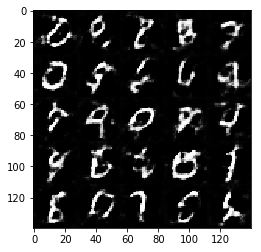

Epoch 1/2... Discriminator Loss: 0.6956... Generator Loss: 1.9702
Epoch 1/2... Discriminator Loss: 0.7832... Generator Loss: 2.3523
Epoch 1/2... Discriminator Loss: 0.7441... Generator Loss: 1.3560
Epoch 1/2... Discriminator Loss: 0.6428... Generator Loss: 1.5919
Epoch 1/2... Discriminator Loss: 1.0706... Generator Loss: 0.8089
Epoch 1/2... Discriminator Loss: 0.8162... Generator Loss: 2.1384
Epoch 1/2... Discriminator Loss: 0.8908... Generator Loss: 1.0995
Epoch 1/2... Discriminator Loss: 0.7072... Generator Loss: 2.3068
Epoch 1/2... Discriminator Loss: 0.7654... Generator Loss: 1.9409
Epoch 1/2... Discriminator Loss: 0.8917... Generator Loss: 1.0187


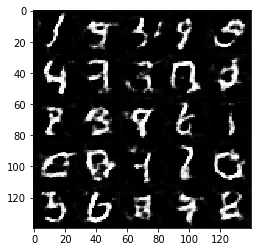

Epoch 1/2... Discriminator Loss: 0.6480... Generator Loss: 1.8274
Epoch 1/2... Discriminator Loss: 0.8536... Generator Loss: 1.1019
Epoch 1/2... Discriminator Loss: 0.7726... Generator Loss: 2.4708
Epoch 1/2... Discriminator Loss: 0.8698... Generator Loss: 2.7495
Epoch 1/2... Discriminator Loss: 0.8185... Generator Loss: 1.2789
Epoch 1/2... Discriminator Loss: 0.8296... Generator Loss: 1.0955
Epoch 1/2... Discriminator Loss: 0.9038... Generator Loss: 1.0432
Epoch 1/2... Discriminator Loss: 0.6500... Generator Loss: 1.9469
Epoch 1/2... Discriminator Loss: 0.8676... Generator Loss: 1.0806
Epoch 1/2... Discriminator Loss: 0.9609... Generator Loss: 0.9461


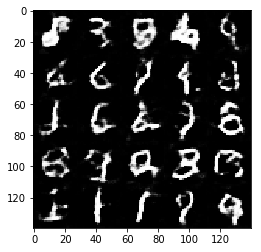

Epoch 1/2... Discriminator Loss: 0.6572... Generator Loss: 1.7249
Epoch 1/2... Discriminator Loss: 0.7552... Generator Loss: 2.1371
Epoch 1/2... Discriminator Loss: 0.8201... Generator Loss: 2.6138
Epoch 1/2... Discriminator Loss: 0.9139... Generator Loss: 2.8020
Epoch 1/2... Discriminator Loss: 0.8092... Generator Loss: 1.1872
Epoch 1/2... Discriminator Loss: 0.6576... Generator Loss: 1.7450
Epoch 1/2... Discriminator Loss: 0.7393... Generator Loss: 1.3114
Epoch 1/2... Discriminator Loss: 1.0238... Generator Loss: 0.8798
Epoch 1/2... Discriminator Loss: 0.7953... Generator Loss: 1.3964
Epoch 1/2... Discriminator Loss: 0.7411... Generator Loss: 2.6819


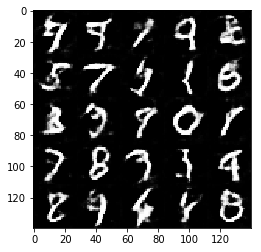

Epoch 1/2... Discriminator Loss: 0.8101... Generator Loss: 1.1294
Epoch 1/2... Discriminator Loss: 0.7346... Generator Loss: 1.3427
Epoch 1/2... Discriminator Loss: 1.0301... Generator Loss: 0.9126
Epoch 2/2... Discriminator Loss: 0.7489... Generator Loss: 1.3355
Epoch 2/2... Discriminator Loss: 0.8279... Generator Loss: 2.6445
Epoch 2/2... Discriminator Loss: 0.6768... Generator Loss: 1.6210
Epoch 2/2... Discriminator Loss: 1.2060... Generator Loss: 0.7127
Epoch 2/2... Discriminator Loss: 0.8295... Generator Loss: 1.3322
Epoch 2/2... Discriminator Loss: 0.6640... Generator Loss: 1.6247
Epoch 2/2... Discriminator Loss: 0.9139... Generator Loss: 0.9402


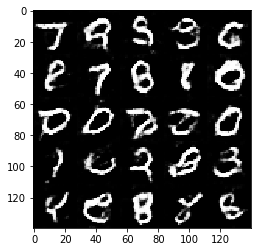

Epoch 2/2... Discriminator Loss: 0.6640... Generator Loss: 1.8803
Epoch 2/2... Discriminator Loss: 0.8842... Generator Loss: 1.0414
Epoch 2/2... Discriminator Loss: 0.9581... Generator Loss: 1.2682
Epoch 2/2... Discriminator Loss: 0.8548... Generator Loss: 1.1536
Epoch 2/2... Discriminator Loss: 0.6947... Generator Loss: 1.5008
Epoch 2/2... Discriminator Loss: 0.8533... Generator Loss: 1.1055
Epoch 2/2... Discriminator Loss: 0.5849... Generator Loss: 2.0040
Epoch 2/2... Discriminator Loss: 0.7842... Generator Loss: 1.1652
Epoch 2/2... Discriminator Loss: 0.9949... Generator Loss: 0.8547
Epoch 2/2... Discriminator Loss: 0.6431... Generator Loss: 2.3785


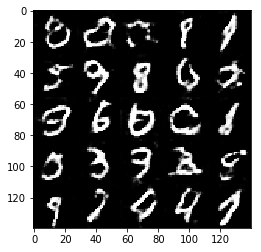

Epoch 2/2... Discriminator Loss: 0.6440... Generator Loss: 1.5097
Epoch 2/2... Discriminator Loss: 1.0659... Generator Loss: 2.2496
Epoch 2/2... Discriminator Loss: 0.8225... Generator Loss: 1.3105
Epoch 2/2... Discriminator Loss: 0.8158... Generator Loss: 1.6775
Epoch 2/2... Discriminator Loss: 0.6606... Generator Loss: 1.5317
Epoch 2/2... Discriminator Loss: 0.8853... Generator Loss: 0.9981
Epoch 2/2... Discriminator Loss: 0.7166... Generator Loss: 1.8789
Epoch 2/2... Discriminator Loss: 0.7288... Generator Loss: 1.2727
Epoch 2/2... Discriminator Loss: 0.8545... Generator Loss: 1.0726
Epoch 2/2... Discriminator Loss: 0.8461... Generator Loss: 1.0380


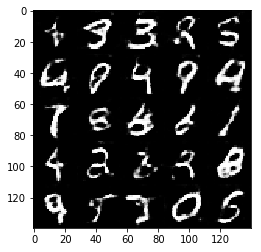

Epoch 2/2... Discriminator Loss: 0.7760... Generator Loss: 1.1495
Epoch 2/2... Discriminator Loss: 1.7061... Generator Loss: 0.4052
Epoch 2/2... Discriminator Loss: 1.0116... Generator Loss: 0.8513
Epoch 2/2... Discriminator Loss: 0.8225... Generator Loss: 2.4135
Epoch 2/2... Discriminator Loss: 0.6375... Generator Loss: 1.6647
Epoch 2/2... Discriminator Loss: 0.6261... Generator Loss: 1.8516
Epoch 2/2... Discriminator Loss: 0.9808... Generator Loss: 0.8815
Epoch 2/2... Discriminator Loss: 0.7094... Generator Loss: 1.3731
Epoch 2/2... Discriminator Loss: 0.9306... Generator Loss: 0.9322
Epoch 2/2... Discriminator Loss: 0.6597... Generator Loss: 2.6562


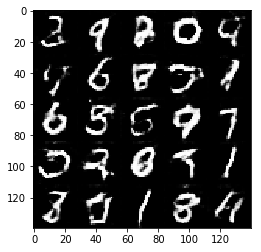

Epoch 2/2... Discriminator Loss: 1.7808... Generator Loss: 3.7688
Epoch 2/2... Discriminator Loss: 0.7165... Generator Loss: 2.1545
Epoch 2/2... Discriminator Loss: 0.6102... Generator Loss: 1.6573
Epoch 2/2... Discriminator Loss: 0.8696... Generator Loss: 1.0461
Epoch 2/2... Discriminator Loss: 0.8955... Generator Loss: 1.0049
Epoch 2/2... Discriminator Loss: 0.7533... Generator Loss: 1.3204
Epoch 2/2... Discriminator Loss: 0.7715... Generator Loss: 1.1677
Epoch 2/2... Discriminator Loss: 1.6241... Generator Loss: 3.7383
Epoch 2/2... Discriminator Loss: 0.7334... Generator Loss: 1.5929
Epoch 2/2... Discriminator Loss: 0.5751... Generator Loss: 2.0063


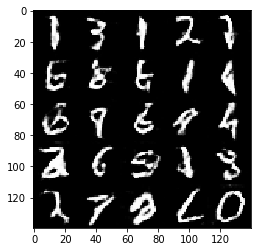

Epoch 2/2... Discriminator Loss: 0.6890... Generator Loss: 1.4896
Epoch 2/2... Discriminator Loss: 0.7822... Generator Loss: 1.3559
Epoch 2/2... Discriminator Loss: 0.9662... Generator Loss: 0.9264
Epoch 2/2... Discriminator Loss: 0.8345... Generator Loss: 1.3663
Epoch 2/2... Discriminator Loss: 0.7369... Generator Loss: 1.2597
Epoch 2/2... Discriminator Loss: 0.6158... Generator Loss: 1.6719
Epoch 2/2... Discriminator Loss: 0.6669... Generator Loss: 1.5059
Epoch 2/2... Discriminator Loss: 0.7474... Generator Loss: 1.2482
Epoch 2/2... Discriminator Loss: 0.6767... Generator Loss: 1.4209
Epoch 2/2... Discriminator Loss: 0.8230... Generator Loss: 1.0960


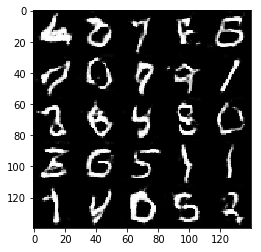

Epoch 2/2... Discriminator Loss: 1.1244... Generator Loss: 0.7005
Epoch 2/2... Discriminator Loss: 0.6515... Generator Loss: 1.9506
Epoch 2/2... Discriminator Loss: 0.7338... Generator Loss: 1.3562
Epoch 2/2... Discriminator Loss: 0.8134... Generator Loss: 1.1861
Epoch 2/2... Discriminator Loss: 0.6339... Generator Loss: 1.5958
Epoch 2/2... Discriminator Loss: 1.1455... Generator Loss: 0.7302
Epoch 2/2... Discriminator Loss: 0.7071... Generator Loss: 1.3634
Epoch 2/2... Discriminator Loss: 0.8792... Generator Loss: 1.0189
Epoch 2/2... Discriminator Loss: 0.8286... Generator Loss: 1.0954
Epoch 2/2... Discriminator Loss: 1.2763... Generator Loss: 3.0620


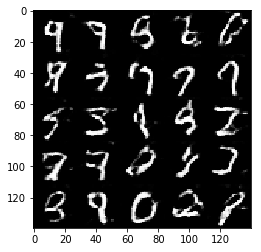

Epoch 2/2... Discriminator Loss: 0.8363... Generator Loss: 1.9150
Epoch 2/2... Discriminator Loss: 0.7439... Generator Loss: 1.3530
Epoch 2/2... Discriminator Loss: 0.9746... Generator Loss: 0.8901
Epoch 2/2... Discriminator Loss: 1.6905... Generator Loss: 0.4145
Epoch 2/2... Discriminator Loss: 0.8895... Generator Loss: 2.4755
Epoch 2/2... Discriminator Loss: 0.6520... Generator Loss: 1.6396
Epoch 2/2... Discriminator Loss: 0.8334... Generator Loss: 1.0913
Epoch 2/2... Discriminator Loss: 0.8265... Generator Loss: 1.8387
Epoch 2/2... Discriminator Loss: 0.6547... Generator Loss: 2.2296
Epoch 2/2... Discriminator Loss: 0.7161... Generator Loss: 1.4896


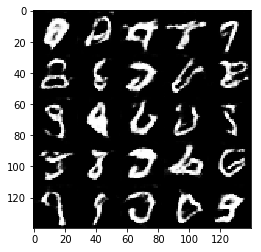

Epoch 2/2... Discriminator Loss: 0.6411... Generator Loss: 2.2253
Epoch 2/2... Discriminator Loss: 0.7936... Generator Loss: 1.1789
Epoch 2/2... Discriminator Loss: 0.7531... Generator Loss: 1.2771
Epoch 2/2... Discriminator Loss: 0.6514... Generator Loss: 1.4428
Epoch 2/2... Discriminator Loss: 0.8597... Generator Loss: 1.1685
Epoch 2/2... Discriminator Loss: 0.7409... Generator Loss: 1.6921
Epoch 2/2... Discriminator Loss: 0.8733... Generator Loss: 1.1216
Epoch 2/2... Discriminator Loss: 1.0304... Generator Loss: 0.8866
Epoch 2/2... Discriminator Loss: 0.6389... Generator Loss: 1.8933
Epoch 2/2... Discriminator Loss: 0.6865... Generator Loss: 1.5142


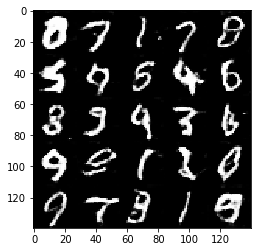

Epoch 2/2... Discriminator Loss: 0.6190... Generator Loss: 1.6349
Epoch 2/2... Discriminator Loss: 0.9515... Generator Loss: 1.8251
Epoch 2/2... Discriminator Loss: 1.0233... Generator Loss: 2.4382
Epoch 2/2... Discriminator Loss: 0.7090... Generator Loss: 1.7094
Epoch 2/2... Discriminator Loss: 0.9050... Generator Loss: 1.0122
Epoch 2/2... Discriminator Loss: 0.8980... Generator Loss: 1.0108
Epoch 2/2... Discriminator Loss: 0.8083... Generator Loss: 2.9772


In [12]:
batch_size = 64
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/4... Discriminator Loss: 0.6634... Generator Loss: 1.6905
Epoch 1/4... Discriminator Loss: 0.4642... Generator Loss: 2.5747
Epoch 1/4... Discriminator Loss: 0.3919... Generator Loss: 3.6807
Epoch 1/4... Discriminator Loss: 0.4351... Generator Loss: 4.9298
Epoch 1/4... Discriminator Loss: 0.4261... Generator Loss: 2.8850
Epoch 1/4... Discriminator Loss: 0.7053... Generator Loss: 2.5144
Epoch 1/4... Discriminator Loss: 0.9889... Generator Loss: 1.3932
Epoch 1/4... Discriminator Loss: 0.6682... Generator Loss: 2.6458
Epoch 1/4... Discriminator Loss: 2.3679... Generator Loss: 10.7066
Epoch 1/4... Discriminator Loss: 1.5836... Generator Loss: 6.4616


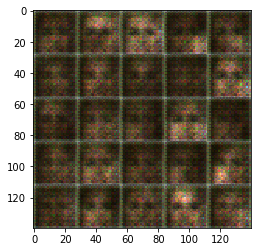

Epoch 1/4... Discriminator Loss: 0.5527... Generator Loss: 2.3471
Epoch 1/4... Discriminator Loss: 0.5237... Generator Loss: 2.3599
Epoch 1/4... Discriminator Loss: 0.5476... Generator Loss: 4.1704
Epoch 1/4... Discriminator Loss: 0.8951... Generator Loss: 1.4519
Epoch 1/4... Discriminator Loss: 0.7037... Generator Loss: 3.6779
Epoch 1/4... Discriminator Loss: 0.6481... Generator Loss: 1.7538
Epoch 1/4... Discriminator Loss: 0.5138... Generator Loss: 2.9275
Epoch 1/4... Discriminator Loss: 3.3002... Generator Loss: 8.7491
Epoch 1/4... Discriminator Loss: 0.6838... Generator Loss: 2.2489
Epoch 1/4... Discriminator Loss: 0.7836... Generator Loss: 1.4665


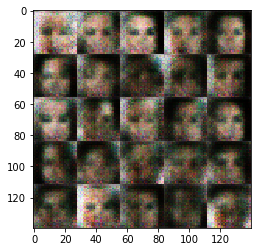

Epoch 1/4... Discriminator Loss: 0.8618... Generator Loss: 1.8692
Epoch 1/4... Discriminator Loss: 1.0089... Generator Loss: 2.7127
Epoch 1/4... Discriminator Loss: 2.0106... Generator Loss: 6.6721
Epoch 1/4... Discriminator Loss: 1.1128... Generator Loss: 0.7101
Epoch 1/4... Discriminator Loss: 0.8023... Generator Loss: 1.6204
Epoch 1/4... Discriminator Loss: 1.2837... Generator Loss: 0.7271
Epoch 1/4... Discriminator Loss: 0.8180... Generator Loss: 1.3958
Epoch 1/4... Discriminator Loss: 0.7565... Generator Loss: 1.7593
Epoch 1/4... Discriminator Loss: 0.9663... Generator Loss: 1.0280
Epoch 1/4... Discriminator Loss: 0.5886... Generator Loss: 2.2770


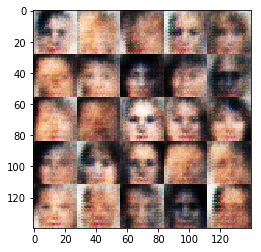

Epoch 1/4... Discriminator Loss: 1.5239... Generator Loss: 0.4799
Epoch 1/4... Discriminator Loss: 0.8669... Generator Loss: 1.6160
Epoch 1/4... Discriminator Loss: 0.8401... Generator Loss: 1.3401
Epoch 1/4... Discriminator Loss: 0.6674... Generator Loss: 2.2473
Epoch 1/4... Discriminator Loss: 0.4897... Generator Loss: 3.5131
Epoch 1/4... Discriminator Loss: 0.7085... Generator Loss: 1.9651
Epoch 1/4... Discriminator Loss: 1.0616... Generator Loss: 0.9423
Epoch 1/4... Discriminator Loss: 0.9837... Generator Loss: 4.5344
Epoch 1/4... Discriminator Loss: 1.2607... Generator Loss: 0.6698
Epoch 1/4... Discriminator Loss: 0.7733... Generator Loss: 1.9289


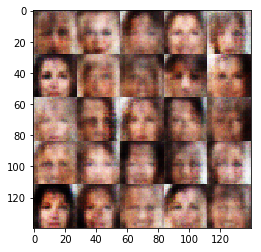

Epoch 1/4... Discriminator Loss: 1.2790... Generator Loss: 4.1380
Epoch 1/4... Discriminator Loss: 1.3720... Generator Loss: 0.6787
Epoch 1/4... Discriminator Loss: 0.5276... Generator Loss: 2.8020
Epoch 1/4... Discriminator Loss: 0.7115... Generator Loss: 1.8258
Epoch 1/4... Discriminator Loss: 0.7944... Generator Loss: 2.8884
Epoch 1/4... Discriminator Loss: 1.3938... Generator Loss: 0.6767
Epoch 1/4... Discriminator Loss: 0.6595... Generator Loss: 1.9810
Epoch 1/4... Discriminator Loss: 0.6857... Generator Loss: 3.1252
Epoch 1/4... Discriminator Loss: 0.6982... Generator Loss: 1.4637
Epoch 1/4... Discriminator Loss: 1.0516... Generator Loss: 0.9035


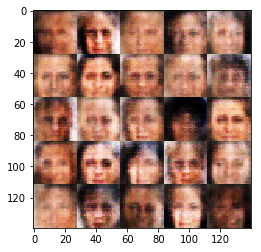

Epoch 1/4... Discriminator Loss: 0.8040... Generator Loss: 2.8502
Epoch 1/4... Discriminator Loss: 0.7531... Generator Loss: 1.6232
Epoch 1/4... Discriminator Loss: 0.8975... Generator Loss: 1.3644
Epoch 1/4... Discriminator Loss: 0.7228... Generator Loss: 2.0628
Epoch 1/4... Discriminator Loss: 1.2013... Generator Loss: 0.8539
Epoch 1/4... Discriminator Loss: 0.7933... Generator Loss: 2.1242
Epoch 1/4... Discriminator Loss: 0.7723... Generator Loss: 2.0745
Epoch 1/4... Discriminator Loss: 0.7016... Generator Loss: 1.7057
Epoch 1/4... Discriminator Loss: 0.9369... Generator Loss: 3.6634
Epoch 1/4... Discriminator Loss: 0.9580... Generator Loss: 2.0271


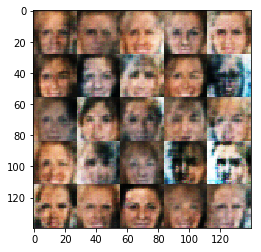

Epoch 1/4... Discriminator Loss: 1.0876... Generator Loss: 0.9100
Epoch 1/4... Discriminator Loss: 1.0450... Generator Loss: 0.9001
Epoch 1/4... Discriminator Loss: 0.8958... Generator Loss: 1.1618
Epoch 1/4... Discriminator Loss: 0.8950... Generator Loss: 2.8749
Epoch 1/4... Discriminator Loss: 1.1152... Generator Loss: 0.7976
Epoch 1/4... Discriminator Loss: 0.9598... Generator Loss: 1.0713
Epoch 1/4... Discriminator Loss: 1.0153... Generator Loss: 0.9033
Epoch 1/4... Discriminator Loss: 0.8127... Generator Loss: 1.1867
Epoch 1/4... Discriminator Loss: 0.9443... Generator Loss: 1.1367
Epoch 1/4... Discriminator Loss: 0.9704... Generator Loss: 1.2862


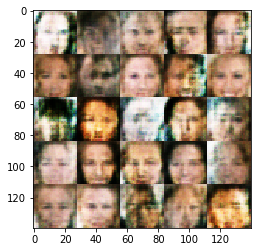

Epoch 1/4... Discriminator Loss: 1.2820... Generator Loss: 0.6442
Epoch 1/4... Discriminator Loss: 1.0604... Generator Loss: 1.9763
Epoch 1/4... Discriminator Loss: 0.9262... Generator Loss: 1.0451
Epoch 1/4... Discriminator Loss: 0.8784... Generator Loss: 1.0963
Epoch 1/4... Discriminator Loss: 0.7537... Generator Loss: 1.7939
Epoch 1/4... Discriminator Loss: 0.9174... Generator Loss: 1.0345
Epoch 1/4... Discriminator Loss: 0.9091... Generator Loss: 1.1097
Epoch 1/4... Discriminator Loss: 0.9334... Generator Loss: 1.0438
Epoch 1/4... Discriminator Loss: 1.3557... Generator Loss: 0.6795
Epoch 1/4... Discriminator Loss: 0.7631... Generator Loss: 1.7593


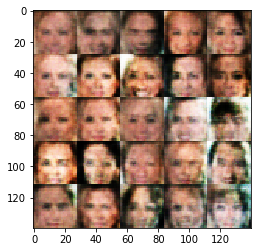

Epoch 1/4... Discriminator Loss: 0.8161... Generator Loss: 1.6942
Epoch 1/4... Discriminator Loss: 0.7648... Generator Loss: 1.6943
Epoch 1/4... Discriminator Loss: 0.6372... Generator Loss: 1.7081
Epoch 1/4... Discriminator Loss: 0.9266... Generator Loss: 1.0513
Epoch 1/4... Discriminator Loss: 0.7924... Generator Loss: 2.0322
Epoch 1/4... Discriminator Loss: 1.1254... Generator Loss: 2.7256
Epoch 1/4... Discriminator Loss: 0.8661... Generator Loss: 1.7368
Epoch 1/4... Discriminator Loss: 0.8879... Generator Loss: 1.0951
Epoch 1/4... Discriminator Loss: 1.0729... Generator Loss: 0.8779
Epoch 1/4... Discriminator Loss: 0.8120... Generator Loss: 1.9565


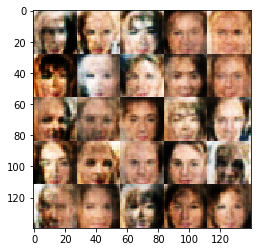

Epoch 1/4... Discriminator Loss: 0.8187... Generator Loss: 1.2910
Epoch 1/4... Discriminator Loss: 0.7099... Generator Loss: 1.8326
Epoch 1/4... Discriminator Loss: 0.8449... Generator Loss: 2.1334
Epoch 1/4... Discriminator Loss: 0.7019... Generator Loss: 1.6730
Epoch 1/4... Discriminator Loss: 0.7714... Generator Loss: 2.3247
Epoch 1/4... Discriminator Loss: 0.7211... Generator Loss: 1.8521
Epoch 1/4... Discriminator Loss: 0.9847... Generator Loss: 1.0925
Epoch 1/4... Discriminator Loss: 0.7645... Generator Loss: 2.0792
Epoch 1/4... Discriminator Loss: 0.8532... Generator Loss: 1.4493
Epoch 1/4... Discriminator Loss: 0.9431... Generator Loss: 1.3055


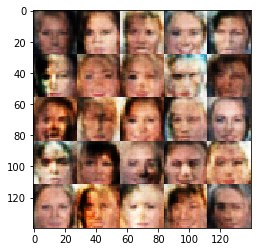

Epoch 1/4... Discriminator Loss: 0.8265... Generator Loss: 1.1529
Epoch 1/4... Discriminator Loss: 0.6878... Generator Loss: 1.5602
Epoch 1/4... Discriminator Loss: 0.8816... Generator Loss: 1.9600
Epoch 1/4... Discriminator Loss: 0.8306... Generator Loss: 1.6683
Epoch 1/4... Discriminator Loss: 0.7158... Generator Loss: 1.6830
Epoch 1/4... Discriminator Loss: 0.8708... Generator Loss: 1.1582
Epoch 1/4... Discriminator Loss: 0.9932... Generator Loss: 2.2346
Epoch 1/4... Discriminator Loss: 0.8636... Generator Loss: 1.1249
Epoch 1/4... Discriminator Loss: 1.3841... Generator Loss: 0.5614
Epoch 1/4... Discriminator Loss: 0.7826... Generator Loss: 1.4320


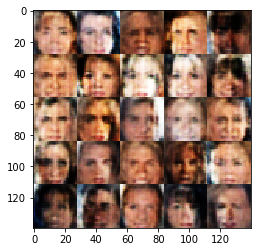

Epoch 1/4... Discriminator Loss: 0.8740... Generator Loss: 1.2388
Epoch 1/4... Discriminator Loss: 1.1401... Generator Loss: 0.8215
Epoch 1/4... Discriminator Loss: 0.9261... Generator Loss: 1.0942
Epoch 1/4... Discriminator Loss: 0.9309... Generator Loss: 1.0718
Epoch 1/4... Discriminator Loss: 0.8279... Generator Loss: 1.4819
Epoch 1/4... Discriminator Loss: 0.9430... Generator Loss: 1.0483
Epoch 1/4... Discriminator Loss: 0.8857... Generator Loss: 1.9150
Epoch 1/4... Discriminator Loss: 0.8209... Generator Loss: 2.2091
Epoch 1/4... Discriminator Loss: 1.7043... Generator Loss: 0.3547
Epoch 1/4... Discriminator Loss: 0.7452... Generator Loss: 1.9557


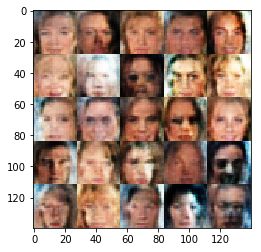

Epoch 1/4... Discriminator Loss: 0.7270... Generator Loss: 1.5081
Epoch 1/4... Discriminator Loss: 0.7591... Generator Loss: 1.5867
Epoch 1/4... Discriminator Loss: 0.8871... Generator Loss: 1.1428
Epoch 1/4... Discriminator Loss: 0.9163... Generator Loss: 1.6637
Epoch 1/4... Discriminator Loss: 1.2459... Generator Loss: 0.6144
Epoch 1/4... Discriminator Loss: 1.2103... Generator Loss: 0.6558
Epoch 1/4... Discriminator Loss: 1.7553... Generator Loss: 0.3710
Epoch 1/4... Discriminator Loss: 0.9303... Generator Loss: 1.1674
Epoch 1/4... Discriminator Loss: 1.2230... Generator Loss: 0.6280
Epoch 1/4... Discriminator Loss: 0.7431... Generator Loss: 1.6022


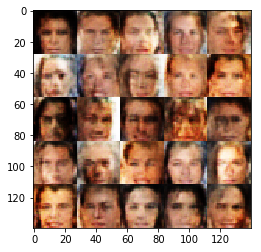

Epoch 1/4... Discriminator Loss: 1.4137... Generator Loss: 0.5181
Epoch 1/4... Discriminator Loss: 0.9139... Generator Loss: 1.2661
Epoch 1/4... Discriminator Loss: 0.9528... Generator Loss: 0.9483
Epoch 1/4... Discriminator Loss: 1.0626... Generator Loss: 2.3784
Epoch 1/4... Discriminator Loss: 0.8309... Generator Loss: 1.2014
Epoch 1/4... Discriminator Loss: 1.0786... Generator Loss: 2.2174
Epoch 1/4... Discriminator Loss: 0.9195... Generator Loss: 1.3596
Epoch 1/4... Discriminator Loss: 0.8108... Generator Loss: 1.2540
Epoch 1/4... Discriminator Loss: 0.7867... Generator Loss: 1.7499
Epoch 1/4... Discriminator Loss: 0.8034... Generator Loss: 1.2272


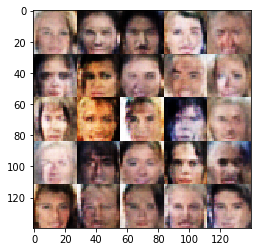

Epoch 1/4... Discriminator Loss: 0.6980... Generator Loss: 1.5290
Epoch 1/4... Discriminator Loss: 0.7506... Generator Loss: 2.0837
Epoch 1/4... Discriminator Loss: 0.8032... Generator Loss: 2.0127
Epoch 1/4... Discriminator Loss: 0.7701... Generator Loss: 1.7475
Epoch 1/4... Discriminator Loss: 1.0842... Generator Loss: 0.8434
Epoch 1/4... Discriminator Loss: 0.9004... Generator Loss: 1.4312
Epoch 1/4... Discriminator Loss: 1.1291... Generator Loss: 0.7174
Epoch 1/4... Discriminator Loss: 0.9483... Generator Loss: 1.0782
Epoch 1/4... Discriminator Loss: 0.7060... Generator Loss: 1.4736
Epoch 1/4... Discriminator Loss: 1.1065... Generator Loss: 0.8136


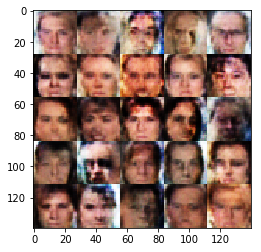

Epoch 1/4... Discriminator Loss: 1.0855... Generator Loss: 0.7278
Epoch 1/4... Discriminator Loss: 0.7537... Generator Loss: 1.7917
Epoch 1/4... Discriminator Loss: 1.0384... Generator Loss: 0.8176
Epoch 1/4... Discriminator Loss: 0.8371... Generator Loss: 1.2158
Epoch 1/4... Discriminator Loss: 1.0016... Generator Loss: 0.9843
Epoch 1/4... Discriminator Loss: 0.7413... Generator Loss: 1.4769
Epoch 1/4... Discriminator Loss: 1.0916... Generator Loss: 0.7472
Epoch 1/4... Discriminator Loss: 1.1246... Generator Loss: 0.7008
Epoch 1/4... Discriminator Loss: 1.0359... Generator Loss: 0.8373
Epoch 1/4... Discriminator Loss: 0.9577... Generator Loss: 2.1049


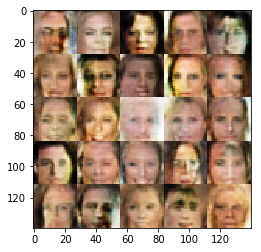

Epoch 1/4... Discriminator Loss: 0.8504... Generator Loss: 1.7156
Epoch 1/4... Discriminator Loss: 0.6701... Generator Loss: 1.9119
Epoch 1/4... Discriminator Loss: 0.7430... Generator Loss: 1.4822
Epoch 1/4... Discriminator Loss: 0.6344... Generator Loss: 2.0811
Epoch 1/4... Discriminator Loss: 0.8357... Generator Loss: 1.2353
Epoch 1/4... Discriminator Loss: 1.4024... Generator Loss: 0.5516
Epoch 1/4... Discriminator Loss: 1.0080... Generator Loss: 0.8488
Epoch 1/4... Discriminator Loss: 0.8359... Generator Loss: 2.1326
Epoch 1/4... Discriminator Loss: 0.9489... Generator Loss: 1.1792
Epoch 1/4... Discriminator Loss: 0.6717... Generator Loss: 2.1120


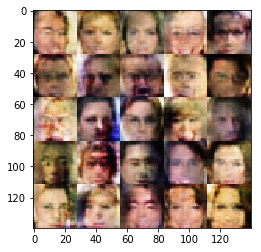

Epoch 1/4... Discriminator Loss: 0.9434... Generator Loss: 1.0854
Epoch 1/4... Discriminator Loss: 1.5539... Generator Loss: 0.4981
Epoch 1/4... Discriminator Loss: 0.9341... Generator Loss: 0.9874
Epoch 1/4... Discriminator Loss: 1.0736... Generator Loss: 0.8655
Epoch 1/4... Discriminator Loss: 0.8620... Generator Loss: 2.4385
Epoch 1/4... Discriminator Loss: 0.6399... Generator Loss: 2.7439
Epoch 1/4... Discriminator Loss: 1.0311... Generator Loss: 1.7928
Epoch 1/4... Discriminator Loss: 0.7807... Generator Loss: 1.5368
Epoch 1/4... Discriminator Loss: 1.1902... Generator Loss: 0.6621
Epoch 1/4... Discriminator Loss: 0.9473... Generator Loss: 0.9140


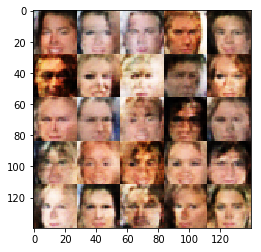

Epoch 1/4... Discriminator Loss: 0.8126... Generator Loss: 2.0451
Epoch 1/4... Discriminator Loss: 1.4807... Generator Loss: 0.5031
Epoch 1/4... Discriminator Loss: 1.1428... Generator Loss: 0.8069
Epoch 1/4... Discriminator Loss: 1.0732... Generator Loss: 1.1316
Epoch 1/4... Discriminator Loss: 0.9055... Generator Loss: 1.5117
Epoch 1/4... Discriminator Loss: 0.8113... Generator Loss: 1.1630
Epoch 1/4... Discriminator Loss: 0.7109... Generator Loss: 1.5092
Epoch 1/4... Discriminator Loss: 1.2384... Generator Loss: 0.6475
Epoch 1/4... Discriminator Loss: 0.9759... Generator Loss: 0.9200
Epoch 1/4... Discriminator Loss: 1.4025... Generator Loss: 0.6483


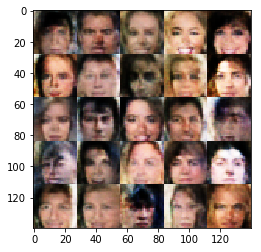

Epoch 1/4... Discriminator Loss: 0.8044... Generator Loss: 1.3546
Epoch 1/4... Discriminator Loss: 1.0741... Generator Loss: 0.8488
Epoch 1/4... Discriminator Loss: 0.7354... Generator Loss: 1.5772
Epoch 1/4... Discriminator Loss: 1.0851... Generator Loss: 2.1503
Epoch 1/4... Discriminator Loss: 0.7902... Generator Loss: 1.6296
Epoch 1/4... Discriminator Loss: 1.1745... Generator Loss: 0.6550
Epoch 1/4... Discriminator Loss: 0.8991... Generator Loss: 0.9981
Epoch 1/4... Discriminator Loss: 0.9243... Generator Loss: 0.9586
Epoch 1/4... Discriminator Loss: 0.7737... Generator Loss: 1.2466
Epoch 1/4... Discriminator Loss: 0.8469... Generator Loss: 1.5675


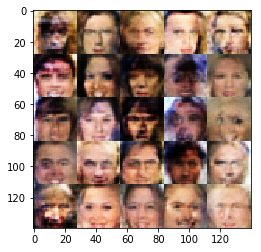

Epoch 1/4... Discriminator Loss: 1.0541... Generator Loss: 0.8708
Epoch 1/4... Discriminator Loss: 0.7616... Generator Loss: 1.3382
Epoch 1/4... Discriminator Loss: 1.2406... Generator Loss: 3.7650
Epoch 1/4... Discriminator Loss: 0.8777... Generator Loss: 2.7191
Epoch 1/4... Discriminator Loss: 0.8980... Generator Loss: 1.0568
Epoch 1/4... Discriminator Loss: 0.6012... Generator Loss: 2.7033
Epoch 1/4... Discriminator Loss: 1.2332... Generator Loss: 0.6215
Epoch 1/4... Discriminator Loss: 0.7363... Generator Loss: 1.6675
Epoch 1/4... Discriminator Loss: 0.8770... Generator Loss: 1.2084
Epoch 1/4... Discriminator Loss: 0.7774... Generator Loss: 2.1978


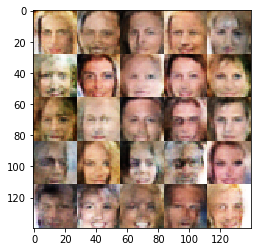

Epoch 1/4... Discriminator Loss: 0.7710... Generator Loss: 1.4641
Epoch 1/4... Discriminator Loss: 1.0149... Generator Loss: 0.9187
Epoch 1/4... Discriminator Loss: 1.0637... Generator Loss: 0.9572
Epoch 1/4... Discriminator Loss: 1.0281... Generator Loss: 2.1813
Epoch 1/4... Discriminator Loss: 0.8943... Generator Loss: 1.1268
Epoch 1/4... Discriminator Loss: 1.1026... Generator Loss: 0.7302
Epoch 1/4... Discriminator Loss: 0.8876... Generator Loss: 2.0071
Epoch 1/4... Discriminator Loss: 1.0054... Generator Loss: 0.8790
Epoch 1/4... Discriminator Loss: 0.6835... Generator Loss: 1.7813
Epoch 1/4... Discriminator Loss: 0.8060... Generator Loss: 1.2245


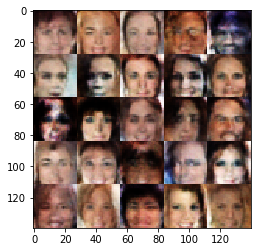

Epoch 1/4... Discriminator Loss: 0.7644... Generator Loss: 2.2016
Epoch 1/4... Discriminator Loss: 0.7310... Generator Loss: 1.5575
Epoch 1/4... Discriminator Loss: 0.8552... Generator Loss: 1.2187
Epoch 1/4... Discriminator Loss: 0.9121... Generator Loss: 1.0494
Epoch 1/4... Discriminator Loss: 0.6203... Generator Loss: 1.7886
Epoch 1/4... Discriminator Loss: 1.0620... Generator Loss: 0.7233
Epoch 1/4... Discriminator Loss: 1.0165... Generator Loss: 0.8886
Epoch 1/4... Discriminator Loss: 1.0620... Generator Loss: 1.2822
Epoch 1/4... Discriminator Loss: 0.8772... Generator Loss: 1.4325
Epoch 1/4... Discriminator Loss: 1.0352... Generator Loss: 1.3427


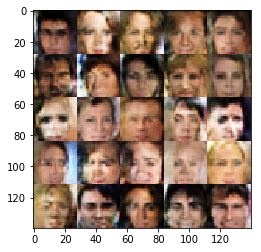

Epoch 1/4... Discriminator Loss: 1.0461... Generator Loss: 0.8033
Epoch 1/4... Discriminator Loss: 1.1824... Generator Loss: 0.7279
Epoch 1/4... Discriminator Loss: 1.0760... Generator Loss: 0.8522
Epoch 1/4... Discriminator Loss: 0.8093... Generator Loss: 1.7663
Epoch 1/4... Discriminator Loss: 0.9072... Generator Loss: 1.3675
Epoch 1/4... Discriminator Loss: 0.7692... Generator Loss: 2.6475
Epoch 1/4... Discriminator Loss: 0.7514... Generator Loss: 1.3041
Epoch 1/4... Discriminator Loss: 0.7174... Generator Loss: 1.4573
Epoch 1/4... Discriminator Loss: 0.8826... Generator Loss: 1.1923
Epoch 1/4... Discriminator Loss: 0.7849... Generator Loss: 2.0441


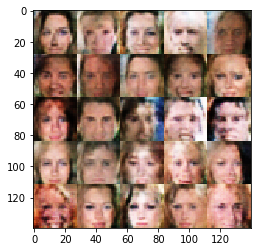

Epoch 1/4... Discriminator Loss: 0.7620... Generator Loss: 1.6300
Epoch 1/4... Discriminator Loss: 0.8410... Generator Loss: 1.7035
Epoch 1/4... Discriminator Loss: 0.8319... Generator Loss: 1.7143
Epoch 1/4... Discriminator Loss: 0.8238... Generator Loss: 1.2457
Epoch 1/4... Discriminator Loss: 0.8372... Generator Loss: 2.3304
Epoch 1/4... Discriminator Loss: 0.8071... Generator Loss: 1.8691
Epoch 1/4... Discriminator Loss: 1.2320... Generator Loss: 0.6526
Epoch 1/4... Discriminator Loss: 1.1067... Generator Loss: 0.7329
Epoch 1/4... Discriminator Loss: 0.8559... Generator Loss: 1.2205
Epoch 1/4... Discriminator Loss: 0.8328... Generator Loss: 1.1992


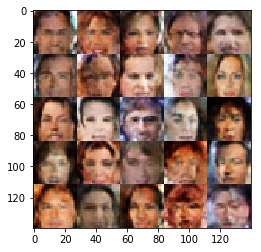

Epoch 1/4... Discriminator Loss: 1.1921... Generator Loss: 0.7164
Epoch 1/4... Discriminator Loss: 0.7664... Generator Loss: 1.3162
Epoch 1/4... Discriminator Loss: 0.7541... Generator Loss: 1.6324
Epoch 1/4... Discriminator Loss: 1.0057... Generator Loss: 2.7025
Epoch 1/4... Discriminator Loss: 0.8603... Generator Loss: 1.7098
Epoch 1/4... Discriminator Loss: 1.0852... Generator Loss: 0.8526
Epoch 1/4... Discriminator Loss: 0.9407... Generator Loss: 0.8988
Epoch 1/4... Discriminator Loss: 0.6333... Generator Loss: 1.7014
Epoch 1/4... Discriminator Loss: 0.9348... Generator Loss: 1.5887
Epoch 1/4... Discriminator Loss: 0.7371... Generator Loss: 1.5058


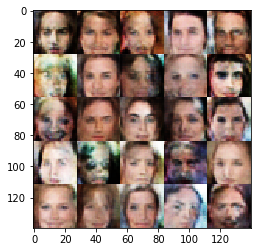

Epoch 1/4... Discriminator Loss: 0.7496... Generator Loss: 1.6017
Epoch 1/4... Discriminator Loss: 0.9324... Generator Loss: 1.5688
Epoch 1/4... Discriminator Loss: 1.0293... Generator Loss: 0.8125
Epoch 1/4... Discriminator Loss: 0.8573... Generator Loss: 1.0905
Epoch 1/4... Discriminator Loss: 0.7054... Generator Loss: 1.3352
Epoch 1/4... Discriminator Loss: 0.9565... Generator Loss: 0.8462
Epoch 1/4... Discriminator Loss: 0.6929... Generator Loss: 1.6373
Epoch 1/4... Discriminator Loss: 0.7747... Generator Loss: 1.2121
Epoch 1/4... Discriminator Loss: 1.1424... Generator Loss: 0.7865
Epoch 1/4... Discriminator Loss: 0.8074... Generator Loss: 1.3178


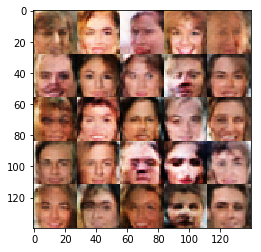

Epoch 1/4... Discriminator Loss: 0.7140... Generator Loss: 1.8998
Epoch 1/4... Discriminator Loss: 0.9282... Generator Loss: 0.9677
Epoch 1/4... Discriminator Loss: 0.7636... Generator Loss: 2.2545
Epoch 1/4... Discriminator Loss: 0.7269... Generator Loss: 1.4794
Epoch 1/4... Discriminator Loss: 0.6542... Generator Loss: 1.7937
Epoch 1/4... Discriminator Loss: 0.8646... Generator Loss: 1.1168
Epoch 1/4... Discriminator Loss: 0.7244... Generator Loss: 1.5193
Epoch 1/4... Discriminator Loss: 1.0618... Generator Loss: 0.7848
Epoch 1/4... Discriminator Loss: 1.2338... Generator Loss: 0.5905
Epoch 1/4... Discriminator Loss: 1.2325... Generator Loss: 0.7665


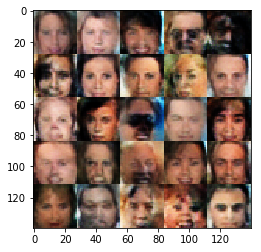

Epoch 1/4... Discriminator Loss: 0.7121... Generator Loss: 2.4070
Epoch 1/4... Discriminator Loss: 0.8536... Generator Loss: 1.5642
Epoch 1/4... Discriminator Loss: 0.7302... Generator Loss: 1.5240
Epoch 1/4... Discriminator Loss: 0.8347... Generator Loss: 1.3028
Epoch 1/4... Discriminator Loss: 0.7000... Generator Loss: 2.4412
Epoch 1/4... Discriminator Loss: 0.8966... Generator Loss: 2.2765
Epoch 1/4... Discriminator Loss: 0.8706... Generator Loss: 1.1940
Epoch 1/4... Discriminator Loss: 0.9869... Generator Loss: 0.9229
Epoch 1/4... Discriminator Loss: 1.1341... Generator Loss: 0.7257
Epoch 1/4... Discriminator Loss: 0.8347... Generator Loss: 1.6175


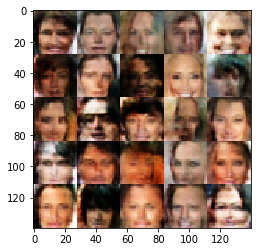

Epoch 1/4... Discriminator Loss: 0.8088... Generator Loss: 1.4460
Epoch 1/4... Discriminator Loss: 1.1262... Generator Loss: 0.7558
Epoch 1/4... Discriminator Loss: 1.2739... Generator Loss: 0.6066
Epoch 1/4... Discriminator Loss: 1.0440... Generator Loss: 0.8194
Epoch 1/4... Discriminator Loss: 1.4191... Generator Loss: 0.5063
Epoch 1/4... Discriminator Loss: 0.9681... Generator Loss: 1.0402
Epoch 1/4... Discriminator Loss: 0.7113... Generator Loss: 1.8303
Epoch 1/4... Discriminator Loss: 1.2144... Generator Loss: 0.6909
Epoch 1/4... Discriminator Loss: 0.9378... Generator Loss: 0.9405
Epoch 1/4... Discriminator Loss: 0.6577... Generator Loss: 1.5462


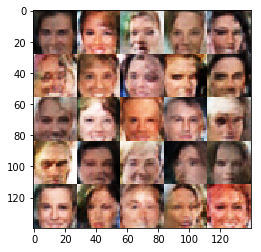

Epoch 1/4... Discriminator Loss: 0.7197... Generator Loss: 1.6047
Epoch 1/4... Discriminator Loss: 0.7526... Generator Loss: 1.8674
Epoch 1/4... Discriminator Loss: 0.8793... Generator Loss: 1.2242
Epoch 1/4... Discriminator Loss: 1.0215... Generator Loss: 0.8886
Epoch 1/4... Discriminator Loss: 1.0038... Generator Loss: 0.9984
Epoch 1/4... Discriminator Loss: 1.0334... Generator Loss: 0.9212
Epoch 1/4... Discriminator Loss: 1.0568... Generator Loss: 0.8148
Epoch 1/4... Discriminator Loss: 0.7961... Generator Loss: 1.7422
Epoch 1/4... Discriminator Loss: 0.8774... Generator Loss: 1.5974
Epoch 1/4... Discriminator Loss: 0.7278... Generator Loss: 1.5452


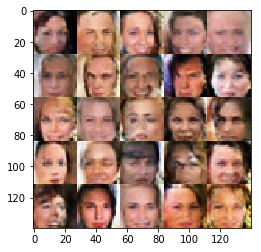

Epoch 1/4... Discriminator Loss: 0.6787... Generator Loss: 2.2548
Epoch 1/4... Discriminator Loss: 1.0898... Generator Loss: 0.8556
Epoch 1/4... Discriminator Loss: 0.9725... Generator Loss: 0.9461
Epoch 1/4... Discriminator Loss: 0.9344... Generator Loss: 1.3598
Epoch 1/4... Discriminator Loss: 0.9196... Generator Loss: 1.1977
Epoch 1/4... Discriminator Loss: 0.7572... Generator Loss: 1.3591
Epoch 1/4... Discriminator Loss: 1.0323... Generator Loss: 0.8729
Epoch 1/4... Discriminator Loss: 1.4963... Generator Loss: 4.4082
Epoch 1/4... Discriminator Loss: 0.7654... Generator Loss: 1.7146
Epoch 1/4... Discriminator Loss: 0.8942... Generator Loss: 1.2304


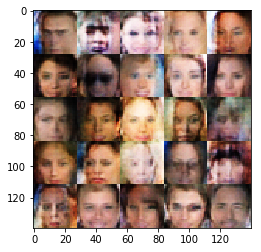

Epoch 1/4... Discriminator Loss: 1.0313... Generator Loss: 0.8738
Epoch 1/4... Discriminator Loss: 0.8909... Generator Loss: 2.1294
Epoch 1/4... Discriminator Loss: 0.7433... Generator Loss: 1.5107
Epoch 1/4... Discriminator Loss: 1.0679... Generator Loss: 0.8095
Epoch 1/4... Discriminator Loss: 0.7276... Generator Loss: 1.5494
Epoch 1/4... Discriminator Loss: 1.0266... Generator Loss: 0.9440
Epoch 1/4... Discriminator Loss: 0.9684... Generator Loss: 1.0510
Epoch 1/4... Discriminator Loss: 0.8302... Generator Loss: 1.3758
Epoch 1/4... Discriminator Loss: 1.0965... Generator Loss: 3.0214
Epoch 1/4... Discriminator Loss: 1.2391... Generator Loss: 0.7261


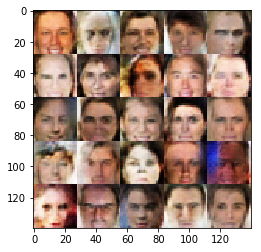

Epoch 1/4... Discriminator Loss: 1.1156... Generator Loss: 0.7086
Epoch 1/4... Discriminator Loss: 0.8360... Generator Loss: 1.1766
Epoch 1/4... Discriminator Loss: 0.7214... Generator Loss: 1.3224
Epoch 1/4... Discriminator Loss: 0.9903... Generator Loss: 0.9375
Epoch 1/4... Discriminator Loss: 0.9170... Generator Loss: 0.9965
Epoch 1/4... Discriminator Loss: 0.9081... Generator Loss: 0.9993
Epoch 1/4... Discriminator Loss: 0.6746... Generator Loss: 1.6142
Epoch 1/4... Discriminator Loss: 0.9758... Generator Loss: 1.0409
Epoch 1/4... Discriminator Loss: 0.7704... Generator Loss: 1.4410
Epoch 1/4... Discriminator Loss: 0.7021... Generator Loss: 1.5577


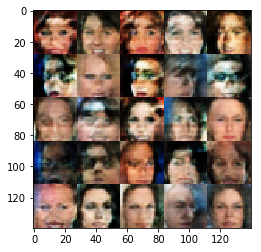

Epoch 1/4... Discriminator Loss: 1.1403... Generator Loss: 0.6957
Epoch 1/4... Discriminator Loss: 1.1226... Generator Loss: 0.7998
Epoch 1/4... Discriminator Loss: 0.9135... Generator Loss: 0.9958
Epoch 1/4... Discriminator Loss: 0.8510... Generator Loss: 1.6502
Epoch 1/4... Discriminator Loss: 0.6355... Generator Loss: 1.7157
Epoch 1/4... Discriminator Loss: 1.1405... Generator Loss: 0.7151
Epoch 1/4... Discriminator Loss: 1.3982... Generator Loss: 0.6311
Epoch 1/4... Discriminator Loss: 0.8802... Generator Loss: 2.3690
Epoch 1/4... Discriminator Loss: 1.1999... Generator Loss: 0.6680
Epoch 1/4... Discriminator Loss: 0.7907... Generator Loss: 1.2580


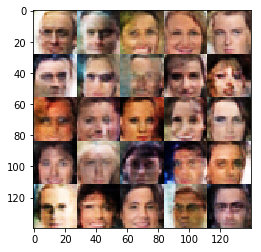

Epoch 1/4... Discriminator Loss: 0.8163... Generator Loss: 1.3928
Epoch 1/4... Discriminator Loss: 0.8774... Generator Loss: 1.8940
Epoch 1/4... Discriminator Loss: 1.6864... Generator Loss: 0.3481
Epoch 1/4... Discriminator Loss: 0.7911... Generator Loss: 1.3064
Epoch 1/4... Discriminator Loss: 1.0368... Generator Loss: 0.8491
Epoch 1/4... Discriminator Loss: 0.6691... Generator Loss: 1.4896
Epoch 1/4... Discriminator Loss: 1.1017... Generator Loss: 0.7104
Epoch 1/4... Discriminator Loss: 0.7455... Generator Loss: 1.4325
Epoch 1/4... Discriminator Loss: 0.9544... Generator Loss: 1.8878
Epoch 1/4... Discriminator Loss: 1.0000... Generator Loss: 0.9304


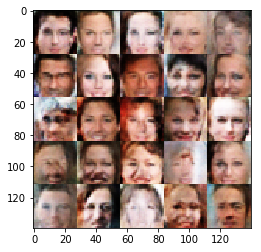

Epoch 1/4... Discriminator Loss: 0.6130... Generator Loss: 2.5882
Epoch 1/4... Discriminator Loss: 0.7294... Generator Loss: 1.5359
Epoch 1/4... Discriminator Loss: 0.7828... Generator Loss: 1.5901
Epoch 1/4... Discriminator Loss: 0.8093... Generator Loss: 1.2629
Epoch 1/4... Discriminator Loss: 0.9122... Generator Loss: 1.0436
Epoch 1/4... Discriminator Loss: 1.2366... Generator Loss: 0.6308
Epoch 1/4... Discriminator Loss: 1.2897... Generator Loss: 0.5936
Epoch 1/4... Discriminator Loss: 1.2474... Generator Loss: 0.6415
Epoch 1/4... Discriminator Loss: 1.0198... Generator Loss: 0.8761
Epoch 1/4... Discriminator Loss: 0.9118... Generator Loss: 1.0019


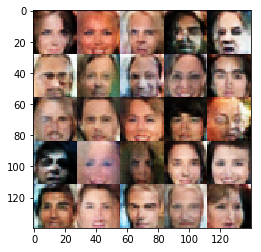

Epoch 1/4... Discriminator Loss: 0.8689... Generator Loss: 1.1940
Epoch 1/4... Discriminator Loss: 0.9175... Generator Loss: 1.0242
Epoch 1/4... Discriminator Loss: 0.7715... Generator Loss: 1.2181
Epoch 1/4... Discriminator Loss: 1.0804... Generator Loss: 0.8160
Epoch 1/4... Discriminator Loss: 1.0506... Generator Loss: 0.8387
Epoch 1/4... Discriminator Loss: 0.8008... Generator Loss: 1.5869
Epoch 1/4... Discriminator Loss: 0.6915... Generator Loss: 1.6654
Epoch 1/4... Discriminator Loss: 0.9105... Generator Loss: 1.3777
Epoch 1/4... Discriminator Loss: 0.9770... Generator Loss: 1.1119
Epoch 1/4... Discriminator Loss: 0.8436... Generator Loss: 1.1908


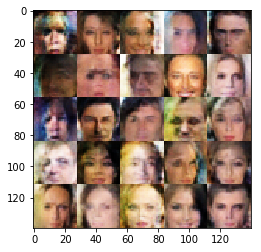

Epoch 1/4... Discriminator Loss: 1.0861... Generator Loss: 0.7513
Epoch 1/4... Discriminator Loss: 0.7857... Generator Loss: 1.3934
Epoch 1/4... Discriminator Loss: 0.7432... Generator Loss: 1.3150
Epoch 1/4... Discriminator Loss: 0.6841... Generator Loss: 1.6452
Epoch 1/4... Discriminator Loss: 1.6039... Generator Loss: 0.4017
Epoch 1/4... Discriminator Loss: 0.9589... Generator Loss: 1.1048
Epoch 1/4... Discriminator Loss: 1.0520... Generator Loss: 0.7797
Epoch 1/4... Discriminator Loss: 0.9933... Generator Loss: 0.8549
Epoch 1/4... Discriminator Loss: 1.2053... Generator Loss: 0.6841
Epoch 1/4... Discriminator Loss: 0.7628... Generator Loss: 1.7217


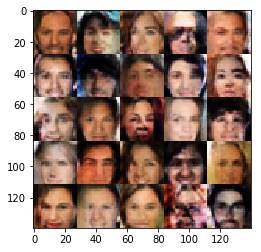

Epoch 1/4... Discriminator Loss: 0.6473... Generator Loss: 1.7246
Epoch 1/4... Discriminator Loss: 0.7060... Generator Loss: 1.4534
Epoch 1/4... Discriminator Loss: 0.8192... Generator Loss: 1.7251
Epoch 1/4... Discriminator Loss: 1.5400... Generator Loss: 3.2641
Epoch 1/4... Discriminator Loss: 1.0174... Generator Loss: 0.9922
Epoch 1/4... Discriminator Loss: 1.4390... Generator Loss: 0.5218
Epoch 1/4... Discriminator Loss: 0.8415... Generator Loss: 1.1649
Epoch 1/4... Discriminator Loss: 1.0239... Generator Loss: 0.8301
Epoch 1/4... Discriminator Loss: 1.0900... Generator Loss: 0.7710
Epoch 1/4... Discriminator Loss: 1.0523... Generator Loss: 0.8288


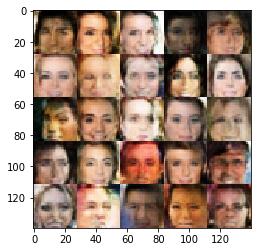

Epoch 1/4... Discriminator Loss: 1.0512... Generator Loss: 1.8852
Epoch 1/4... Discriminator Loss: 1.2145... Generator Loss: 0.7743
Epoch 1/4... Discriminator Loss: 1.3230... Generator Loss: 0.6055
Epoch 1/4... Discriminator Loss: 0.8832... Generator Loss: 1.0370
Epoch 1/4... Discriminator Loss: 0.8889... Generator Loss: 1.0162
Epoch 1/4... Discriminator Loss: 0.9620... Generator Loss: 0.9570
Epoch 1/4... Discriminator Loss: 1.0270... Generator Loss: 1.6127
Epoch 1/4... Discriminator Loss: 0.8225... Generator Loss: 1.3359
Epoch 1/4... Discriminator Loss: 1.0355... Generator Loss: 0.8446
Epoch 1/4... Discriminator Loss: 1.4573... Generator Loss: 0.4598


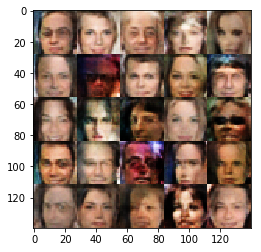

Epoch 1/4... Discriminator Loss: 0.8440... Generator Loss: 1.1571
Epoch 1/4... Discriminator Loss: 0.8242... Generator Loss: 1.3917
Epoch 1/4... Discriminator Loss: 0.9385... Generator Loss: 1.3723
Epoch 1/4... Discriminator Loss: 0.9013... Generator Loss: 2.1150
Epoch 1/4... Discriminator Loss: 0.7774... Generator Loss: 1.3756
Epoch 1/4... Discriminator Loss: 0.9056... Generator Loss: 1.1848
Epoch 1/4... Discriminator Loss: 0.9040... Generator Loss: 1.8444
Epoch 1/4... Discriminator Loss: 0.7575... Generator Loss: 1.3997
Epoch 1/4... Discriminator Loss: 0.9338... Generator Loss: 1.0215
Epoch 1/4... Discriminator Loss: 0.9663... Generator Loss: 0.9227


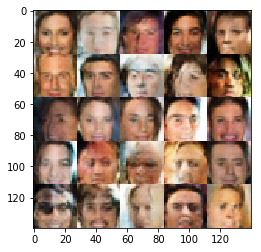

Epoch 1/4... Discriminator Loss: 1.0747... Generator Loss: 0.7650
Epoch 1/4... Discriminator Loss: 0.8896... Generator Loss: 1.0846
Epoch 1/4... Discriminator Loss: 0.9122... Generator Loss: 1.6519
Epoch 1/4... Discriminator Loss: 0.8628... Generator Loss: 1.2209
Epoch 1/4... Discriminator Loss: 0.8787... Generator Loss: 1.4529
Epoch 1/4... Discriminator Loss: 0.9033... Generator Loss: 0.9813
Epoch 1/4... Discriminator Loss: 0.8644... Generator Loss: 1.6274
Epoch 1/4... Discriminator Loss: 0.7996... Generator Loss: 2.0183
Epoch 1/4... Discriminator Loss: 0.8872... Generator Loss: 1.3743
Epoch 1/4... Discriminator Loss: 0.9370... Generator Loss: 0.9457


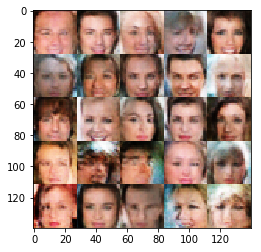

Epoch 1/4... Discriminator Loss: 0.7173... Generator Loss: 1.9777
Epoch 1/4... Discriminator Loss: 0.9737... Generator Loss: 0.9645
Epoch 1/4... Discriminator Loss: 1.1191... Generator Loss: 0.8042
Epoch 1/4... Discriminator Loss: 1.0266... Generator Loss: 0.9272
Epoch 1/4... Discriminator Loss: 0.8486... Generator Loss: 1.0929
Epoch 1/4... Discriminator Loss: 0.6537... Generator Loss: 1.8102
Epoch 1/4... Discriminator Loss: 0.9291... Generator Loss: 0.9678
Epoch 1/4... Discriminator Loss: 0.8283... Generator Loss: 1.2051
Epoch 1/4... Discriminator Loss: 1.0484... Generator Loss: 0.8166
Epoch 1/4... Discriminator Loss: 0.7560... Generator Loss: 1.9055


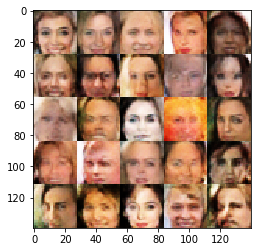

Epoch 1/4... Discriminator Loss: 0.7219... Generator Loss: 1.5028
Epoch 1/4... Discriminator Loss: 0.8841... Generator Loss: 1.2063
Epoch 1/4... Discriminator Loss: 0.8034... Generator Loss: 1.7663
Epoch 1/4... Discriminator Loss: 0.8570... Generator Loss: 1.4529
Epoch 1/4... Discriminator Loss: 1.1197... Generator Loss: 0.8474
Epoch 1/4... Discriminator Loss: 0.9138... Generator Loss: 0.9492
Epoch 1/4... Discriminator Loss: 0.9250... Generator Loss: 1.0246
Epoch 1/4... Discriminator Loss: 1.2079... Generator Loss: 0.7043
Epoch 1/4... Discriminator Loss: 0.8718... Generator Loss: 1.4459
Epoch 1/4... Discriminator Loss: 0.8161... Generator Loss: 1.2017


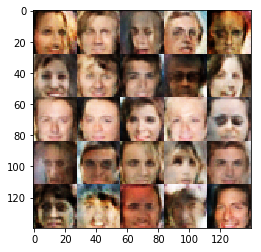

Epoch 1/4... Discriminator Loss: 1.0251... Generator Loss: 0.8670
Epoch 1/4... Discriminator Loss: 0.6740... Generator Loss: 1.8604
Epoch 1/4... Discriminator Loss: 1.6714... Generator Loss: 0.3550
Epoch 1/4... Discriminator Loss: 0.8566... Generator Loss: 1.1567
Epoch 1/4... Discriminator Loss: 0.7817... Generator Loss: 1.9814
Epoch 1/4... Discriminator Loss: 1.0272... Generator Loss: 0.8497
Epoch 1/4... Discriminator Loss: 0.7808... Generator Loss: 1.3854
Epoch 1/4... Discriminator Loss: 0.8915... Generator Loss: 1.0916
Epoch 1/4... Discriminator Loss: 0.8011... Generator Loss: 1.4040
Epoch 1/4... Discriminator Loss: 1.0931... Generator Loss: 0.7272


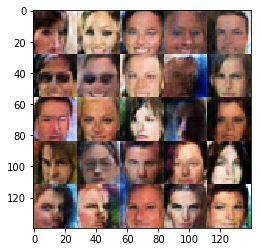

Epoch 1/4... Discriminator Loss: 0.8457... Generator Loss: 1.1910
Epoch 1/4... Discriminator Loss: 1.1424... Generator Loss: 0.7051
Epoch 1/4... Discriminator Loss: 1.2204... Generator Loss: 0.6444
Epoch 1/4... Discriminator Loss: 1.2237... Generator Loss: 0.6350
Epoch 1/4... Discriminator Loss: 0.7311... Generator Loss: 1.8240
Epoch 1/4... Discriminator Loss: 0.7649... Generator Loss: 1.3013
Epoch 1/4... Discriminator Loss: 1.0291... Generator Loss: 0.7853
Epoch 1/4... Discriminator Loss: 1.0092... Generator Loss: 1.1110
Epoch 1/4... Discriminator Loss: 1.2517... Generator Loss: 0.6025
Epoch 1/4... Discriminator Loss: 0.8203... Generator Loss: 1.2334


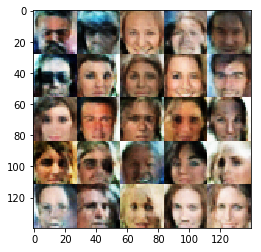

Epoch 1/4... Discriminator Loss: 1.0478... Generator Loss: 0.8058
Epoch 1/4... Discriminator Loss: 1.2776... Generator Loss: 0.5566
Epoch 1/4... Discriminator Loss: 1.1137... Generator Loss: 0.7100
Epoch 1/4... Discriminator Loss: 0.8113... Generator Loss: 1.2780
Epoch 1/4... Discriminator Loss: 1.0295... Generator Loss: 0.8503
Epoch 1/4... Discriminator Loss: 0.8200... Generator Loss: 1.5428
Epoch 1/4... Discriminator Loss: 1.3996... Generator Loss: 0.4917
Epoch 1/4... Discriminator Loss: 0.9720... Generator Loss: 1.9886
Epoch 1/4... Discriminator Loss: 0.9160... Generator Loss: 1.1862
Epoch 1/4... Discriminator Loss: 0.8804... Generator Loss: 2.0354


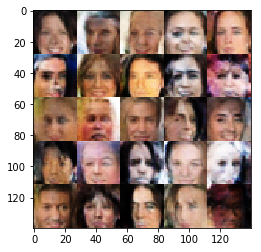

Epoch 1/4... Discriminator Loss: 1.1064... Generator Loss: 0.7404
Epoch 1/4... Discriminator Loss: 0.6913... Generator Loss: 1.7469
Epoch 1/4... Discriminator Loss: 0.8002... Generator Loss: 1.1800
Epoch 1/4... Discriminator Loss: 0.9266... Generator Loss: 1.0199
Epoch 1/4... Discriminator Loss: 0.9095... Generator Loss: 1.4679
Epoch 1/4... Discriminator Loss: 0.8842... Generator Loss: 1.1797
Epoch 1/4... Discriminator Loss: 0.9036... Generator Loss: 1.0118
Epoch 1/4... Discriminator Loss: 1.1482... Generator Loss: 0.7224
Epoch 1/4... Discriminator Loss: 0.9313... Generator Loss: 1.7679
Epoch 1/4... Discriminator Loss: 1.1031... Generator Loss: 0.7527


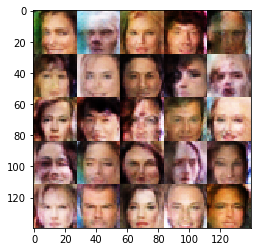

Epoch 1/4... Discriminator Loss: 0.8926... Generator Loss: 1.1465
Epoch 1/4... Discriminator Loss: 0.8790... Generator Loss: 1.3155
Epoch 1/4... Discriminator Loss: 0.8526... Generator Loss: 1.8803
Epoch 1/4... Discriminator Loss: 0.8920... Generator Loss: 1.0932
Epoch 1/4... Discriminator Loss: 0.7981... Generator Loss: 1.3631
Epoch 1/4... Discriminator Loss: 1.2086... Generator Loss: 0.7452
Epoch 1/4... Discriminator Loss: 1.3007... Generator Loss: 0.5928
Epoch 1/4... Discriminator Loss: 0.6645... Generator Loss: 1.5988
Epoch 1/4... Discriminator Loss: 1.0738... Generator Loss: 0.8310
Epoch 1/4... Discriminator Loss: 1.0763... Generator Loss: 0.7800


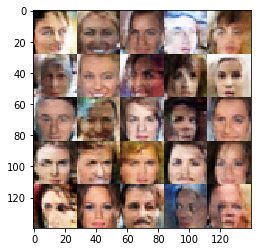

Epoch 1/4... Discriminator Loss: 1.0659... Generator Loss: 0.7799
Epoch 1/4... Discriminator Loss: 0.9384... Generator Loss: 1.2362
Epoch 1/4... Discriminator Loss: 0.9367... Generator Loss: 1.0146
Epoch 1/4... Discriminator Loss: 0.8323... Generator Loss: 1.1568
Epoch 1/4... Discriminator Loss: 0.9835... Generator Loss: 0.9090
Epoch 1/4... Discriminator Loss: 0.9781... Generator Loss: 0.9271
Epoch 1/4... Discriminator Loss: 0.6962... Generator Loss: 1.6017
Epoch 1/4... Discriminator Loss: 0.8319... Generator Loss: 1.1520
Epoch 1/4... Discriminator Loss: 1.0871... Generator Loss: 1.4208
Epoch 1/4... Discriminator Loss: 0.8603... Generator Loss: 1.2170


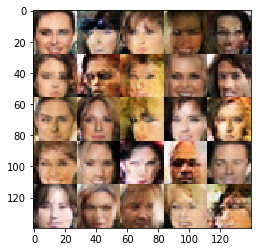

Epoch 1/4... Discriminator Loss: 0.7141... Generator Loss: 1.8680
Epoch 1/4... Discriminator Loss: 0.6096... Generator Loss: 1.8311
Epoch 1/4... Discriminator Loss: 0.7020... Generator Loss: 1.6126
Epoch 1/4... Discriminator Loss: 0.6818... Generator Loss: 1.7321
Epoch 1/4... Discriminator Loss: 0.9080... Generator Loss: 1.8030
Epoch 1/4... Discriminator Loss: 0.8865... Generator Loss: 1.1304
Epoch 1/4... Discriminator Loss: 0.8678... Generator Loss: 1.8358
Epoch 1/4... Discriminator Loss: 0.8014... Generator Loss: 2.1068
Epoch 1/4... Discriminator Loss: 0.9292... Generator Loss: 0.9891
Epoch 1/4... Discriminator Loss: 0.9817... Generator Loss: 0.8445


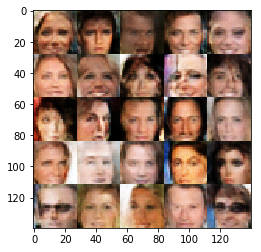

Epoch 1/4... Discriminator Loss: 1.1077... Generator Loss: 0.7831
Epoch 1/4... Discriminator Loss: 0.6871... Generator Loss: 1.9453
Epoch 1/4... Discriminator Loss: 0.8375... Generator Loss: 1.3754
Epoch 1/4... Discriminator Loss: 0.8788... Generator Loss: 1.0240
Epoch 1/4... Discriminator Loss: 0.8574... Generator Loss: 1.0556
Epoch 1/4... Discriminator Loss: 0.8459... Generator Loss: 1.2697
Epoch 1/4... Discriminator Loss: 0.8827... Generator Loss: 1.2443
Epoch 1/4... Discriminator Loss: 0.8077... Generator Loss: 1.2278
Epoch 1/4... Discriminator Loss: 0.5702... Generator Loss: 2.4325
Epoch 1/4... Discriminator Loss: 0.6604... Generator Loss: 1.9325


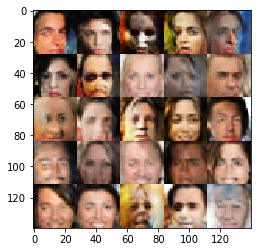

Epoch 1/4... Discriminator Loss: 1.2303... Generator Loss: 0.6947
Epoch 1/4... Discriminator Loss: 1.1237... Generator Loss: 0.7313
Epoch 1/4... Discriminator Loss: 0.7366... Generator Loss: 2.2182
Epoch 1/4... Discriminator Loss: 0.7938... Generator Loss: 1.4492
Epoch 1/4... Discriminator Loss: 0.8653... Generator Loss: 1.0968
Epoch 1/4... Discriminator Loss: 1.2718... Generator Loss: 0.5800
Epoch 1/4... Discriminator Loss: 1.0066... Generator Loss: 0.8969
Epoch 1/4... Discriminator Loss: 0.8134... Generator Loss: 1.7656
Epoch 1/4... Discriminator Loss: 0.7567... Generator Loss: 1.6293
Epoch 1/4... Discriminator Loss: 1.1043... Generator Loss: 0.7408


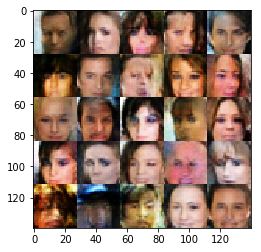

Epoch 1/4... Discriminator Loss: 0.7738... Generator Loss: 1.2623
Epoch 1/4... Discriminator Loss: 0.7825... Generator Loss: 2.0031
Epoch 1/4... Discriminator Loss: 1.4088... Generator Loss: 0.5586
Epoch 1/4... Discriminator Loss: 0.5955... Generator Loss: 2.1222
Epoch 1/4... Discriminator Loss: 0.6185... Generator Loss: 2.1426
Epoch 1/4... Discriminator Loss: 0.8163... Generator Loss: 1.4547
Epoch 1/4... Discriminator Loss: 1.3879... Generator Loss: 0.4899
Epoch 1/4... Discriminator Loss: 0.8695... Generator Loss: 1.1404
Epoch 1/4... Discriminator Loss: 0.6556... Generator Loss: 1.7627
Epoch 1/4... Discriminator Loss: 0.8865... Generator Loss: 1.2900


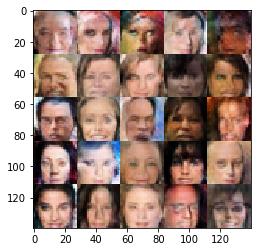

Epoch 1/4... Discriminator Loss: 0.8893... Generator Loss: 1.0738
Epoch 1/4... Discriminator Loss: 1.1049... Generator Loss: 0.7671
Epoch 1/4... Discriminator Loss: 1.3048... Generator Loss: 0.6024
Epoch 1/4... Discriminator Loss: 1.1757... Generator Loss: 1.7572
Epoch 1/4... Discriminator Loss: 0.6918... Generator Loss: 1.5398
Epoch 1/4... Discriminator Loss: 1.1229... Generator Loss: 0.7801
Epoch 1/4... Discriminator Loss: 1.1035... Generator Loss: 0.7241
Epoch 1/4... Discriminator Loss: 1.0381... Generator Loss: 0.8631
Epoch 1/4... Discriminator Loss: 1.3736... Generator Loss: 0.5636
Epoch 1/4... Discriminator Loss: 1.0790... Generator Loss: 0.7276


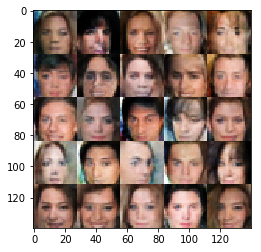

Epoch 1/4... Discriminator Loss: 0.8622... Generator Loss: 1.2274
Epoch 1/4... Discriminator Loss: 0.7950... Generator Loss: 1.3510
Epoch 1/4... Discriminator Loss: 0.8295... Generator Loss: 1.1504
Epoch 1/4... Discriminator Loss: 1.0112... Generator Loss: 0.8898
Epoch 1/4... Discriminator Loss: 0.8943... Generator Loss: 1.2756
Epoch 1/4... Discriminator Loss: 0.9190... Generator Loss: 1.2002
Epoch 1/4... Discriminator Loss: 0.9140... Generator Loss: 1.0699
Epoch 1/4... Discriminator Loss: 0.7541... Generator Loss: 1.3898
Epoch 1/4... Discriminator Loss: 1.1696... Generator Loss: 0.6980
Epoch 1/4... Discriminator Loss: 1.1287... Generator Loss: 0.8933


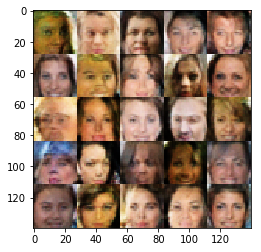

Epoch 1/4... Discriminator Loss: 0.6095... Generator Loss: 1.9247
Epoch 1/4... Discriminator Loss: 1.0693... Generator Loss: 1.9603
Epoch 1/4... Discriminator Loss: 0.8318... Generator Loss: 1.2417
Epoch 1/4... Discriminator Loss: 0.8050... Generator Loss: 1.5504
Epoch 1/4... Discriminator Loss: 0.8811... Generator Loss: 1.2370
Epoch 1/4... Discriminator Loss: 0.9073... Generator Loss: 0.9882
Epoch 1/4... Discriminator Loss: 0.6585... Generator Loss: 2.0187
Epoch 1/4... Discriminator Loss: 0.8865... Generator Loss: 1.2399
Epoch 1/4... Discriminator Loss: 0.8848... Generator Loss: 0.9900
Epoch 1/4... Discriminator Loss: 0.7869... Generator Loss: 1.2799


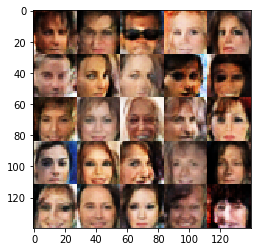

Epoch 1/4... Discriminator Loss: 0.9159... Generator Loss: 1.0424
Epoch 1/4... Discriminator Loss: 1.8205... Generator Loss: 0.3075
Epoch 1/4... Discriminator Loss: 1.0008... Generator Loss: 0.9744
Epoch 1/4... Discriminator Loss: 0.7481... Generator Loss: 1.9519
Epoch 1/4... Discriminator Loss: 0.9090... Generator Loss: 2.1823
Epoch 1/4... Discriminator Loss: 0.9561... Generator Loss: 1.0145
Epoch 1/4... Discriminator Loss: 0.8306... Generator Loss: 1.4684
Epoch 1/4... Discriminator Loss: 1.1283... Generator Loss: 0.7668
Epoch 1/4... Discriminator Loss: 1.0813... Generator Loss: 0.8037
Epoch 1/4... Discriminator Loss: 0.9665... Generator Loss: 0.9759


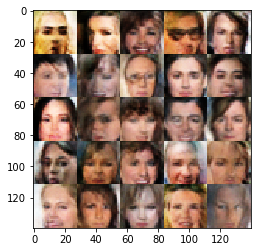

Epoch 1/4... Discriminator Loss: 0.8587... Generator Loss: 1.1220
Epoch 1/4... Discriminator Loss: 0.8340... Generator Loss: 1.1003
Epoch 1/4... Discriminator Loss: 0.7867... Generator Loss: 1.1943
Epoch 1/4... Discriminator Loss: 1.3227... Generator Loss: 0.6259
Epoch 1/4... Discriminator Loss: 0.9300... Generator Loss: 0.9355
Epoch 1/4... Discriminator Loss: 1.3471... Generator Loss: 0.5472
Epoch 1/4... Discriminator Loss: 0.8329... Generator Loss: 1.1481
Epoch 1/4... Discriminator Loss: 0.9355... Generator Loss: 1.9226
Epoch 1/4... Discriminator Loss: 0.7500... Generator Loss: 2.2683
Epoch 1/4... Discriminator Loss: 0.8446... Generator Loss: 1.4269


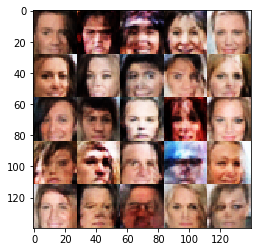

Epoch 1/4... Discriminator Loss: 0.8049... Generator Loss: 1.1617
Epoch 1/4... Discriminator Loss: 0.6325... Generator Loss: 1.6521
Epoch 1/4... Discriminator Loss: 1.1220... Generator Loss: 0.7091
Epoch 1/4... Discriminator Loss: 1.0233... Generator Loss: 0.8103
Epoch 1/4... Discriminator Loss: 0.6896... Generator Loss: 1.6372
Epoch 1/4... Discriminator Loss: 1.1936... Generator Loss: 0.6469
Epoch 1/4... Discriminator Loss: 1.1674... Generator Loss: 0.6953
Epoch 1/4... Discriminator Loss: 0.8499... Generator Loss: 1.1321
Epoch 1/4... Discriminator Loss: 0.8472... Generator Loss: 1.1045
Epoch 1/4... Discriminator Loss: 0.7526... Generator Loss: 1.4918


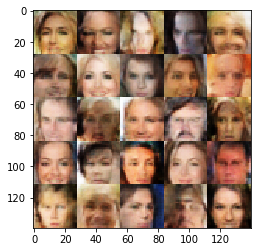

Epoch 1/4... Discriminator Loss: 1.2371... Generator Loss: 0.6426
Epoch 1/4... Discriminator Loss: 0.7753... Generator Loss: 1.2694
Epoch 1/4... Discriminator Loss: 0.8044... Generator Loss: 1.4482
Epoch 1/4... Discriminator Loss: 1.3671... Generator Loss: 0.4960
Epoch 1/4... Discriminator Loss: 0.8737... Generator Loss: 1.0122
Epoch 1/4... Discriminator Loss: 0.9176... Generator Loss: 1.4610
Epoch 1/4... Discriminator Loss: 0.8667... Generator Loss: 1.8162
Epoch 1/4... Discriminator Loss: 1.6635... Generator Loss: 2.6362
Epoch 1/4... Discriminator Loss: 1.2637... Generator Loss: 0.6340
Epoch 1/4... Discriminator Loss: 0.9694... Generator Loss: 0.9896


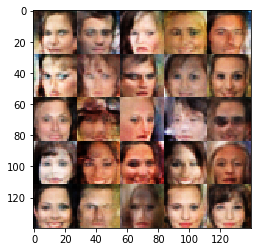

Epoch 1/4... Discriminator Loss: 0.7071... Generator Loss: 1.3038
Epoch 1/4... Discriminator Loss: 1.0038... Generator Loss: 1.1309
Epoch 1/4... Discriminator Loss: 1.2282... Generator Loss: 0.6348
Epoch 1/4... Discriminator Loss: 0.6603... Generator Loss: 1.5429
Epoch 1/4... Discriminator Loss: 0.9519... Generator Loss: 0.9718
Epoch 1/4... Discriminator Loss: 1.1195... Generator Loss: 0.7388
Epoch 1/4... Discriminator Loss: 0.9596... Generator Loss: 0.9081
Epoch 1/4... Discriminator Loss: 1.0115... Generator Loss: 0.9787
Epoch 1/4... Discriminator Loss: 0.8634... Generator Loss: 1.0471
Epoch 1/4... Discriminator Loss: 1.6276... Generator Loss: 0.3953


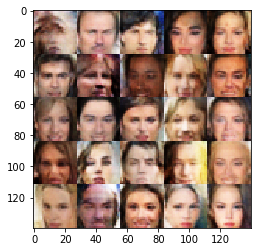

Epoch 1/4... Discriminator Loss: 0.8079... Generator Loss: 1.3466
Epoch 1/4... Discriminator Loss: 0.8325... Generator Loss: 1.4702
Epoch 1/4... Discriminator Loss: 0.6518... Generator Loss: 1.8809
Epoch 2/4... Discriminator Loss: 1.0332... Generator Loss: 0.7927
Epoch 2/4... Discriminator Loss: 0.8227... Generator Loss: 1.3914
Epoch 2/4... Discriminator Loss: 0.9529... Generator Loss: 1.2151
Epoch 2/4... Discriminator Loss: 0.9563... Generator Loss: 0.9099
Epoch 2/4... Discriminator Loss: 1.0155... Generator Loss: 0.9380
Epoch 2/4... Discriminator Loss: 0.8429... Generator Loss: 1.1575
Epoch 2/4... Discriminator Loss: 1.0433... Generator Loss: 1.0873


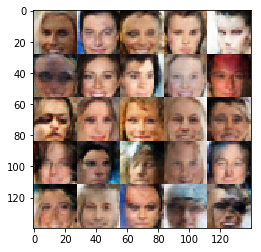

Epoch 2/4... Discriminator Loss: 0.6148... Generator Loss: 1.7261
Epoch 2/4... Discriminator Loss: 1.5714... Generator Loss: 0.4711
Epoch 2/4... Discriminator Loss: 0.7616... Generator Loss: 1.2358
Epoch 2/4... Discriminator Loss: 0.8923... Generator Loss: 0.9772
Epoch 2/4... Discriminator Loss: 1.1624... Generator Loss: 0.7118
Epoch 2/4... Discriminator Loss: 1.1301... Generator Loss: 0.6684
Epoch 2/4... Discriminator Loss: 0.9396... Generator Loss: 0.9987
Epoch 2/4... Discriminator Loss: 0.9808... Generator Loss: 0.8786
Epoch 2/4... Discriminator Loss: 0.8104... Generator Loss: 1.1837
Epoch 2/4... Discriminator Loss: 1.0674... Generator Loss: 0.7684


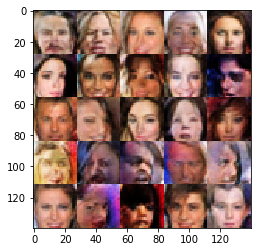

Epoch 2/4... Discriminator Loss: 0.6872... Generator Loss: 1.6466
Epoch 2/4... Discriminator Loss: 0.8720... Generator Loss: 1.5148
Epoch 2/4... Discriminator Loss: 1.4191... Generator Loss: 0.5037
Epoch 2/4... Discriminator Loss: 0.7843... Generator Loss: 1.5512
Epoch 2/4... Discriminator Loss: 0.8775... Generator Loss: 1.0264
Epoch 2/4... Discriminator Loss: 1.2498... Generator Loss: 0.6223
Epoch 2/4... Discriminator Loss: 1.0368... Generator Loss: 0.7890
Epoch 2/4... Discriminator Loss: 0.7698... Generator Loss: 1.4448
Epoch 2/4... Discriminator Loss: 0.9092... Generator Loss: 1.9343
Epoch 2/4... Discriminator Loss: 0.7791... Generator Loss: 1.2281


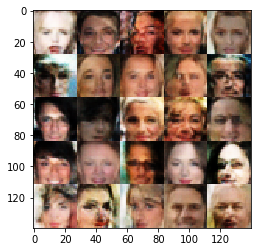

Epoch 2/4... Discriminator Loss: 0.8603... Generator Loss: 1.1718
Epoch 2/4... Discriminator Loss: 0.7511... Generator Loss: 1.2612
Epoch 2/4... Discriminator Loss: 0.8899... Generator Loss: 1.1357
Epoch 2/4... Discriminator Loss: 0.8886... Generator Loss: 1.1269
Epoch 2/4... Discriminator Loss: 0.8923... Generator Loss: 1.1587
Epoch 2/4... Discriminator Loss: 0.7792... Generator Loss: 2.1858
Epoch 2/4... Discriminator Loss: 0.9394... Generator Loss: 1.3046
Epoch 2/4... Discriminator Loss: 1.0578... Generator Loss: 0.8037
Epoch 2/4... Discriminator Loss: 0.7654... Generator Loss: 1.7126
Epoch 2/4... Discriminator Loss: 0.7777... Generator Loss: 1.6479


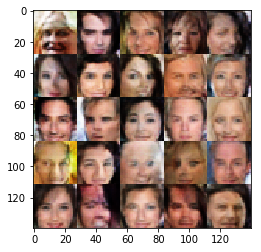

Epoch 2/4... Discriminator Loss: 1.2084... Generator Loss: 0.6796
Epoch 2/4... Discriminator Loss: 0.5983... Generator Loss: 1.9095
Epoch 2/4... Discriminator Loss: 0.8085... Generator Loss: 1.1373
Epoch 2/4... Discriminator Loss: 1.3427... Generator Loss: 0.5397
Epoch 2/4... Discriminator Loss: 1.1021... Generator Loss: 0.7265
Epoch 2/4... Discriminator Loss: 1.0493... Generator Loss: 0.8402
Epoch 2/4... Discriminator Loss: 0.9679... Generator Loss: 0.9455
Epoch 2/4... Discriminator Loss: 0.7399... Generator Loss: 1.3922
Epoch 2/4... Discriminator Loss: 0.6144... Generator Loss: 1.8668
Epoch 2/4... Discriminator Loss: 0.7824... Generator Loss: 1.8496


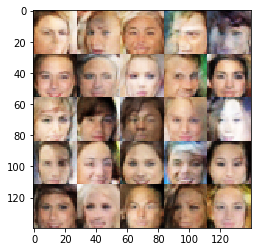

Epoch 2/4... Discriminator Loss: 0.9459... Generator Loss: 0.9641
Epoch 2/4... Discriminator Loss: 0.7906... Generator Loss: 1.2074
Epoch 2/4... Discriminator Loss: 0.8364... Generator Loss: 1.1649
Epoch 2/4... Discriminator Loss: 0.8889... Generator Loss: 0.9910
Epoch 2/4... Discriminator Loss: 0.9311... Generator Loss: 1.0149
Epoch 2/4... Discriminator Loss: 1.3121... Generator Loss: 0.6112
Epoch 2/4... Discriminator Loss: 0.8370... Generator Loss: 1.9685
Epoch 2/4... Discriminator Loss: 0.9276... Generator Loss: 1.3868
Epoch 2/4... Discriminator Loss: 0.9733... Generator Loss: 1.0615
Epoch 2/4... Discriminator Loss: 0.9754... Generator Loss: 0.9174


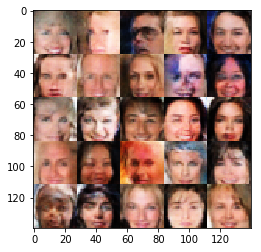

Epoch 2/4... Discriminator Loss: 0.8104... Generator Loss: 1.6665
Epoch 2/4... Discriminator Loss: 0.9053... Generator Loss: 1.2993
Epoch 2/4... Discriminator Loss: 1.0886... Generator Loss: 0.7473
Epoch 2/4... Discriminator Loss: 0.8981... Generator Loss: 1.4215
Epoch 2/4... Discriminator Loss: 0.9518... Generator Loss: 1.0036
Epoch 2/4... Discriminator Loss: 1.0404... Generator Loss: 0.8532
Epoch 2/4... Discriminator Loss: 0.7960... Generator Loss: 1.5064
Epoch 2/4... Discriminator Loss: 0.8813... Generator Loss: 1.0362
Epoch 2/4... Discriminator Loss: 1.0153... Generator Loss: 0.8788
Epoch 2/4... Discriminator Loss: 1.5343... Generator Loss: 0.4850


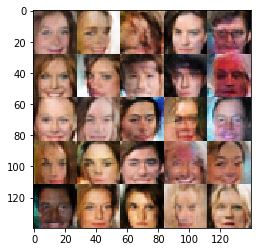

Epoch 2/4... Discriminator Loss: 0.7755... Generator Loss: 1.5617
Epoch 2/4... Discriminator Loss: 0.9458... Generator Loss: 1.1366
Epoch 2/4... Discriminator Loss: 1.2439... Generator Loss: 0.6454
Epoch 2/4... Discriminator Loss: 1.5695... Generator Loss: 0.4107
Epoch 2/4... Discriminator Loss: 0.9936... Generator Loss: 1.0772
Epoch 2/4... Discriminator Loss: 0.8235... Generator Loss: 1.2263
Epoch 2/4... Discriminator Loss: 0.7963... Generator Loss: 2.3249
Epoch 2/4... Discriminator Loss: 1.0321... Generator Loss: 0.7720
Epoch 2/4... Discriminator Loss: 0.9311... Generator Loss: 1.3743
Epoch 2/4... Discriminator Loss: 0.8933... Generator Loss: 1.0671


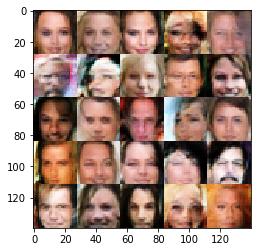

Epoch 2/4... Discriminator Loss: 1.0355... Generator Loss: 0.8661
Epoch 2/4... Discriminator Loss: 0.6524... Generator Loss: 1.9435
Epoch 2/4... Discriminator Loss: 0.8932... Generator Loss: 1.0456
Epoch 2/4... Discriminator Loss: 1.5623... Generator Loss: 0.4108
Epoch 2/4... Discriminator Loss: 0.9566... Generator Loss: 1.1131
Epoch 2/4... Discriminator Loss: 1.2630... Generator Loss: 0.6412
Epoch 2/4... Discriminator Loss: 1.2746... Generator Loss: 0.5837
Epoch 2/4... Discriminator Loss: 1.0657... Generator Loss: 0.8565
Epoch 2/4... Discriminator Loss: 0.9133... Generator Loss: 2.4199
Epoch 2/4... Discriminator Loss: 0.8697... Generator Loss: 1.0791


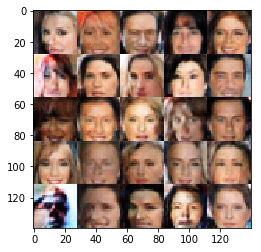

Epoch 2/4... Discriminator Loss: 0.7075... Generator Loss: 1.9841
Epoch 2/4... Discriminator Loss: 1.1034... Generator Loss: 0.9408
Epoch 2/4... Discriminator Loss: 1.1881... Generator Loss: 0.6140
Epoch 2/4... Discriminator Loss: 0.6989... Generator Loss: 1.4877
Epoch 2/4... Discriminator Loss: 1.2063... Generator Loss: 0.6609
Epoch 2/4... Discriminator Loss: 1.2234... Generator Loss: 0.6399
Epoch 2/4... Discriminator Loss: 1.0633... Generator Loss: 0.8362
Epoch 2/4... Discriminator Loss: 1.0356... Generator Loss: 0.8382
Epoch 2/4... Discriminator Loss: 1.1123... Generator Loss: 0.7163
Epoch 2/4... Discriminator Loss: 0.7726... Generator Loss: 1.2032


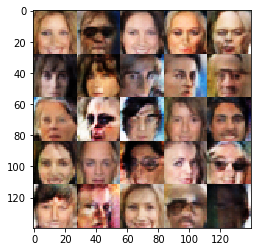

Epoch 2/4... Discriminator Loss: 1.0400... Generator Loss: 0.8561
Epoch 2/4... Discriminator Loss: 0.8811... Generator Loss: 1.1605
Epoch 2/4... Discriminator Loss: 0.8482... Generator Loss: 1.4180
Epoch 2/4... Discriminator Loss: 0.6867... Generator Loss: 1.4296
Epoch 2/4... Discriminator Loss: 1.1216... Generator Loss: 0.7236
Epoch 2/4... Discriminator Loss: 0.6943... Generator Loss: 1.3668
Epoch 2/4... Discriminator Loss: 1.1369... Generator Loss: 0.6890
Epoch 2/4... Discriminator Loss: 1.2436... Generator Loss: 0.6246
Epoch 2/4... Discriminator Loss: 0.8848... Generator Loss: 1.5143
Epoch 2/4... Discriminator Loss: 1.1581... Generator Loss: 0.6925


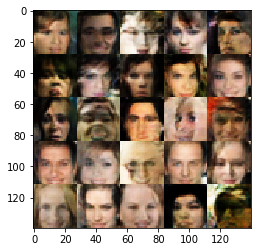

Epoch 2/4... Discriminator Loss: 0.8179... Generator Loss: 1.0985
Epoch 2/4... Discriminator Loss: 0.7012... Generator Loss: 1.6049
Epoch 2/4... Discriminator Loss: 0.9385... Generator Loss: 1.2807
Epoch 2/4... Discriminator Loss: 1.3589... Generator Loss: 0.5222
Epoch 2/4... Discriminator Loss: 1.0675... Generator Loss: 0.9596
Epoch 2/4... Discriminator Loss: 1.0161... Generator Loss: 0.8819
Epoch 2/4... Discriminator Loss: 0.8275... Generator Loss: 1.1737
Epoch 2/4... Discriminator Loss: 1.1226... Generator Loss: 0.7239
Epoch 2/4... Discriminator Loss: 0.8078... Generator Loss: 1.5363
Epoch 2/4... Discriminator Loss: 0.8951... Generator Loss: 1.1372


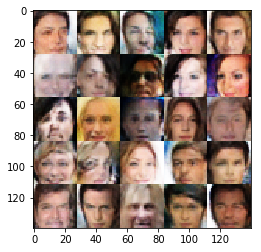

Epoch 2/4... Discriminator Loss: 1.0039... Generator Loss: 0.8502
Epoch 2/4... Discriminator Loss: 0.9055... Generator Loss: 0.9923
Epoch 2/4... Discriminator Loss: 0.9608... Generator Loss: 0.9298
Epoch 2/4... Discriminator Loss: 0.9580... Generator Loss: 1.7055
Epoch 2/4... Discriminator Loss: 0.7827... Generator Loss: 1.1972
Epoch 2/4... Discriminator Loss: 0.8044... Generator Loss: 1.2059
Epoch 2/4... Discriminator Loss: 1.0448... Generator Loss: 0.8234
Epoch 2/4... Discriminator Loss: 0.7601... Generator Loss: 1.2846
Epoch 2/4... Discriminator Loss: 0.7774... Generator Loss: 1.2174
Epoch 2/4... Discriminator Loss: 0.8425... Generator Loss: 1.4678


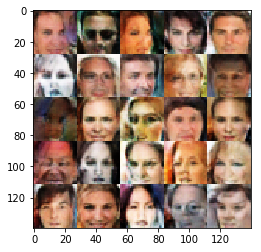

Epoch 2/4... Discriminator Loss: 0.9265... Generator Loss: 0.9573
Epoch 2/4... Discriminator Loss: 0.9193... Generator Loss: 0.9672
Epoch 2/4... Discriminator Loss: 0.7384... Generator Loss: 1.8393
Epoch 2/4... Discriminator Loss: 0.8676... Generator Loss: 1.2748
Epoch 2/4... Discriminator Loss: 1.3346... Generator Loss: 0.5714
Epoch 2/4... Discriminator Loss: 0.8635... Generator Loss: 1.0370
Epoch 2/4... Discriminator Loss: 1.0268... Generator Loss: 0.7923
Epoch 2/4... Discriminator Loss: 0.8612... Generator Loss: 1.1771
Epoch 2/4... Discriminator Loss: 1.4489... Generator Loss: 0.4681
Epoch 2/4... Discriminator Loss: 1.2598... Generator Loss: 0.6184


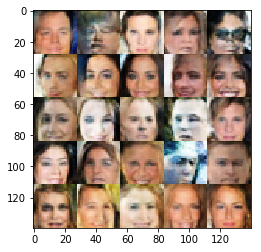

Epoch 2/4... Discriminator Loss: 0.9288... Generator Loss: 1.1954
Epoch 2/4... Discriminator Loss: 0.9271... Generator Loss: 1.0397
Epoch 2/4... Discriminator Loss: 0.6439... Generator Loss: 1.8331
Epoch 2/4... Discriminator Loss: 1.1573... Generator Loss: 0.6623
Epoch 2/4... Discriminator Loss: 0.8887... Generator Loss: 1.6716
Epoch 2/4... Discriminator Loss: 1.0556... Generator Loss: 0.7742
Epoch 2/4... Discriminator Loss: 0.8907... Generator Loss: 1.0077
Epoch 2/4... Discriminator Loss: 1.1859... Generator Loss: 1.4958
Epoch 2/4... Discriminator Loss: 0.7621... Generator Loss: 1.4683
Epoch 2/4... Discriminator Loss: 0.8970... Generator Loss: 1.3578


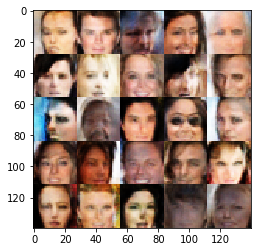

Epoch 2/4... Discriminator Loss: 1.0060... Generator Loss: 0.9773
Epoch 2/4... Discriminator Loss: 0.7284... Generator Loss: 1.4539
Epoch 2/4... Discriminator Loss: 1.1269... Generator Loss: 0.7880
Epoch 2/4... Discriminator Loss: 1.2426... Generator Loss: 0.7298
Epoch 2/4... Discriminator Loss: 0.7872... Generator Loss: 1.3745
Epoch 2/4... Discriminator Loss: 0.8320... Generator Loss: 1.7609
Epoch 2/4... Discriminator Loss: 0.8073... Generator Loss: 1.3310
Epoch 2/4... Discriminator Loss: 0.8757... Generator Loss: 1.1528
Epoch 2/4... Discriminator Loss: 1.2075... Generator Loss: 0.9486
Epoch 2/4... Discriminator Loss: 0.7057... Generator Loss: 1.9164


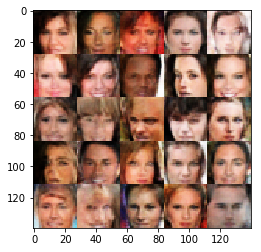

Epoch 2/4... Discriminator Loss: 0.6139... Generator Loss: 1.8277
Epoch 2/4... Discriminator Loss: 1.0430... Generator Loss: 1.0799
Epoch 2/4... Discriminator Loss: 1.0241... Generator Loss: 0.9769
Epoch 2/4... Discriminator Loss: 0.8083... Generator Loss: 1.2865
Epoch 2/4... Discriminator Loss: 0.8721... Generator Loss: 1.3196
Epoch 2/4... Discriminator Loss: 0.8233... Generator Loss: 1.1313
Epoch 2/4... Discriminator Loss: 1.1637... Generator Loss: 0.6445
Epoch 2/4... Discriminator Loss: 0.9009... Generator Loss: 1.1886
Epoch 2/4... Discriminator Loss: 1.2217... Generator Loss: 0.6199
Epoch 2/4... Discriminator Loss: 0.7611... Generator Loss: 1.4414


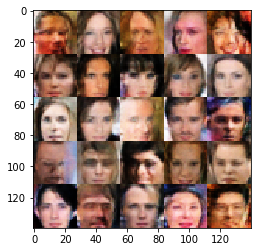

Epoch 2/4... Discriminator Loss: 1.3493... Generator Loss: 0.5153
Epoch 2/4... Discriminator Loss: 0.8063... Generator Loss: 1.2526
Epoch 2/4... Discriminator Loss: 1.2253... Generator Loss: 0.6927
Epoch 2/4... Discriminator Loss: 0.9955... Generator Loss: 0.8557
Epoch 2/4... Discriminator Loss: 0.6260... Generator Loss: 1.6758
Epoch 2/4... Discriminator Loss: 0.9555... Generator Loss: 1.1147
Epoch 2/4... Discriminator Loss: 0.9520... Generator Loss: 2.3166
Epoch 2/4... Discriminator Loss: 0.9383... Generator Loss: 1.4593
Epoch 2/4... Discriminator Loss: 1.1443... Generator Loss: 0.6653
Epoch 2/4... Discriminator Loss: 0.9361... Generator Loss: 0.9556


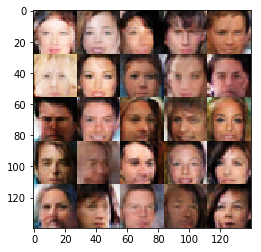

Epoch 2/4... Discriminator Loss: 0.8399... Generator Loss: 1.0894
Epoch 2/4... Discriminator Loss: 0.6706... Generator Loss: 1.6672
Epoch 2/4... Discriminator Loss: 0.7237... Generator Loss: 1.4493
Epoch 2/4... Discriminator Loss: 0.9973... Generator Loss: 0.8827
Epoch 2/4... Discriminator Loss: 1.2137... Generator Loss: 0.6353
Epoch 2/4... Discriminator Loss: 0.6967... Generator Loss: 1.8248
Epoch 2/4... Discriminator Loss: 1.0916... Generator Loss: 0.8270
Epoch 2/4... Discriminator Loss: 1.6430... Generator Loss: 0.4025
Epoch 2/4... Discriminator Loss: 0.9752... Generator Loss: 0.9108
Epoch 2/4... Discriminator Loss: 1.4223... Generator Loss: 0.5312


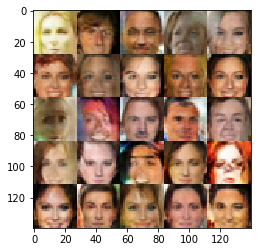

Epoch 2/4... Discriminator Loss: 1.0595... Generator Loss: 0.7509
Epoch 2/4... Discriminator Loss: 1.1639... Generator Loss: 0.6565
Epoch 2/4... Discriminator Loss: 0.6834... Generator Loss: 1.9326
Epoch 2/4... Discriminator Loss: 1.0930... Generator Loss: 0.7679
Epoch 2/4... Discriminator Loss: 0.9957... Generator Loss: 0.9364
Epoch 2/4... Discriminator Loss: 1.0543... Generator Loss: 0.7452
Epoch 2/4... Discriminator Loss: 1.3507... Generator Loss: 0.5402
Epoch 2/4... Discriminator Loss: 1.0121... Generator Loss: 0.8301
Epoch 2/4... Discriminator Loss: 0.8339... Generator Loss: 1.7297
Epoch 2/4... Discriminator Loss: 0.9404... Generator Loss: 1.0813


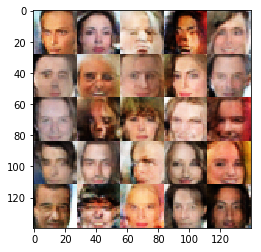

Epoch 2/4... Discriminator Loss: 1.0872... Generator Loss: 1.4291
Epoch 2/4... Discriminator Loss: 0.7707... Generator Loss: 2.4050
Epoch 2/4... Discriminator Loss: 1.0077... Generator Loss: 1.2125
Epoch 2/4... Discriminator Loss: 0.9749... Generator Loss: 1.5269
Epoch 2/4... Discriminator Loss: 0.9889... Generator Loss: 0.8733
Epoch 2/4... Discriminator Loss: 1.0272... Generator Loss: 0.8868
Epoch 2/4... Discriminator Loss: 1.4918... Generator Loss: 0.4856
Epoch 2/4... Discriminator Loss: 0.7520... Generator Loss: 1.3694
Epoch 2/4... Discriminator Loss: 0.9228... Generator Loss: 0.9659
Epoch 2/4... Discriminator Loss: 0.8177... Generator Loss: 1.1817


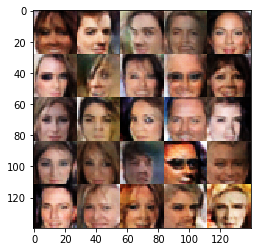

Epoch 2/4... Discriminator Loss: 1.3127... Generator Loss: 0.5949
Epoch 2/4... Discriminator Loss: 0.7775... Generator Loss: 1.3249
Epoch 2/4... Discriminator Loss: 0.7435... Generator Loss: 1.5348
Epoch 2/4... Discriminator Loss: 0.7547... Generator Loss: 1.4536
Epoch 2/4... Discriminator Loss: 0.7918... Generator Loss: 1.1900
Epoch 2/4... Discriminator Loss: 0.9512... Generator Loss: 0.8920
Epoch 2/4... Discriminator Loss: 1.7169... Generator Loss: 0.3296
Epoch 2/4... Discriminator Loss: 0.7529... Generator Loss: 1.3001
Epoch 2/4... Discriminator Loss: 0.7585... Generator Loss: 1.5205
Epoch 2/4... Discriminator Loss: 0.9052... Generator Loss: 0.9868


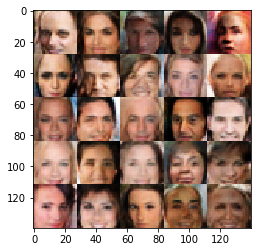

Epoch 2/4... Discriminator Loss: 0.8562... Generator Loss: 1.1040
Epoch 2/4... Discriminator Loss: 0.6996... Generator Loss: 1.4463
Epoch 2/4... Discriminator Loss: 1.2315... Generator Loss: 0.6049
Epoch 2/4... Discriminator Loss: 0.8462... Generator Loss: 1.1561
Epoch 2/4... Discriminator Loss: 0.7834... Generator Loss: 1.7913
Epoch 2/4... Discriminator Loss: 0.9235... Generator Loss: 0.9022
Epoch 2/4... Discriminator Loss: 0.6841... Generator Loss: 1.7291
Epoch 2/4... Discriminator Loss: 1.1675... Generator Loss: 0.8410
Epoch 2/4... Discriminator Loss: 0.8929... Generator Loss: 1.4022
Epoch 2/4... Discriminator Loss: 0.9935... Generator Loss: 0.8971


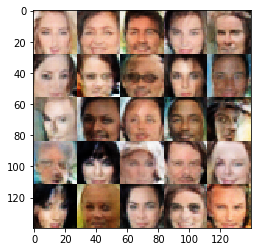

Epoch 2/4... Discriminator Loss: 0.8568... Generator Loss: 1.1778
Epoch 2/4... Discriminator Loss: 0.7883... Generator Loss: 1.5446
Epoch 2/4... Discriminator Loss: 0.8767... Generator Loss: 1.4878
Epoch 2/4... Discriminator Loss: 0.6976... Generator Loss: 1.6738
Epoch 2/4... Discriminator Loss: 0.6461... Generator Loss: 1.6719
Epoch 2/4... Discriminator Loss: 0.7676... Generator Loss: 1.3697
Epoch 2/4... Discriminator Loss: 0.8501... Generator Loss: 1.3847
Epoch 2/4... Discriminator Loss: 1.1917... Generator Loss: 0.6681
Epoch 2/4... Discriminator Loss: 1.0676... Generator Loss: 0.8230
Epoch 2/4... Discriminator Loss: 1.0353... Generator Loss: 0.7985


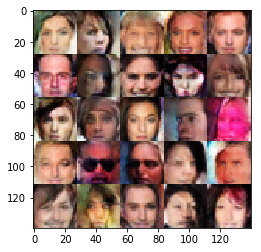

Epoch 2/4... Discriminator Loss: 0.8674... Generator Loss: 1.4086
Epoch 2/4... Discriminator Loss: 0.8985... Generator Loss: 1.3164
Epoch 2/4... Discriminator Loss: 1.0107... Generator Loss: 0.7787
Epoch 2/4... Discriminator Loss: 1.3861... Generator Loss: 0.5115
Epoch 2/4... Discriminator Loss: 1.0666... Generator Loss: 0.8982
Epoch 2/4... Discriminator Loss: 1.0459... Generator Loss: 0.8333
Epoch 2/4... Discriminator Loss: 1.0046... Generator Loss: 0.9147
Epoch 2/4... Discriminator Loss: 0.9417... Generator Loss: 1.1897
Epoch 2/4... Discriminator Loss: 1.0349... Generator Loss: 1.1138
Epoch 2/4... Discriminator Loss: 0.9191... Generator Loss: 1.8084


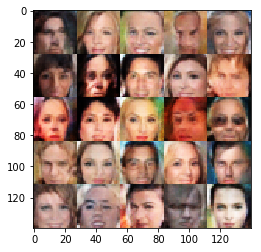

Epoch 2/4... Discriminator Loss: 1.0790... Generator Loss: 0.7684
Epoch 2/4... Discriminator Loss: 0.9930... Generator Loss: 1.0599
Epoch 2/4... Discriminator Loss: 1.1062... Generator Loss: 0.7080
Epoch 2/4... Discriminator Loss: 1.3234... Generator Loss: 0.5367
Epoch 2/4... Discriminator Loss: 1.0739... Generator Loss: 0.8292
Epoch 2/4... Discriminator Loss: 1.0019... Generator Loss: 0.8315
Epoch 2/4... Discriminator Loss: 1.9984... Generator Loss: 0.2599
Epoch 2/4... Discriminator Loss: 1.0301... Generator Loss: 0.9576
Epoch 2/4... Discriminator Loss: 1.2587... Generator Loss: 0.6882
Epoch 2/4... Discriminator Loss: 0.7181... Generator Loss: 2.0504


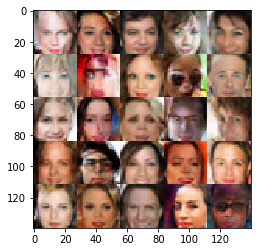

Epoch 2/4... Discriminator Loss: 0.8500... Generator Loss: 1.5818
Epoch 2/4... Discriminator Loss: 1.0810... Generator Loss: 0.7523
Epoch 2/4... Discriminator Loss: 0.7674... Generator Loss: 1.4781
Epoch 2/4... Discriminator Loss: 0.9885... Generator Loss: 0.9066
Epoch 2/4... Discriminator Loss: 0.9657... Generator Loss: 1.0004
Epoch 2/4... Discriminator Loss: 0.9172... Generator Loss: 1.0047
Epoch 2/4... Discriminator Loss: 0.9755... Generator Loss: 1.0466
Epoch 2/4... Discriminator Loss: 0.8235... Generator Loss: 1.2562
Epoch 2/4... Discriminator Loss: 0.8158... Generator Loss: 1.3558
Epoch 2/4... Discriminator Loss: 0.7970... Generator Loss: 1.2477


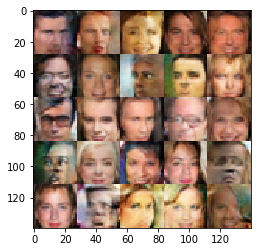

Epoch 2/4... Discriminator Loss: 1.0878... Generator Loss: 0.7197
Epoch 2/4... Discriminator Loss: 0.9779... Generator Loss: 0.9473
Epoch 2/4... Discriminator Loss: 0.9164... Generator Loss: 1.0114
Epoch 2/4... Discriminator Loss: 0.8967... Generator Loss: 0.9890
Epoch 2/4... Discriminator Loss: 1.0025... Generator Loss: 0.8141
Epoch 2/4... Discriminator Loss: 1.0786... Generator Loss: 0.7892
Epoch 2/4... Discriminator Loss: 0.9315... Generator Loss: 1.1223
Epoch 2/4... Discriminator Loss: 0.9688... Generator Loss: 0.9035
Epoch 2/4... Discriminator Loss: 0.8473... Generator Loss: 1.1746
Epoch 2/4... Discriminator Loss: 0.7284... Generator Loss: 1.5246


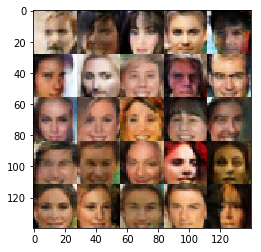

Epoch 2/4... Discriminator Loss: 0.5364... Generator Loss: 2.2512
Epoch 2/4... Discriminator Loss: 1.1709... Generator Loss: 0.7003
Epoch 2/4... Discriminator Loss: 0.7487... Generator Loss: 1.8261
Epoch 2/4... Discriminator Loss: 1.0683... Generator Loss: 0.7725
Epoch 2/4... Discriminator Loss: 0.9280... Generator Loss: 1.0374
Epoch 2/4... Discriminator Loss: 1.1900... Generator Loss: 0.6882
Epoch 2/4... Discriminator Loss: 1.3638... Generator Loss: 0.4961
Epoch 2/4... Discriminator Loss: 0.8753... Generator Loss: 1.3749
Epoch 2/4... Discriminator Loss: 0.9806... Generator Loss: 1.1755
Epoch 2/4... Discriminator Loss: 0.9649... Generator Loss: 0.8825


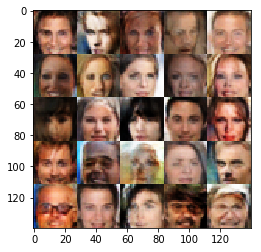

Epoch 2/4... Discriminator Loss: 1.0694... Generator Loss: 0.8220
Epoch 2/4... Discriminator Loss: 0.7502... Generator Loss: 1.4673
Epoch 2/4... Discriminator Loss: 0.8603... Generator Loss: 1.2043
Epoch 2/4... Discriminator Loss: 0.8442... Generator Loss: 1.3299
Epoch 2/4... Discriminator Loss: 0.8977... Generator Loss: 1.2435
Epoch 2/4... Discriminator Loss: 0.9490... Generator Loss: 0.9096
Epoch 2/4... Discriminator Loss: 0.6980... Generator Loss: 1.4751
Epoch 2/4... Discriminator Loss: 0.7642... Generator Loss: 1.3547
Epoch 2/4... Discriminator Loss: 0.8518... Generator Loss: 1.3079
Epoch 2/4... Discriminator Loss: 1.0280... Generator Loss: 2.2853


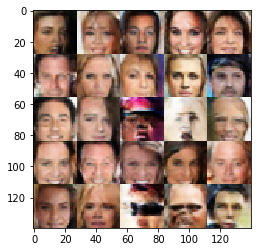

Epoch 2/4... Discriminator Loss: 0.8477... Generator Loss: 1.0767
Epoch 2/4... Discriminator Loss: 0.7564... Generator Loss: 1.3529
Epoch 2/4... Discriminator Loss: 0.8249... Generator Loss: 1.5580
Epoch 2/4... Discriminator Loss: 0.9877... Generator Loss: 0.9502
Epoch 2/4... Discriminator Loss: 0.7227... Generator Loss: 1.5916
Epoch 2/4... Discriminator Loss: 1.3325... Generator Loss: 0.6068
Epoch 2/4... Discriminator Loss: 0.9050... Generator Loss: 1.2921
Epoch 2/4... Discriminator Loss: 1.2315... Generator Loss: 0.6988
Epoch 2/4... Discriminator Loss: 0.8242... Generator Loss: 1.1914
Epoch 2/4... Discriminator Loss: 0.9874... Generator Loss: 0.9026


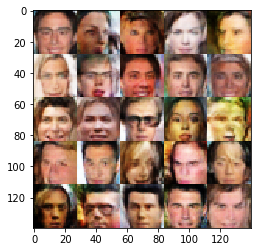

Epoch 2/4... Discriminator Loss: 1.3851... Generator Loss: 0.5122
Epoch 2/4... Discriminator Loss: 1.0485... Generator Loss: 0.8485
Epoch 2/4... Discriminator Loss: 0.8658... Generator Loss: 1.0938
Epoch 2/4... Discriminator Loss: 0.8515... Generator Loss: 1.3891
Epoch 2/4... Discriminator Loss: 0.8275... Generator Loss: 1.7394
Epoch 2/4... Discriminator Loss: 1.1701... Generator Loss: 0.6744
Epoch 2/4... Discriminator Loss: 1.6858... Generator Loss: 0.3374
Epoch 2/4... Discriminator Loss: 0.8564... Generator Loss: 1.3242
Epoch 2/4... Discriminator Loss: 1.6990... Generator Loss: 0.3531
Epoch 2/4... Discriminator Loss: 1.1254... Generator Loss: 0.8128


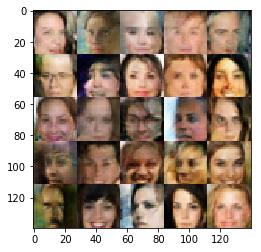

Epoch 2/4... Discriminator Loss: 1.0400... Generator Loss: 1.3611
Epoch 2/4... Discriminator Loss: 0.6894... Generator Loss: 1.6655
Epoch 2/4... Discriminator Loss: 1.0942... Generator Loss: 0.8965
Epoch 2/4... Discriminator Loss: 0.6958... Generator Loss: 1.8587
Epoch 2/4... Discriminator Loss: 1.0774... Generator Loss: 0.7630
Epoch 2/4... Discriminator Loss: 1.7581... Generator Loss: 0.3252
Epoch 2/4... Discriminator Loss: 0.7062... Generator Loss: 1.6070
Epoch 2/4... Discriminator Loss: 1.0762... Generator Loss: 0.8977
Epoch 2/4... Discriminator Loss: 1.0334... Generator Loss: 0.9686
Epoch 2/4... Discriminator Loss: 0.8390... Generator Loss: 1.3010


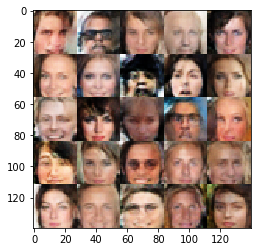

Epoch 2/4... Discriminator Loss: 0.7330... Generator Loss: 1.7588
Epoch 2/4... Discriminator Loss: 1.6605... Generator Loss: 0.3942
Epoch 2/4... Discriminator Loss: 0.9975... Generator Loss: 1.0568
Epoch 2/4... Discriminator Loss: 0.7131... Generator Loss: 1.4176
Epoch 2/4... Discriminator Loss: 0.7297... Generator Loss: 1.4507
Epoch 2/4... Discriminator Loss: 0.8125... Generator Loss: 1.1685
Epoch 2/4... Discriminator Loss: 0.9404... Generator Loss: 1.0239
Epoch 2/4... Discriminator Loss: 0.8835... Generator Loss: 1.4057
Epoch 2/4... Discriminator Loss: 0.8353... Generator Loss: 1.3099
Epoch 2/4... Discriminator Loss: 0.6387... Generator Loss: 1.5568


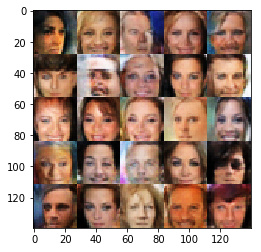

Epoch 2/4... Discriminator Loss: 0.9627... Generator Loss: 0.9680
Epoch 2/4... Discriminator Loss: 0.9980... Generator Loss: 0.8376
Epoch 2/4... Discriminator Loss: 0.8537... Generator Loss: 1.8014
Epoch 2/4... Discriminator Loss: 0.9540... Generator Loss: 1.2295
Epoch 2/4... Discriminator Loss: 0.8239... Generator Loss: 1.4224
Epoch 2/4... Discriminator Loss: 0.7381... Generator Loss: 1.2737
Epoch 2/4... Discriminator Loss: 0.8162... Generator Loss: 1.3753
Epoch 2/4... Discriminator Loss: 0.8081... Generator Loss: 1.3230
Epoch 2/4... Discriminator Loss: 0.9961... Generator Loss: 0.8612
Epoch 2/4... Discriminator Loss: 0.6912... Generator Loss: 1.7109


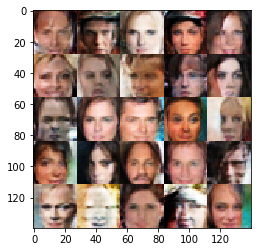

Epoch 2/4... Discriminator Loss: 1.3246... Generator Loss: 0.5527
Epoch 2/4... Discriminator Loss: 0.7019... Generator Loss: 1.5906
Epoch 2/4... Discriminator Loss: 1.3033... Generator Loss: 1.6033
Epoch 2/4... Discriminator Loss: 1.1567... Generator Loss: 0.6803
Epoch 2/4... Discriminator Loss: 1.0655... Generator Loss: 0.8118
Epoch 2/4... Discriminator Loss: 1.1620... Generator Loss: 0.7008
Epoch 2/4... Discriminator Loss: 1.1871... Generator Loss: 0.6753
Epoch 2/4... Discriminator Loss: 1.6640... Generator Loss: 0.4889
Epoch 2/4... Discriminator Loss: 1.3013... Generator Loss: 0.6127
Epoch 2/4... Discriminator Loss: 0.9462... Generator Loss: 1.0380


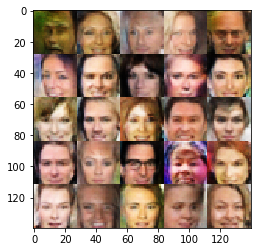

Epoch 2/4... Discriminator Loss: 0.7103... Generator Loss: 1.6198
Epoch 2/4... Discriminator Loss: 1.1840... Generator Loss: 0.7200
Epoch 2/4... Discriminator Loss: 0.9319... Generator Loss: 1.4968
Epoch 2/4... Discriminator Loss: 0.9841... Generator Loss: 2.4144
Epoch 2/4... Discriminator Loss: 1.1040... Generator Loss: 0.8605
Epoch 2/4... Discriminator Loss: 0.7469... Generator Loss: 1.3115
Epoch 2/4... Discriminator Loss: 1.1310... Generator Loss: 1.3941
Epoch 2/4... Discriminator Loss: 0.8031... Generator Loss: 1.1949
Epoch 2/4... Discriminator Loss: 0.9750... Generator Loss: 0.9390
Epoch 2/4... Discriminator Loss: 0.7446... Generator Loss: 1.7110


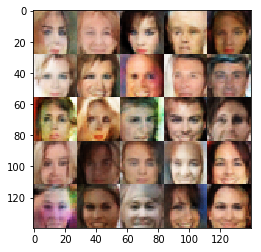

Epoch 2/4... Discriminator Loss: 0.8480... Generator Loss: 1.3563
Epoch 2/4... Discriminator Loss: 0.9112... Generator Loss: 1.1489
Epoch 2/4... Discriminator Loss: 1.1687... Generator Loss: 0.6907
Epoch 2/4... Discriminator Loss: 1.2648... Generator Loss: 0.5742
Epoch 2/4... Discriminator Loss: 1.0288... Generator Loss: 0.8603
Epoch 2/4... Discriminator Loss: 1.0681... Generator Loss: 0.7736
Epoch 2/4... Discriminator Loss: 0.7822... Generator Loss: 1.7043
Epoch 2/4... Discriminator Loss: 0.7475... Generator Loss: 1.4072
Epoch 2/4... Discriminator Loss: 0.9645... Generator Loss: 0.8838
Epoch 2/4... Discriminator Loss: 1.2615... Generator Loss: 0.5626


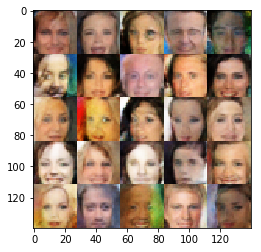

Epoch 2/4... Discriminator Loss: 0.7122... Generator Loss: 2.0791
Epoch 2/4... Discriminator Loss: 1.1948... Generator Loss: 0.6672
Epoch 2/4... Discriminator Loss: 1.1318... Generator Loss: 0.7141
Epoch 2/4... Discriminator Loss: 0.9393... Generator Loss: 1.0415
Epoch 2/4... Discriminator Loss: 0.9926... Generator Loss: 1.2531
Epoch 2/4... Discriminator Loss: 0.9308... Generator Loss: 0.9091
Epoch 2/4... Discriminator Loss: 1.2646... Generator Loss: 0.6256
Epoch 2/4... Discriminator Loss: 0.9126... Generator Loss: 0.9893
Epoch 2/4... Discriminator Loss: 0.8418... Generator Loss: 1.0836
Epoch 2/4... Discriminator Loss: 0.8626... Generator Loss: 1.1281


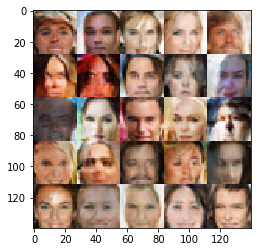

Epoch 2/4... Discriminator Loss: 1.0467... Generator Loss: 0.9012
Epoch 2/4... Discriminator Loss: 0.6822... Generator Loss: 1.5720
Epoch 2/4... Discriminator Loss: 1.1371... Generator Loss: 0.7600
Epoch 2/4... Discriminator Loss: 0.9896... Generator Loss: 0.8682
Epoch 2/4... Discriminator Loss: 0.9053... Generator Loss: 1.0636
Epoch 2/4... Discriminator Loss: 1.3570... Generator Loss: 0.4982
Epoch 2/4... Discriminator Loss: 0.8797... Generator Loss: 1.0135
Epoch 2/4... Discriminator Loss: 1.0130... Generator Loss: 0.9551
Epoch 2/4... Discriminator Loss: 1.6645... Generator Loss: 0.3892
Epoch 2/4... Discriminator Loss: 0.8735... Generator Loss: 1.3851


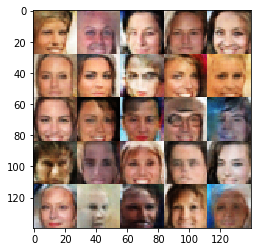

Epoch 2/4... Discriminator Loss: 1.1312... Generator Loss: 0.7906
Epoch 2/4... Discriminator Loss: 0.7829... Generator Loss: 1.4478
Epoch 2/4... Discriminator Loss: 0.7074... Generator Loss: 1.3875
Epoch 2/4... Discriminator Loss: 1.3527... Generator Loss: 0.5304
Epoch 2/4... Discriminator Loss: 0.9304... Generator Loss: 1.2504
Epoch 2/4... Discriminator Loss: 1.0491... Generator Loss: 0.8738
Epoch 2/4... Discriminator Loss: 0.8566... Generator Loss: 1.5240
Epoch 2/4... Discriminator Loss: 0.7875... Generator Loss: 1.3832
Epoch 2/4... Discriminator Loss: 1.4339... Generator Loss: 0.4666
Epoch 2/4... Discriminator Loss: 1.0724... Generator Loss: 0.7912


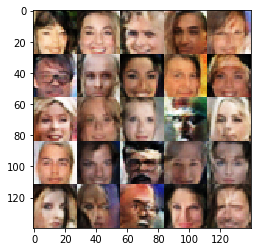

Epoch 2/4... Discriminator Loss: 1.2203... Generator Loss: 0.5953
Epoch 2/4... Discriminator Loss: 1.0389... Generator Loss: 1.0457
Epoch 2/4... Discriminator Loss: 1.0215... Generator Loss: 0.8824
Epoch 2/4... Discriminator Loss: 1.2526... Generator Loss: 0.6299
Epoch 2/4... Discriminator Loss: 0.9361... Generator Loss: 1.7309
Epoch 2/4... Discriminator Loss: 0.7960... Generator Loss: 1.1674
Epoch 2/4... Discriminator Loss: 1.0198... Generator Loss: 0.9309
Epoch 2/4... Discriminator Loss: 1.1102... Generator Loss: 0.8054
Epoch 2/4... Discriminator Loss: 0.7791... Generator Loss: 1.6649
Epoch 2/4... Discriminator Loss: 1.0815... Generator Loss: 1.7569


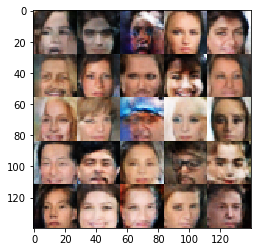

Epoch 2/4... Discriminator Loss: 1.3060... Generator Loss: 2.9763
Epoch 2/4... Discriminator Loss: 0.8970... Generator Loss: 1.3143
Epoch 2/4... Discriminator Loss: 0.7316... Generator Loss: 1.3797
Epoch 2/4... Discriminator Loss: 0.8101... Generator Loss: 1.3784
Epoch 2/4... Discriminator Loss: 0.8364... Generator Loss: 1.2786
Epoch 2/4... Discriminator Loss: 1.2676... Generator Loss: 0.6489
Epoch 2/4... Discriminator Loss: 0.9633... Generator Loss: 1.1094
Epoch 2/4... Discriminator Loss: 0.8832... Generator Loss: 1.3216
Epoch 2/4... Discriminator Loss: 0.7179... Generator Loss: 2.6401
Epoch 2/4... Discriminator Loss: 1.4184... Generator Loss: 0.4715


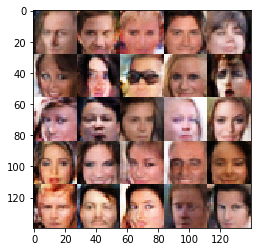

Epoch 2/4... Discriminator Loss: 1.1546... Generator Loss: 0.9749
Epoch 2/4... Discriminator Loss: 0.9803... Generator Loss: 0.9716
Epoch 2/4... Discriminator Loss: 0.9243... Generator Loss: 1.0743
Epoch 2/4... Discriminator Loss: 1.1570... Generator Loss: 0.7007
Epoch 2/4... Discriminator Loss: 0.9807... Generator Loss: 1.0532
Epoch 2/4... Discriminator Loss: 0.8459... Generator Loss: 1.4378
Epoch 2/4... Discriminator Loss: 1.1962... Generator Loss: 0.6232
Epoch 2/4... Discriminator Loss: 1.0708... Generator Loss: 0.7789
Epoch 2/4... Discriminator Loss: 1.0364... Generator Loss: 0.8141
Epoch 2/4... Discriminator Loss: 0.6915... Generator Loss: 1.7328


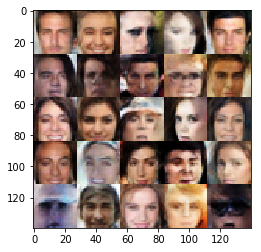

Epoch 2/4... Discriminator Loss: 1.5393... Generator Loss: 0.4432
Epoch 2/4... Discriminator Loss: 0.8713... Generator Loss: 1.0855
Epoch 2/4... Discriminator Loss: 1.3841... Generator Loss: 0.5239
Epoch 2/4... Discriminator Loss: 0.9358... Generator Loss: 0.9648
Epoch 2/4... Discriminator Loss: 0.8750... Generator Loss: 1.4579
Epoch 2/4... Discriminator Loss: 1.2481... Generator Loss: 0.5896
Epoch 2/4... Discriminator Loss: 1.0434... Generator Loss: 0.7988
Epoch 2/4... Discriminator Loss: 0.8402... Generator Loss: 1.2628
Epoch 2/4... Discriminator Loss: 0.7764... Generator Loss: 1.3709
Epoch 2/4... Discriminator Loss: 0.8571... Generator Loss: 1.0510


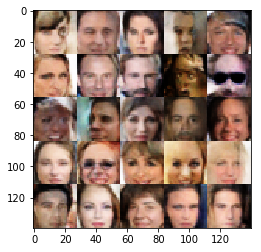

Epoch 2/4... Discriminator Loss: 0.7056... Generator Loss: 1.3480
Epoch 2/4... Discriminator Loss: 0.8834... Generator Loss: 1.2900
Epoch 2/4... Discriminator Loss: 0.8834... Generator Loss: 2.1769
Epoch 2/4... Discriminator Loss: 0.7946... Generator Loss: 1.5565
Epoch 2/4... Discriminator Loss: 1.1080... Generator Loss: 0.7585
Epoch 2/4... Discriminator Loss: 0.8741... Generator Loss: 1.0970
Epoch 2/4... Discriminator Loss: 0.8475... Generator Loss: 1.3003
Epoch 2/4... Discriminator Loss: 1.0036... Generator Loss: 1.0727
Epoch 2/4... Discriminator Loss: 0.9324... Generator Loss: 1.0397
Epoch 2/4... Discriminator Loss: 0.7547... Generator Loss: 1.2715


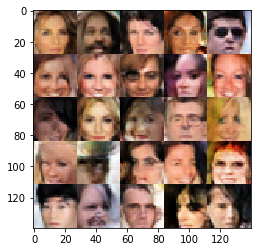

Epoch 2/4... Discriminator Loss: 0.8245... Generator Loss: 1.2870
Epoch 2/4... Discriminator Loss: 0.8044... Generator Loss: 1.2537
Epoch 2/4... Discriminator Loss: 0.7892... Generator Loss: 1.2172
Epoch 2/4... Discriminator Loss: 1.3210... Generator Loss: 0.5752
Epoch 2/4... Discriminator Loss: 0.9455... Generator Loss: 0.9596
Epoch 2/4... Discriminator Loss: 0.8438... Generator Loss: 1.1564
Epoch 2/4... Discriminator Loss: 0.9225... Generator Loss: 0.9486
Epoch 2/4... Discriminator Loss: 0.9443... Generator Loss: 1.4230
Epoch 2/4... Discriminator Loss: 1.0355... Generator Loss: 1.7411
Epoch 2/4... Discriminator Loss: 0.8914... Generator Loss: 1.2636


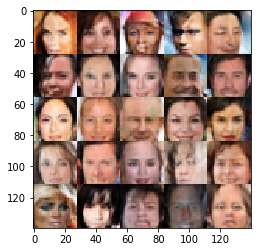

Epoch 2/4... Discriminator Loss: 0.9707... Generator Loss: 1.0255
Epoch 2/4... Discriminator Loss: 0.9248... Generator Loss: 0.9673
Epoch 2/4... Discriminator Loss: 0.9462... Generator Loss: 0.9215
Epoch 2/4... Discriminator Loss: 0.7353... Generator Loss: 1.5852
Epoch 2/4... Discriminator Loss: 0.9721... Generator Loss: 0.9304
Epoch 2/4... Discriminator Loss: 0.8900... Generator Loss: 1.1103
Epoch 2/4... Discriminator Loss: 0.9844... Generator Loss: 0.9610
Epoch 2/4... Discriminator Loss: 0.8723... Generator Loss: 1.0820
Epoch 2/4... Discriminator Loss: 1.4304... Generator Loss: 0.4929
Epoch 2/4... Discriminator Loss: 0.8496... Generator Loss: 1.2390


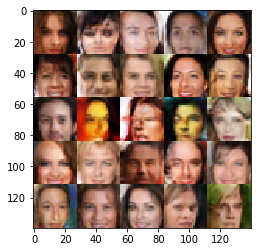

Epoch 2/4... Discriminator Loss: 1.4499... Generator Loss: 0.5053
Epoch 2/4... Discriminator Loss: 1.4329... Generator Loss: 0.4914
Epoch 2/4... Discriminator Loss: 0.9901... Generator Loss: 1.4150
Epoch 2/4... Discriminator Loss: 0.8219... Generator Loss: 1.2466
Epoch 2/4... Discriminator Loss: 1.1123... Generator Loss: 0.7124
Epoch 2/4... Discriminator Loss: 0.8789... Generator Loss: 1.1169
Epoch 2/4... Discriminator Loss: 1.0576... Generator Loss: 0.7678
Epoch 2/4... Discriminator Loss: 0.9955... Generator Loss: 0.9506
Epoch 2/4... Discriminator Loss: 1.1162... Generator Loss: 1.5144
Epoch 2/4... Discriminator Loss: 0.7022... Generator Loss: 1.5936


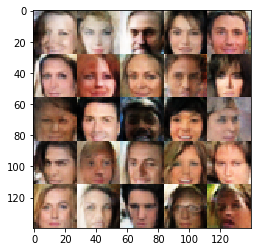

Epoch 2/4... Discriminator Loss: 0.8967... Generator Loss: 1.1320
Epoch 2/4... Discriminator Loss: 1.0522... Generator Loss: 1.0710
Epoch 2/4... Discriminator Loss: 0.9925... Generator Loss: 0.8980
Epoch 2/4... Discriminator Loss: 0.7324... Generator Loss: 1.4890
Epoch 2/4... Discriminator Loss: 1.0573... Generator Loss: 1.7087
Epoch 2/4... Discriminator Loss: 1.6206... Generator Loss: 0.3951
Epoch 2/4... Discriminator Loss: 1.0995... Generator Loss: 0.7206
Epoch 2/4... Discriminator Loss: 0.6592... Generator Loss: 1.6056
Epoch 2/4... Discriminator Loss: 0.9843... Generator Loss: 0.8692
Epoch 2/4... Discriminator Loss: 1.3117... Generator Loss: 1.7511


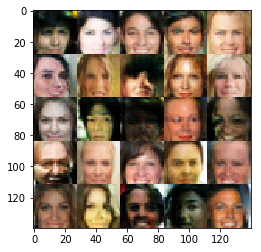

Epoch 2/4... Discriminator Loss: 0.9385... Generator Loss: 1.4794
Epoch 2/4... Discriminator Loss: 1.3830... Generator Loss: 0.5414
Epoch 2/4... Discriminator Loss: 1.1819... Generator Loss: 0.6300
Epoch 2/4... Discriminator Loss: 0.7558... Generator Loss: 1.3808
Epoch 2/4... Discriminator Loss: 1.0843... Generator Loss: 0.7311
Epoch 2/4... Discriminator Loss: 0.8758... Generator Loss: 1.0557
Epoch 2/4... Discriminator Loss: 0.8979... Generator Loss: 1.0316
Epoch 2/4... Discriminator Loss: 0.7286... Generator Loss: 1.7049
Epoch 2/4... Discriminator Loss: 0.9256... Generator Loss: 1.1207
Epoch 2/4... Discriminator Loss: 0.8043... Generator Loss: 1.2418


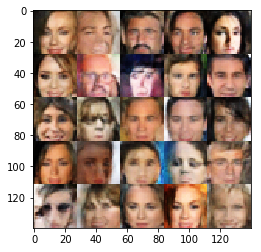

Epoch 2/4... Discriminator Loss: 0.7232... Generator Loss: 1.4901
Epoch 2/4... Discriminator Loss: 1.2265... Generator Loss: 0.6140
Epoch 2/4... Discriminator Loss: 1.4157... Generator Loss: 0.5285
Epoch 2/4... Discriminator Loss: 1.4849... Generator Loss: 0.4361
Epoch 2/4... Discriminator Loss: 0.9844... Generator Loss: 0.9221
Epoch 2/4... Discriminator Loss: 0.8101... Generator Loss: 1.2841
Epoch 2/4... Discriminator Loss: 1.0505... Generator Loss: 0.8771
Epoch 2/4... Discriminator Loss: 0.8956... Generator Loss: 0.9640
Epoch 2/4... Discriminator Loss: 1.0341... Generator Loss: 1.2370
Epoch 2/4... Discriminator Loss: 0.8625... Generator Loss: 1.1653


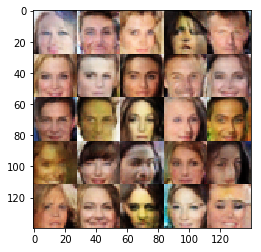

Epoch 2/4... Discriminator Loss: 1.3205... Generator Loss: 0.5192
Epoch 2/4... Discriminator Loss: 0.9615... Generator Loss: 1.1297
Epoch 2/4... Discriminator Loss: 1.4686... Generator Loss: 0.4721
Epoch 2/4... Discriminator Loss: 0.9258... Generator Loss: 0.9703
Epoch 2/4... Discriminator Loss: 0.9740... Generator Loss: 0.9845
Epoch 2/4... Discriminator Loss: 0.9261... Generator Loss: 0.9433
Epoch 2/4... Discriminator Loss: 0.8248... Generator Loss: 1.7883
Epoch 2/4... Discriminator Loss: 1.6889... Generator Loss: 0.3422
Epoch 2/4... Discriminator Loss: 0.8158... Generator Loss: 1.2147
Epoch 2/4... Discriminator Loss: 1.2781... Generator Loss: 0.5614


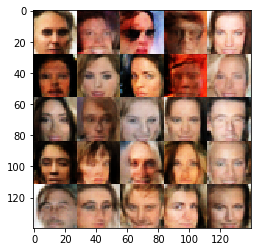

Epoch 2/4... Discriminator Loss: 0.8547... Generator Loss: 1.1072
Epoch 2/4... Discriminator Loss: 1.3787... Generator Loss: 0.4812
Epoch 2/4... Discriminator Loss: 0.7069... Generator Loss: 1.5382
Epoch 2/4... Discriminator Loss: 0.9209... Generator Loss: 1.8307
Epoch 2/4... Discriminator Loss: 0.8765... Generator Loss: 1.5940
Epoch 2/4... Discriminator Loss: 0.8406... Generator Loss: 1.2231
Epoch 2/4... Discriminator Loss: 1.2682... Generator Loss: 0.5904
Epoch 2/4... Discriminator Loss: 0.9789... Generator Loss: 0.9042
Epoch 2/4... Discriminator Loss: 0.9141... Generator Loss: 1.8652
Epoch 2/4... Discriminator Loss: 0.9423... Generator Loss: 1.0589


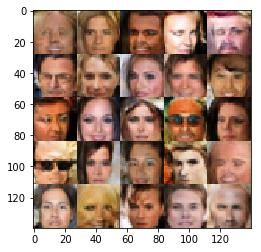

Epoch 2/4... Discriminator Loss: 1.0519... Generator Loss: 0.7888
Epoch 2/4... Discriminator Loss: 1.0229... Generator Loss: 0.9737
Epoch 2/4... Discriminator Loss: 0.7394... Generator Loss: 1.2952
Epoch 2/4... Discriminator Loss: 1.2214... Generator Loss: 0.6090
Epoch 2/4... Discriminator Loss: 1.0648... Generator Loss: 0.7515
Epoch 2/4... Discriminator Loss: 0.9016... Generator Loss: 1.0446
Epoch 2/4... Discriminator Loss: 1.0543... Generator Loss: 0.8442
Epoch 2/4... Discriminator Loss: 0.7685... Generator Loss: 1.5641
Epoch 2/4... Discriminator Loss: 0.7896... Generator Loss: 1.6598
Epoch 2/4... Discriminator Loss: 0.6775... Generator Loss: 1.8913


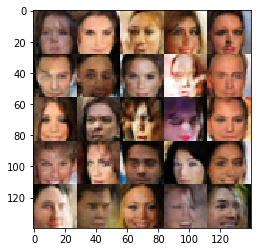

Epoch 2/4... Discriminator Loss: 1.0573... Generator Loss: 0.7387
Epoch 2/4... Discriminator Loss: 0.7063... Generator Loss: 1.4112
Epoch 2/4... Discriminator Loss: 0.9535... Generator Loss: 1.0150
Epoch 2/4... Discriminator Loss: 0.9722... Generator Loss: 1.0947
Epoch 2/4... Discriminator Loss: 0.9351... Generator Loss: 1.0440
Epoch 2/4... Discriminator Loss: 1.2659... Generator Loss: 0.6206
Epoch 2/4... Discriminator Loss: 1.4212... Generator Loss: 0.4753
Epoch 2/4... Discriminator Loss: 0.9102... Generator Loss: 1.1877
Epoch 2/4... Discriminator Loss: 0.7944... Generator Loss: 1.8240
Epoch 2/4... Discriminator Loss: 1.2344... Generator Loss: 0.5903


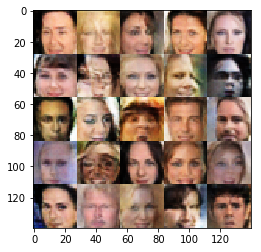

Epoch 2/4... Discriminator Loss: 0.9833... Generator Loss: 0.9167
Epoch 2/4... Discriminator Loss: 0.7573... Generator Loss: 1.3782
Epoch 2/4... Discriminator Loss: 0.8775... Generator Loss: 1.6028
Epoch 2/4... Discriminator Loss: 0.9644... Generator Loss: 0.9072
Epoch 2/4... Discriminator Loss: 0.9311... Generator Loss: 0.9801
Epoch 2/4... Discriminator Loss: 0.6559... Generator Loss: 1.5923
Epoch 2/4... Discriminator Loss: 0.8807... Generator Loss: 1.1420
Epoch 2/4... Discriminator Loss: 0.9118... Generator Loss: 1.7003
Epoch 2/4... Discriminator Loss: 0.9960... Generator Loss: 1.1038
Epoch 2/4... Discriminator Loss: 0.8394... Generator Loss: 1.1337


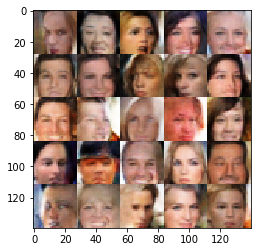

Epoch 2/4... Discriminator Loss: 1.2763... Generator Loss: 0.5877
Epoch 2/4... Discriminator Loss: 0.9874... Generator Loss: 2.2725
Epoch 2/4... Discriminator Loss: 0.9478... Generator Loss: 1.0735
Epoch 2/4... Discriminator Loss: 1.2579... Generator Loss: 0.5988
Epoch 2/4... Discriminator Loss: 1.0395... Generator Loss: 0.7624
Epoch 2/4... Discriminator Loss: 1.3075... Generator Loss: 0.5563
Epoch 2/4... Discriminator Loss: 0.9936... Generator Loss: 1.3023
Epoch 2/4... Discriminator Loss: 1.0353... Generator Loss: 0.8224
Epoch 2/4... Discriminator Loss: 1.1395... Generator Loss: 0.7236
Epoch 2/4... Discriminator Loss: 1.4063... Generator Loss: 0.4739


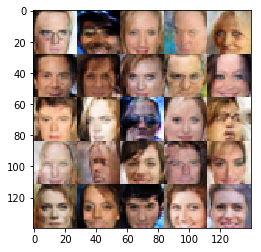

Epoch 2/4... Discriminator Loss: 1.1184... Generator Loss: 0.7688
Epoch 2/4... Discriminator Loss: 1.1926... Generator Loss: 0.6215
Epoch 2/4... Discriminator Loss: 0.7153... Generator Loss: 1.5219
Epoch 2/4... Discriminator Loss: 0.9491... Generator Loss: 0.9309
Epoch 2/4... Discriminator Loss: 0.8102... Generator Loss: 1.3560
Epoch 2/4... Discriminator Loss: 0.7614... Generator Loss: 1.5456
Epoch 2/4... Discriminator Loss: 0.8016... Generator Loss: 1.1385
Epoch 2/4... Discriminator Loss: 1.0605... Generator Loss: 0.7702
Epoch 2/4... Discriminator Loss: 0.8311... Generator Loss: 1.1720
Epoch 2/4... Discriminator Loss: 0.8884... Generator Loss: 1.0536


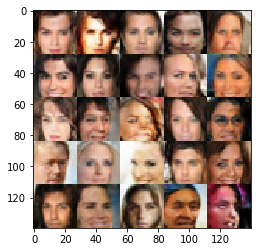

Epoch 2/4... Discriminator Loss: 0.9776... Generator Loss: 0.9415
Epoch 2/4... Discriminator Loss: 0.7535... Generator Loss: 1.5022
Epoch 2/4... Discriminator Loss: 0.8479... Generator Loss: 1.2791
Epoch 2/4... Discriminator Loss: 0.9934... Generator Loss: 2.0323
Epoch 2/4... Discriminator Loss: 0.8347... Generator Loss: 1.0920
Epoch 2/4... Discriminator Loss: 0.9391... Generator Loss: 0.9857
Epoch 2/4... Discriminator Loss: 0.8591... Generator Loss: 1.1001
Epoch 2/4... Discriminator Loss: 0.9634... Generator Loss: 1.0602
Epoch 2/4... Discriminator Loss: 0.8663... Generator Loss: 1.1846
Epoch 2/4... Discriminator Loss: 0.7789... Generator Loss: 1.4434


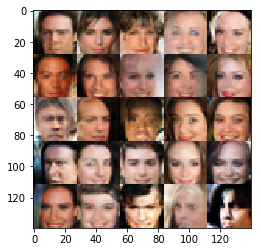

Epoch 2/4... Discriminator Loss: 0.9371... Generator Loss: 1.2031
Epoch 2/4... Discriminator Loss: 0.9132... Generator Loss: 1.5625
Epoch 2/4... Discriminator Loss: 0.9399... Generator Loss: 0.9622
Epoch 2/4... Discriminator Loss: 1.3365... Generator Loss: 0.5333
Epoch 2/4... Discriminator Loss: 0.8657... Generator Loss: 1.2906
Epoch 2/4... Discriminator Loss: 0.9077... Generator Loss: 1.0166
Epoch 2/4... Discriminator Loss: 0.9600... Generator Loss: 0.9639
Epoch 2/4... Discriminator Loss: 1.0221... Generator Loss: 0.8608
Epoch 2/4... Discriminator Loss: 1.0011... Generator Loss: 0.8527
Epoch 2/4... Discriminator Loss: 1.2586... Generator Loss: 0.6051


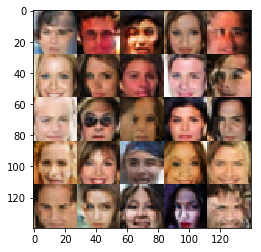

Epoch 2/4... Discriminator Loss: 0.8750... Generator Loss: 1.0636
Epoch 2/4... Discriminator Loss: 0.9798... Generator Loss: 0.9013
Epoch 2/4... Discriminator Loss: 0.8222... Generator Loss: 1.7552
Epoch 2/4... Discriminator Loss: 0.8443... Generator Loss: 1.3572
Epoch 2/4... Discriminator Loss: 0.9809... Generator Loss: 1.0544
Epoch 2/4... Discriminator Loss: 0.9716... Generator Loss: 0.9373
Epoch 2/4... Discriminator Loss: 0.9068... Generator Loss: 0.9832
Epoch 2/4... Discriminator Loss: 0.9248... Generator Loss: 0.9829
Epoch 2/4... Discriminator Loss: 0.7438... Generator Loss: 1.4199
Epoch 2/4... Discriminator Loss: 0.7685... Generator Loss: 2.0928


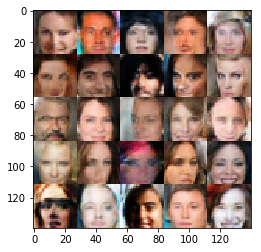

Epoch 2/4... Discriminator Loss: 1.0291... Generator Loss: 0.7555
Epoch 2/4... Discriminator Loss: 0.9273... Generator Loss: 0.9835
Epoch 2/4... Discriminator Loss: 0.8927... Generator Loss: 0.9616
Epoch 2/4... Discriminator Loss: 0.7089... Generator Loss: 1.4947
Epoch 2/4... Discriminator Loss: 0.8972... Generator Loss: 1.0758
Epoch 2/4... Discriminator Loss: 1.0371... Generator Loss: 0.8059
Epoch 2/4... Discriminator Loss: 0.9770... Generator Loss: 0.8628
Epoch 2/4... Discriminator Loss: 0.7900... Generator Loss: 1.2138
Epoch 2/4... Discriminator Loss: 1.1649... Generator Loss: 0.6985
Epoch 2/4... Discriminator Loss: 1.0362... Generator Loss: 2.5888


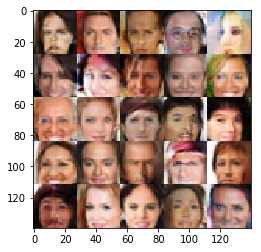

Epoch 2/4... Discriminator Loss: 1.1080... Generator Loss: 0.7486
Epoch 2/4... Discriminator Loss: 1.0177... Generator Loss: 0.8341
Epoch 2/4... Discriminator Loss: 0.8668... Generator Loss: 1.0624
Epoch 2/4... Discriminator Loss: 0.9186... Generator Loss: 0.9538
Epoch 2/4... Discriminator Loss: 1.0246... Generator Loss: 0.8158
Epoch 2/4... Discriminator Loss: 0.9371... Generator Loss: 0.9983
Epoch 3/4... Discriminator Loss: 0.8259... Generator Loss: 1.2014
Epoch 3/4... Discriminator Loss: 1.1981... Generator Loss: 0.6519
Epoch 3/4... Discriminator Loss: 1.0543... Generator Loss: 0.8420
Epoch 3/4... Discriminator Loss: 0.8728... Generator Loss: 1.3002


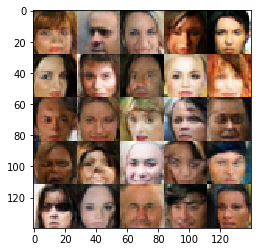

Epoch 3/4... Discriminator Loss: 0.9965... Generator Loss: 0.9168
Epoch 3/4... Discriminator Loss: 0.8466... Generator Loss: 1.3440
Epoch 3/4... Discriminator Loss: 0.9556... Generator Loss: 0.9010
Epoch 3/4... Discriminator Loss: 0.7353... Generator Loss: 1.4305
Epoch 3/4... Discriminator Loss: 0.6701... Generator Loss: 1.6619
Epoch 3/4... Discriminator Loss: 0.8041... Generator Loss: 1.3761
Epoch 3/4... Discriminator Loss: 1.1162... Generator Loss: 0.7292
Epoch 3/4... Discriminator Loss: 0.9882... Generator Loss: 1.0315
Epoch 3/4... Discriminator Loss: 1.0497... Generator Loss: 0.7439
Epoch 3/4... Discriminator Loss: 0.7748... Generator Loss: 1.7161


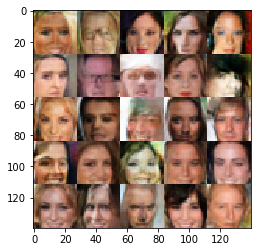

Epoch 3/4... Discriminator Loss: 0.7796... Generator Loss: 1.4457
Epoch 3/4... Discriminator Loss: 0.7487... Generator Loss: 1.3831
Epoch 3/4... Discriminator Loss: 0.6996... Generator Loss: 1.4140
Epoch 3/4... Discriminator Loss: 0.6944... Generator Loss: 1.8299
Epoch 3/4... Discriminator Loss: 0.9044... Generator Loss: 1.1362
Epoch 3/4... Discriminator Loss: 0.8226... Generator Loss: 1.2006
Epoch 3/4... Discriminator Loss: 1.1087... Generator Loss: 1.7759
Epoch 3/4... Discriminator Loss: 0.9288... Generator Loss: 2.2921
Epoch 3/4... Discriminator Loss: 0.9056... Generator Loss: 1.3412
Epoch 3/4... Discriminator Loss: 1.1453... Generator Loss: 0.7931


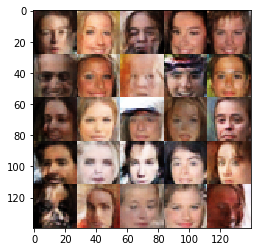

Epoch 3/4... Discriminator Loss: 0.9270... Generator Loss: 0.9808
Epoch 3/4... Discriminator Loss: 1.1400... Generator Loss: 0.7354
Epoch 3/4... Discriminator Loss: 0.7373... Generator Loss: 1.6288
Epoch 3/4... Discriminator Loss: 1.0679... Generator Loss: 0.8141
Epoch 3/4... Discriminator Loss: 0.7415... Generator Loss: 1.4459
Epoch 3/4... Discriminator Loss: 1.0246... Generator Loss: 0.7997
Epoch 3/4... Discriminator Loss: 0.7686... Generator Loss: 1.4518
Epoch 3/4... Discriminator Loss: 0.8700... Generator Loss: 1.1562
Epoch 3/4... Discriminator Loss: 0.8459... Generator Loss: 1.1608
Epoch 3/4... Discriminator Loss: 1.1194... Generator Loss: 0.7337


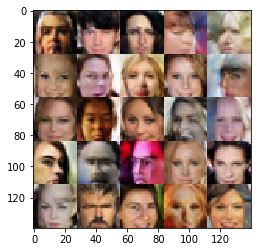

Epoch 3/4... Discriminator Loss: 1.0263... Generator Loss: 1.1389
Epoch 3/4... Discriminator Loss: 1.5089... Generator Loss: 0.4266
Epoch 3/4... Discriminator Loss: 1.4141... Generator Loss: 0.4735
Epoch 3/4... Discriminator Loss: 0.8768... Generator Loss: 1.0535
Epoch 3/4... Discriminator Loss: 0.9059... Generator Loss: 1.0147
Epoch 3/4... Discriminator Loss: 1.3727... Generator Loss: 0.4966
Epoch 3/4... Discriminator Loss: 0.7480... Generator Loss: 1.3422
Epoch 3/4... Discriminator Loss: 1.3982... Generator Loss: 0.5067
Epoch 3/4... Discriminator Loss: 1.0412... Generator Loss: 0.8186
Epoch 3/4... Discriminator Loss: 0.9132... Generator Loss: 1.0527


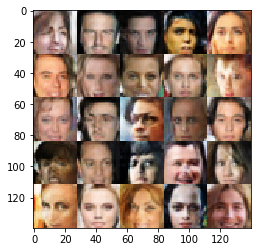

Epoch 3/4... Discriminator Loss: 1.2543... Generator Loss: 0.6117
Epoch 3/4... Discriminator Loss: 1.3118... Generator Loss: 0.5649
Epoch 3/4... Discriminator Loss: 1.0254... Generator Loss: 0.9296
Epoch 3/4... Discriminator Loss: 0.8885... Generator Loss: 1.2406
Epoch 3/4... Discriminator Loss: 0.7941... Generator Loss: 1.1532
Epoch 3/4... Discriminator Loss: 0.9791... Generator Loss: 1.8442
Epoch 3/4... Discriminator Loss: 0.9750... Generator Loss: 1.3652
Epoch 3/4... Discriminator Loss: 1.1023... Generator Loss: 0.7792
Epoch 3/4... Discriminator Loss: 0.9434... Generator Loss: 0.9538
Epoch 3/4... Discriminator Loss: 1.1621... Generator Loss: 0.7386


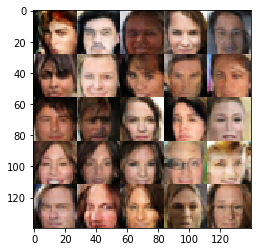

Epoch 3/4... Discriminator Loss: 1.5017... Generator Loss: 0.4373
Epoch 3/4... Discriminator Loss: 0.9022... Generator Loss: 0.9813
Epoch 3/4... Discriminator Loss: 0.7913... Generator Loss: 1.2148
Epoch 3/4... Discriminator Loss: 0.9889... Generator Loss: 0.8717
Epoch 3/4... Discriminator Loss: 1.0512... Generator Loss: 0.7892
Epoch 3/4... Discriminator Loss: 0.9806... Generator Loss: 1.9599
Epoch 3/4... Discriminator Loss: 1.2734... Generator Loss: 0.5676
Epoch 3/4... Discriminator Loss: 0.7244... Generator Loss: 2.0994
Epoch 3/4... Discriminator Loss: 0.7360... Generator Loss: 1.4543
Epoch 3/4... Discriminator Loss: 0.8521... Generator Loss: 1.0934


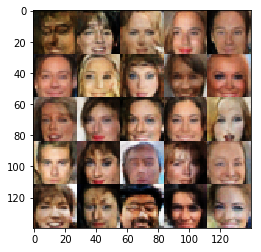

Epoch 3/4... Discriminator Loss: 1.1391... Generator Loss: 0.7609
Epoch 3/4... Discriminator Loss: 0.9514... Generator Loss: 0.9556
Epoch 3/4... Discriminator Loss: 0.6092... Generator Loss: 2.2177
Epoch 3/4... Discriminator Loss: 0.7920... Generator Loss: 1.3948
Epoch 3/4... Discriminator Loss: 0.8247... Generator Loss: 1.3364
Epoch 3/4... Discriminator Loss: 0.6407... Generator Loss: 2.3007
Epoch 3/4... Discriminator Loss: 0.8042... Generator Loss: 1.6589
Epoch 3/4... Discriminator Loss: 0.7988... Generator Loss: 1.5761
Epoch 3/4... Discriminator Loss: 1.1097... Generator Loss: 0.8128
Epoch 3/4... Discriminator Loss: 1.4744... Generator Loss: 0.4972


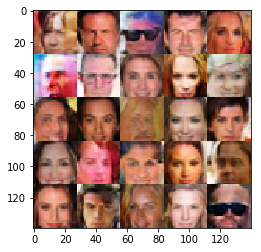

Epoch 3/4... Discriminator Loss: 0.9327... Generator Loss: 1.0972
Epoch 3/4... Discriminator Loss: 0.9263... Generator Loss: 1.4371
Epoch 3/4... Discriminator Loss: 0.8033... Generator Loss: 1.5723
Epoch 3/4... Discriminator Loss: 0.6983... Generator Loss: 1.4315
Epoch 3/4... Discriminator Loss: 0.9226... Generator Loss: 1.1420
Epoch 3/4... Discriminator Loss: 0.8693... Generator Loss: 1.1034
Epoch 3/4... Discriminator Loss: 1.0453... Generator Loss: 1.3088
Epoch 3/4... Discriminator Loss: 0.8143... Generator Loss: 1.2083
Epoch 3/4... Discriminator Loss: 0.9181... Generator Loss: 1.1266
Epoch 3/4... Discriminator Loss: 1.3370... Generator Loss: 0.4977


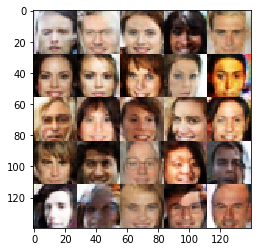

Epoch 3/4... Discriminator Loss: 0.7958... Generator Loss: 1.6865
Epoch 3/4... Discriminator Loss: 1.6288... Generator Loss: 0.4108
Epoch 3/4... Discriminator Loss: 0.7234... Generator Loss: 1.8270
Epoch 3/4... Discriminator Loss: 1.0260... Generator Loss: 0.8619
Epoch 3/4... Discriminator Loss: 1.1349... Generator Loss: 0.7655
Epoch 3/4... Discriminator Loss: 0.8487... Generator Loss: 1.2170
Epoch 3/4... Discriminator Loss: 0.8090... Generator Loss: 2.6501
Epoch 3/4... Discriminator Loss: 0.9413... Generator Loss: 2.1963
Epoch 3/4... Discriminator Loss: 1.0451... Generator Loss: 0.7800
Epoch 3/4... Discriminator Loss: 1.2112... Generator Loss: 0.6474


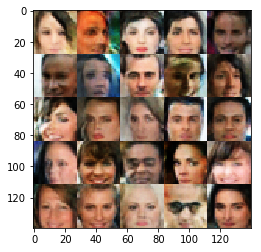

Epoch 3/4... Discriminator Loss: 0.8997... Generator Loss: 1.5341
Epoch 3/4... Discriminator Loss: 0.8992... Generator Loss: 0.9941
Epoch 3/4... Discriminator Loss: 0.6249... Generator Loss: 1.8465
Epoch 3/4... Discriminator Loss: 1.5933... Generator Loss: 0.3907
Epoch 3/4... Discriminator Loss: 0.8832... Generator Loss: 1.0600
Epoch 3/4... Discriminator Loss: 0.9996... Generator Loss: 0.8482
Epoch 3/4... Discriminator Loss: 0.8684... Generator Loss: 1.1907
Epoch 3/4... Discriminator Loss: 0.7861... Generator Loss: 1.7151
Epoch 3/4... Discriminator Loss: 0.8351... Generator Loss: 1.1741
Epoch 3/4... Discriminator Loss: 0.7280... Generator Loss: 1.3976


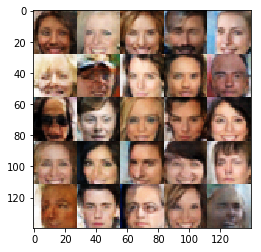

Epoch 3/4... Discriminator Loss: 0.9113... Generator Loss: 1.1400
Epoch 3/4... Discriminator Loss: 0.9894... Generator Loss: 0.8952
Epoch 3/4... Discriminator Loss: 0.6485... Generator Loss: 1.7734
Epoch 3/4... Discriminator Loss: 0.8307... Generator Loss: 1.1769
Epoch 3/4... Discriminator Loss: 0.9632... Generator Loss: 0.8815
Epoch 3/4... Discriminator Loss: 0.9358... Generator Loss: 0.9385
Epoch 3/4... Discriminator Loss: 0.8464... Generator Loss: 1.0829
Epoch 3/4... Discriminator Loss: 0.8971... Generator Loss: 1.0284
Epoch 3/4... Discriminator Loss: 0.8135... Generator Loss: 1.4291
Epoch 3/4... Discriminator Loss: 0.9183... Generator Loss: 1.0340


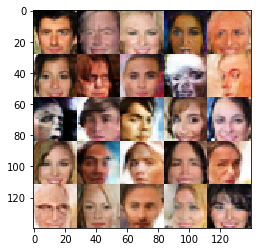

Epoch 3/4... Discriminator Loss: 0.9440... Generator Loss: 0.9692
Epoch 3/4... Discriminator Loss: 1.2904... Generator Loss: 0.6057
Epoch 3/4... Discriminator Loss: 1.1095... Generator Loss: 0.7337
Epoch 3/4... Discriminator Loss: 0.9043... Generator Loss: 1.0156
Epoch 3/4... Discriminator Loss: 0.9830... Generator Loss: 0.9489
Epoch 3/4... Discriminator Loss: 0.9236... Generator Loss: 1.4034
Epoch 3/4... Discriminator Loss: 1.0317... Generator Loss: 0.8988
Epoch 3/4... Discriminator Loss: 0.7331... Generator Loss: 2.1975
Epoch 3/4... Discriminator Loss: 1.0417... Generator Loss: 0.8309
Epoch 3/4... Discriminator Loss: 0.7869... Generator Loss: 1.7740


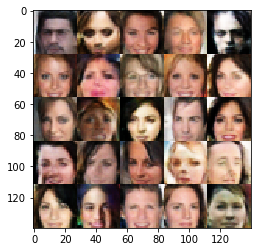

Epoch 3/4... Discriminator Loss: 0.6984... Generator Loss: 1.5400
Epoch 3/4... Discriminator Loss: 1.7485... Generator Loss: 0.3396
Epoch 3/4... Discriminator Loss: 0.9870... Generator Loss: 0.9688
Epoch 3/4... Discriminator Loss: 1.0971... Generator Loss: 0.8165
Epoch 3/4... Discriminator Loss: 1.2058... Generator Loss: 0.6618
Epoch 3/4... Discriminator Loss: 0.7212... Generator Loss: 1.5122
Epoch 3/4... Discriminator Loss: 0.7878... Generator Loss: 1.5712
Epoch 3/4... Discriminator Loss: 0.8416... Generator Loss: 1.7305
Epoch 3/4... Discriminator Loss: 0.9440... Generator Loss: 1.0026
Epoch 3/4... Discriminator Loss: 0.8294... Generator Loss: 1.0710


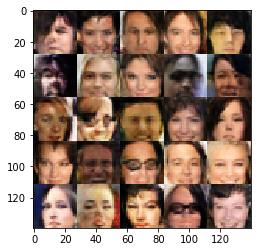

Epoch 3/4... Discriminator Loss: 0.8487... Generator Loss: 1.2392
Epoch 3/4... Discriminator Loss: 0.6800... Generator Loss: 1.4707
Epoch 3/4... Discriminator Loss: 0.8393... Generator Loss: 1.0628
Epoch 3/4... Discriminator Loss: 0.7082... Generator Loss: 1.5408
Epoch 3/4... Discriminator Loss: 1.1038... Generator Loss: 0.7932
Epoch 3/4... Discriminator Loss: 0.8903... Generator Loss: 1.8652
Epoch 3/4... Discriminator Loss: 1.2565... Generator Loss: 0.5864
Epoch 3/4... Discriminator Loss: 1.3122... Generator Loss: 0.5476
Epoch 3/4... Discriminator Loss: 0.9735... Generator Loss: 1.7637
Epoch 3/4... Discriminator Loss: 1.1342... Generator Loss: 0.7081


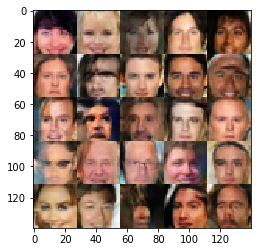

Epoch 3/4... Discriminator Loss: 1.1450... Generator Loss: 0.7001
Epoch 3/4... Discriminator Loss: 0.8395... Generator Loss: 2.3330
Epoch 3/4... Discriminator Loss: 0.9622... Generator Loss: 1.0247
Epoch 3/4... Discriminator Loss: 1.3075... Generator Loss: 0.5600
Epoch 3/4... Discriminator Loss: 0.7752... Generator Loss: 1.2943
Epoch 3/4... Discriminator Loss: 0.9945... Generator Loss: 0.9084
Epoch 3/4... Discriminator Loss: 1.0829... Generator Loss: 0.7679
Epoch 3/4... Discriminator Loss: 0.8523... Generator Loss: 1.2677
Epoch 3/4... Discriminator Loss: 0.9249... Generator Loss: 1.2458
Epoch 3/4... Discriminator Loss: 1.5327... Generator Loss: 0.4199


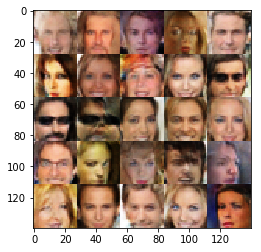

Epoch 3/4... Discriminator Loss: 1.1516... Generator Loss: 0.6964
Epoch 3/4... Discriminator Loss: 1.3010... Generator Loss: 0.5675
Epoch 3/4... Discriminator Loss: 1.1441... Generator Loss: 0.7372
Epoch 3/4... Discriminator Loss: 0.9902... Generator Loss: 1.1635
Epoch 3/4... Discriminator Loss: 1.5944... Generator Loss: 0.4050
Epoch 3/4... Discriminator Loss: 1.1358... Generator Loss: 0.7500
Epoch 3/4... Discriminator Loss: 0.9164... Generator Loss: 0.9863
Epoch 3/4... Discriminator Loss: 0.7877... Generator Loss: 1.3557
Epoch 3/4... Discriminator Loss: 1.0269... Generator Loss: 0.9154
Epoch 3/4... Discriminator Loss: 0.8743... Generator Loss: 1.2487


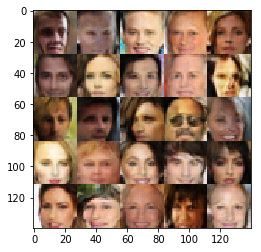

Epoch 3/4... Discriminator Loss: 1.4915... Generator Loss: 0.4508
Epoch 3/4... Discriminator Loss: 0.7692... Generator Loss: 1.2798
Epoch 3/4... Discriminator Loss: 0.9468... Generator Loss: 0.9167
Epoch 3/4... Discriminator Loss: 0.9555... Generator Loss: 0.9283
Epoch 3/4... Discriminator Loss: 1.4488... Generator Loss: 0.4780
Epoch 3/4... Discriminator Loss: 0.6343... Generator Loss: 1.8477
Epoch 3/4... Discriminator Loss: 0.9789... Generator Loss: 1.0424
Epoch 3/4... Discriminator Loss: 0.8206... Generator Loss: 1.5554
Epoch 3/4... Discriminator Loss: 1.0567... Generator Loss: 0.8587
Epoch 3/4... Discriminator Loss: 1.0041... Generator Loss: 0.8563


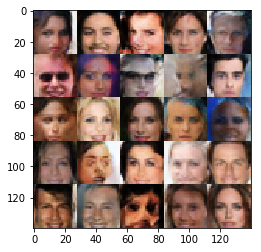

Epoch 3/4... Discriminator Loss: 0.9030... Generator Loss: 1.3581
Epoch 3/4... Discriminator Loss: 0.8162... Generator Loss: 1.3985
Epoch 3/4... Discriminator Loss: 0.9233... Generator Loss: 0.9413
Epoch 3/4... Discriminator Loss: 0.9203... Generator Loss: 1.1083
Epoch 3/4... Discriminator Loss: 0.9900... Generator Loss: 1.0126
Epoch 3/4... Discriminator Loss: 0.8912... Generator Loss: 1.0707
Epoch 3/4... Discriminator Loss: 0.9636... Generator Loss: 0.9386
Epoch 3/4... Discriminator Loss: 0.9420... Generator Loss: 0.9467
Epoch 3/4... Discriminator Loss: 0.8433... Generator Loss: 1.1868
Epoch 3/4... Discriminator Loss: 0.8997... Generator Loss: 0.9685


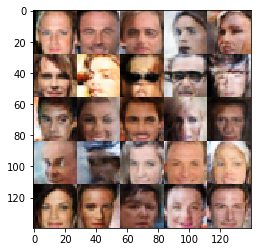

Epoch 3/4... Discriminator Loss: 0.6833... Generator Loss: 1.5745
Epoch 3/4... Discriminator Loss: 1.0442... Generator Loss: 0.8416
Epoch 3/4... Discriminator Loss: 0.9433... Generator Loss: 1.1358
Epoch 3/4... Discriminator Loss: 0.7643... Generator Loss: 1.1951
Epoch 3/4... Discriminator Loss: 0.8635... Generator Loss: 1.2029
Epoch 3/4... Discriminator Loss: 1.8296... Generator Loss: 0.3203
Epoch 3/4... Discriminator Loss: 0.8088... Generator Loss: 1.6511
Epoch 3/4... Discriminator Loss: 1.2047... Generator Loss: 0.6116
Epoch 3/4... Discriminator Loss: 1.0505... Generator Loss: 2.8109
Epoch 3/4... Discriminator Loss: 0.8059... Generator Loss: 1.2213


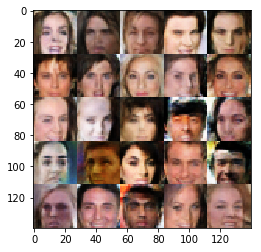

Epoch 3/4... Discriminator Loss: 0.9100... Generator Loss: 1.0320
Epoch 3/4... Discriminator Loss: 0.8828... Generator Loss: 1.4808
Epoch 3/4... Discriminator Loss: 1.6112... Generator Loss: 0.4218
Epoch 3/4... Discriminator Loss: 1.3010... Generator Loss: 0.5848
Epoch 3/4... Discriminator Loss: 1.0789... Generator Loss: 0.7868
Epoch 3/4... Discriminator Loss: 1.0074... Generator Loss: 0.8146
Epoch 3/4... Discriminator Loss: 0.8122... Generator Loss: 1.3590
Epoch 3/4... Discriminator Loss: 1.6152... Generator Loss: 0.4198
Epoch 3/4... Discriminator Loss: 1.3567... Generator Loss: 0.6903
Epoch 3/4... Discriminator Loss: 0.8099... Generator Loss: 1.1466


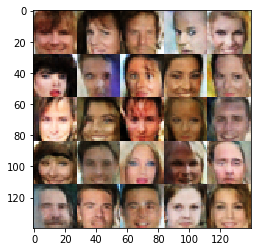

Epoch 3/4... Discriminator Loss: 0.9530... Generator Loss: 0.9577
Epoch 3/4... Discriminator Loss: 0.8741... Generator Loss: 1.3067
Epoch 3/4... Discriminator Loss: 0.9617... Generator Loss: 0.9059
Epoch 3/4... Discriminator Loss: 0.8218... Generator Loss: 1.1608
Epoch 3/4... Discriminator Loss: 1.0747... Generator Loss: 1.0325
Epoch 3/4... Discriminator Loss: 0.8139... Generator Loss: 1.1581
Epoch 3/4... Discriminator Loss: 1.1645... Generator Loss: 0.6551
Epoch 3/4... Discriminator Loss: 0.6557... Generator Loss: 2.0835
Epoch 3/4... Discriminator Loss: 0.9757... Generator Loss: 0.9544
Epoch 3/4... Discriminator Loss: 0.8362... Generator Loss: 1.3301


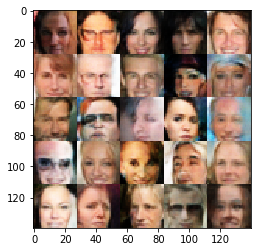

Epoch 3/4... Discriminator Loss: 1.2041... Generator Loss: 0.6427
Epoch 3/4... Discriminator Loss: 0.9646... Generator Loss: 1.4306
Epoch 3/4... Discriminator Loss: 0.9377... Generator Loss: 2.2150
Epoch 3/4... Discriminator Loss: 0.8647... Generator Loss: 1.6803
Epoch 3/4... Discriminator Loss: 0.8005... Generator Loss: 1.2652
Epoch 3/4... Discriminator Loss: 0.7738... Generator Loss: 1.2509
Epoch 3/4... Discriminator Loss: 1.0594... Generator Loss: 0.7505
Epoch 3/4... Discriminator Loss: 1.1517... Generator Loss: 0.7161
Epoch 3/4... Discriminator Loss: 0.7182... Generator Loss: 1.5265
Epoch 3/4... Discriminator Loss: 1.0870... Generator Loss: 0.7491


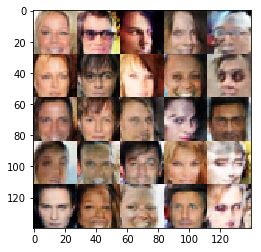

Epoch 3/4... Discriminator Loss: 0.8355... Generator Loss: 1.2282
Epoch 3/4... Discriminator Loss: 0.8937... Generator Loss: 1.0668
Epoch 3/4... Discriminator Loss: 0.9297... Generator Loss: 1.2098
Epoch 3/4... Discriminator Loss: 1.0128... Generator Loss: 0.8884
Epoch 3/4... Discriminator Loss: 0.8134... Generator Loss: 1.6791
Epoch 3/4... Discriminator Loss: 0.9749... Generator Loss: 0.9058
Epoch 3/4... Discriminator Loss: 1.1782... Generator Loss: 0.7636
Epoch 3/4... Discriminator Loss: 0.8763... Generator Loss: 1.1084
Epoch 3/4... Discriminator Loss: 0.6978... Generator Loss: 1.3898
Epoch 3/4... Discriminator Loss: 1.3241... Generator Loss: 0.5225


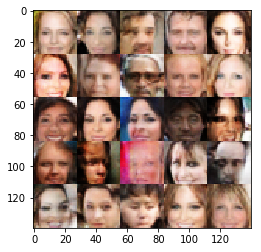

Epoch 3/4... Discriminator Loss: 1.0735... Generator Loss: 0.8726
Epoch 3/4... Discriminator Loss: 0.9659... Generator Loss: 1.7269
Epoch 3/4... Discriminator Loss: 0.7955... Generator Loss: 1.2861
Epoch 3/4... Discriminator Loss: 1.1479... Generator Loss: 0.6869
Epoch 3/4... Discriminator Loss: 1.1231... Generator Loss: 0.6857
Epoch 3/4... Discriminator Loss: 0.8726... Generator Loss: 1.0946
Epoch 3/4... Discriminator Loss: 0.7543... Generator Loss: 1.6702
Epoch 3/4... Discriminator Loss: 1.0130... Generator Loss: 0.9369
Epoch 3/4... Discriminator Loss: 0.7342... Generator Loss: 1.4649
Epoch 3/4... Discriminator Loss: 1.3256... Generator Loss: 0.5436


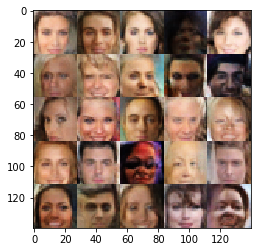

Epoch 3/4... Discriminator Loss: 1.3493... Generator Loss: 0.5774
Epoch 3/4... Discriminator Loss: 0.8770... Generator Loss: 1.1435
Epoch 3/4... Discriminator Loss: 0.9650... Generator Loss: 1.3757
Epoch 3/4... Discriminator Loss: 1.0993... Generator Loss: 0.7397
Epoch 3/4... Discriminator Loss: 0.9830... Generator Loss: 1.0446
Epoch 3/4... Discriminator Loss: 0.9725... Generator Loss: 0.9397
Epoch 3/4... Discriminator Loss: 0.7946... Generator Loss: 1.6151
Epoch 3/4... Discriminator Loss: 0.7782... Generator Loss: 1.9066
Epoch 3/4... Discriminator Loss: 0.9784... Generator Loss: 1.0283
Epoch 3/4... Discriminator Loss: 0.6564... Generator Loss: 1.8902


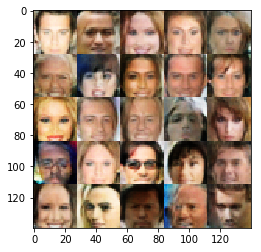

Epoch 3/4... Discriminator Loss: 0.9510... Generator Loss: 0.9415
Epoch 3/4... Discriminator Loss: 0.9695... Generator Loss: 0.8291
Epoch 3/4... Discriminator Loss: 0.9684... Generator Loss: 1.1095
Epoch 3/4... Discriminator Loss: 1.2106... Generator Loss: 0.6095
Epoch 3/4... Discriminator Loss: 0.9063... Generator Loss: 1.4421
Epoch 3/4... Discriminator Loss: 1.0754... Generator Loss: 0.7795
Epoch 3/4... Discriminator Loss: 1.0940... Generator Loss: 0.6897
Epoch 3/4... Discriminator Loss: 0.7651... Generator Loss: 1.3573
Epoch 3/4... Discriminator Loss: 0.5717... Generator Loss: 1.9946
Epoch 3/4... Discriminator Loss: 0.8176... Generator Loss: 1.3762


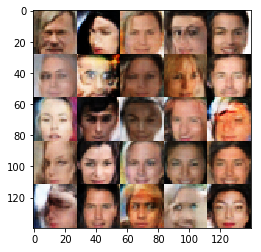

Epoch 3/4... Discriminator Loss: 0.9470... Generator Loss: 1.0294
Epoch 3/4... Discriminator Loss: 0.8868... Generator Loss: 1.7757
Epoch 3/4... Discriminator Loss: 0.7588... Generator Loss: 1.4023
Epoch 3/4... Discriminator Loss: 1.3600... Generator Loss: 0.5254
Epoch 3/4... Discriminator Loss: 1.0954... Generator Loss: 0.7323
Epoch 3/4... Discriminator Loss: 0.9524... Generator Loss: 0.9546
Epoch 3/4... Discriminator Loss: 0.8523... Generator Loss: 1.1582
Epoch 3/4... Discriminator Loss: 0.7809... Generator Loss: 1.3918
Epoch 3/4... Discriminator Loss: 1.0165... Generator Loss: 0.7737
Epoch 3/4... Discriminator Loss: 1.0093... Generator Loss: 1.2611


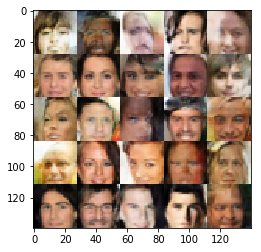

Epoch 3/4... Discriminator Loss: 0.7560... Generator Loss: 1.3265
Epoch 3/4... Discriminator Loss: 0.9581... Generator Loss: 1.3901
Epoch 3/4... Discriminator Loss: 0.8883... Generator Loss: 1.0016
Epoch 3/4... Discriminator Loss: 0.7553... Generator Loss: 1.4695
Epoch 3/4... Discriminator Loss: 0.9097... Generator Loss: 1.1478
Epoch 3/4... Discriminator Loss: 1.3082... Generator Loss: 0.5558
Epoch 3/4... Discriminator Loss: 0.7515... Generator Loss: 1.7662
Epoch 3/4... Discriminator Loss: 0.6602... Generator Loss: 1.7227
Epoch 3/4... Discriminator Loss: 0.8070... Generator Loss: 1.5472
Epoch 3/4... Discriminator Loss: 0.8957... Generator Loss: 1.6159


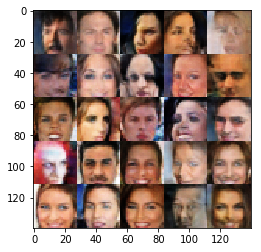

Epoch 3/4... Discriminator Loss: 0.8746... Generator Loss: 1.1884
Epoch 3/4... Discriminator Loss: 0.7811... Generator Loss: 1.3912
Epoch 3/4... Discriminator Loss: 0.7351... Generator Loss: 1.3557
Epoch 3/4... Discriminator Loss: 1.1652... Generator Loss: 0.7508
Epoch 3/4... Discriminator Loss: 1.0528... Generator Loss: 0.8241
Epoch 3/4... Discriminator Loss: 0.9316... Generator Loss: 1.4269
Epoch 3/4... Discriminator Loss: 0.6724... Generator Loss: 1.3982
Epoch 3/4... Discriminator Loss: 1.1284... Generator Loss: 0.7013
Epoch 3/4... Discriminator Loss: 0.7960... Generator Loss: 1.2904
Epoch 3/4... Discriminator Loss: 1.4601... Generator Loss: 0.4907


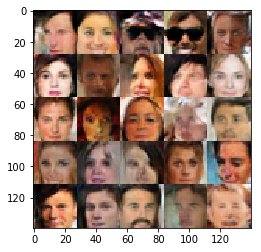

Epoch 3/4... Discriminator Loss: 1.3445... Generator Loss: 0.5412
Epoch 3/4... Discriminator Loss: 1.0403... Generator Loss: 0.7737
Epoch 3/4... Discriminator Loss: 1.0072... Generator Loss: 0.9371
Epoch 3/4... Discriminator Loss: 0.7937... Generator Loss: 1.5216
Epoch 3/4... Discriminator Loss: 0.7624... Generator Loss: 1.8052
Epoch 3/4... Discriminator Loss: 1.0462... Generator Loss: 0.7950
Epoch 3/4... Discriminator Loss: 0.9456... Generator Loss: 0.9415
Epoch 3/4... Discriminator Loss: 1.1027... Generator Loss: 0.7832
Epoch 3/4... Discriminator Loss: 0.7820... Generator Loss: 1.5474
Epoch 3/4... Discriminator Loss: 0.8638... Generator Loss: 1.4696


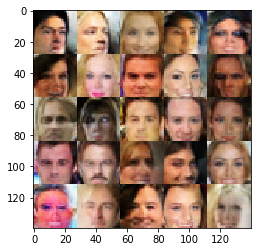

Epoch 3/4... Discriminator Loss: 1.1001... Generator Loss: 0.8128
Epoch 3/4... Discriminator Loss: 0.8549... Generator Loss: 1.3962
Epoch 3/4... Discriminator Loss: 0.7983... Generator Loss: 1.6083
Epoch 3/4... Discriminator Loss: 1.1359... Generator Loss: 0.7123
Epoch 3/4... Discriminator Loss: 1.0497... Generator Loss: 0.7979
Epoch 3/4... Discriminator Loss: 0.9109... Generator Loss: 1.0130
Epoch 3/4... Discriminator Loss: 0.8768... Generator Loss: 1.1503
Epoch 3/4... Discriminator Loss: 1.5021... Generator Loss: 0.4270
Epoch 3/4... Discriminator Loss: 1.1553... Generator Loss: 0.6848
Epoch 3/4... Discriminator Loss: 0.7214... Generator Loss: 1.6711


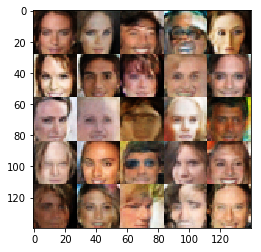

Epoch 3/4... Discriminator Loss: 0.9406... Generator Loss: 1.0321
Epoch 3/4... Discriminator Loss: 0.9059... Generator Loss: 1.0687
Epoch 3/4... Discriminator Loss: 1.0125... Generator Loss: 1.2255
Epoch 3/4... Discriminator Loss: 0.9768... Generator Loss: 0.9391
Epoch 3/4... Discriminator Loss: 0.9191... Generator Loss: 0.9726
Epoch 3/4... Discriminator Loss: 1.1003... Generator Loss: 0.7694
Epoch 3/4... Discriminator Loss: 1.1093... Generator Loss: 0.7141
Epoch 3/4... Discriminator Loss: 0.9385... Generator Loss: 1.0542
Epoch 3/4... Discriminator Loss: 1.0663... Generator Loss: 0.7415
Epoch 3/4... Discriminator Loss: 1.0802... Generator Loss: 0.8114


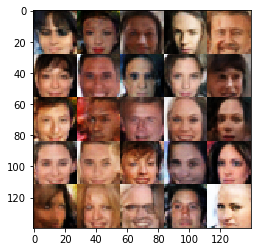

Epoch 3/4... Discriminator Loss: 1.0842... Generator Loss: 0.7831
Epoch 3/4... Discriminator Loss: 1.1133... Generator Loss: 0.7190
Epoch 3/4... Discriminator Loss: 0.9903... Generator Loss: 1.2839
Epoch 3/4... Discriminator Loss: 1.0991... Generator Loss: 1.2576
Epoch 3/4... Discriminator Loss: 0.8011... Generator Loss: 1.2825
Epoch 3/4... Discriminator Loss: 0.9830... Generator Loss: 0.9272
Epoch 3/4... Discriminator Loss: 0.9031... Generator Loss: 1.1200
Epoch 3/4... Discriminator Loss: 1.3305... Generator Loss: 0.5479
Epoch 3/4... Discriminator Loss: 0.6208... Generator Loss: 1.6382
Epoch 3/4... Discriminator Loss: 0.7940... Generator Loss: 1.2120


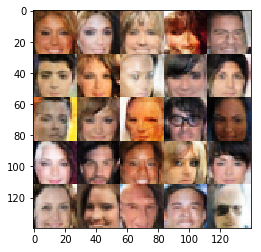

Epoch 3/4... Discriminator Loss: 1.0378... Generator Loss: 1.4169
Epoch 3/4... Discriminator Loss: 1.2052... Generator Loss: 0.7685
Epoch 3/4... Discriminator Loss: 0.6928... Generator Loss: 1.4645
Epoch 3/4... Discriminator Loss: 0.7464... Generator Loss: 1.2660
Epoch 3/4... Discriminator Loss: 0.7407... Generator Loss: 1.4052
Epoch 3/4... Discriminator Loss: 1.4360... Generator Loss: 0.4827
Epoch 3/4... Discriminator Loss: 1.1024... Generator Loss: 1.5675
Epoch 3/4... Discriminator Loss: 0.8529... Generator Loss: 1.2823
Epoch 3/4... Discriminator Loss: 0.7433... Generator Loss: 1.2669
Epoch 3/4... Discriminator Loss: 1.3336... Generator Loss: 0.5723


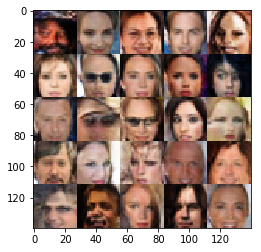

Epoch 3/4... Discriminator Loss: 0.8114... Generator Loss: 1.4591
Epoch 3/4... Discriminator Loss: 0.8630... Generator Loss: 1.0815
Epoch 3/4... Discriminator Loss: 0.7776... Generator Loss: 1.3206
Epoch 3/4... Discriminator Loss: 0.7544... Generator Loss: 1.3257
Epoch 3/4... Discriminator Loss: 0.8531... Generator Loss: 1.0336
Epoch 3/4... Discriminator Loss: 0.9593... Generator Loss: 2.2332
Epoch 3/4... Discriminator Loss: 0.9389... Generator Loss: 1.0118
Epoch 3/4... Discriminator Loss: 0.8464... Generator Loss: 1.4409
Epoch 3/4... Discriminator Loss: 0.7340... Generator Loss: 1.3697
Epoch 3/4... Discriminator Loss: 0.8816... Generator Loss: 1.1360


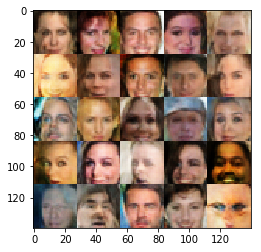

Epoch 3/4... Discriminator Loss: 1.0108... Generator Loss: 2.2345
Epoch 3/4... Discriminator Loss: 0.8207... Generator Loss: 1.1861
Epoch 3/4... Discriminator Loss: 1.1877... Generator Loss: 0.6536
Epoch 3/4... Discriminator Loss: 1.1340... Generator Loss: 0.7131
Epoch 3/4... Discriminator Loss: 1.0133... Generator Loss: 0.8409
Epoch 3/4... Discriminator Loss: 1.1802... Generator Loss: 0.6277
Epoch 3/4... Discriminator Loss: 0.9106... Generator Loss: 0.9970
Epoch 3/4... Discriminator Loss: 0.7969... Generator Loss: 1.3966
Epoch 3/4... Discriminator Loss: 0.7214... Generator Loss: 1.6057
Epoch 3/4... Discriminator Loss: 1.3713... Generator Loss: 0.5344


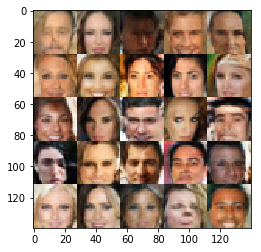

Epoch 3/4... Discriminator Loss: 0.8029... Generator Loss: 1.9588
Epoch 3/4... Discriminator Loss: 0.7804... Generator Loss: 1.2593
Epoch 3/4... Discriminator Loss: 0.8653... Generator Loss: 1.0393
Epoch 3/4... Discriminator Loss: 0.9223... Generator Loss: 1.1587
Epoch 3/4... Discriminator Loss: 0.7309... Generator Loss: 1.4230
Epoch 3/4... Discriminator Loss: 1.1680... Generator Loss: 0.6665
Epoch 3/4... Discriminator Loss: 0.8247... Generator Loss: 1.1830
Epoch 3/4... Discriminator Loss: 0.9386... Generator Loss: 1.6377
Epoch 3/4... Discriminator Loss: 0.8986... Generator Loss: 1.2372
Epoch 3/4... Discriminator Loss: 1.6602... Generator Loss: 0.3379


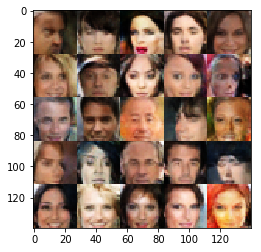

Epoch 3/4... Discriminator Loss: 0.9694... Generator Loss: 0.8760
Epoch 3/4... Discriminator Loss: 0.8846... Generator Loss: 1.4111
Epoch 3/4... Discriminator Loss: 0.7516... Generator Loss: 1.3296
Epoch 3/4... Discriminator Loss: 0.9044... Generator Loss: 1.1201
Epoch 3/4... Discriminator Loss: 0.8422... Generator Loss: 1.5956
Epoch 3/4... Discriminator Loss: 0.8989... Generator Loss: 1.0888
Epoch 3/4... Discriminator Loss: 1.2259... Generator Loss: 0.6317
Epoch 3/4... Discriminator Loss: 1.4348... Generator Loss: 0.5288
Epoch 3/4... Discriminator Loss: 0.7538... Generator Loss: 1.4533
Epoch 3/4... Discriminator Loss: 0.8316... Generator Loss: 1.3418


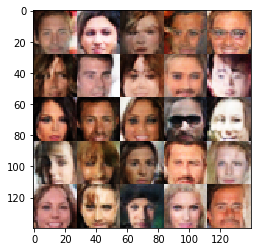

Epoch 3/4... Discriminator Loss: 0.9363... Generator Loss: 0.9513
Epoch 3/4... Discriminator Loss: 0.7894... Generator Loss: 1.1994
Epoch 3/4... Discriminator Loss: 1.3500... Generator Loss: 0.5343
Epoch 3/4... Discriminator Loss: 1.0135... Generator Loss: 0.7835
Epoch 3/4... Discriminator Loss: 1.3357... Generator Loss: 2.1807
Epoch 3/4... Discriminator Loss: 0.9400... Generator Loss: 1.0648
Epoch 3/4... Discriminator Loss: 0.8728... Generator Loss: 1.3813
Epoch 3/4... Discriminator Loss: 0.8339... Generator Loss: 1.1065
Epoch 3/4... Discriminator Loss: 1.2998... Generator Loss: 0.5569
Epoch 3/4... Discriminator Loss: 0.8916... Generator Loss: 1.1448


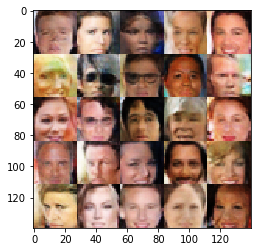

Epoch 3/4... Discriminator Loss: 0.8036... Generator Loss: 1.3175
Epoch 3/4... Discriminator Loss: 0.8800... Generator Loss: 1.5143
Epoch 3/4... Discriminator Loss: 0.5460... Generator Loss: 2.1691
Epoch 3/4... Discriminator Loss: 0.7085... Generator Loss: 1.3741
Epoch 3/4... Discriminator Loss: 0.7930... Generator Loss: 1.2455
Epoch 3/4... Discriminator Loss: 0.8535... Generator Loss: 1.0962
Epoch 3/4... Discriminator Loss: 0.7726... Generator Loss: 1.5667
Epoch 3/4... Discriminator Loss: 1.2357... Generator Loss: 0.6172
Epoch 3/4... Discriminator Loss: 0.8587... Generator Loss: 1.0524
Epoch 3/4... Discriminator Loss: 0.7694... Generator Loss: 1.2449


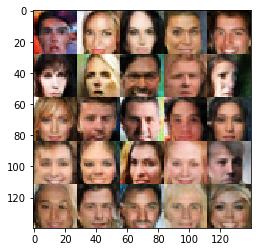

Epoch 3/4... Discriminator Loss: 0.9230... Generator Loss: 0.9598
Epoch 3/4... Discriminator Loss: 0.6665... Generator Loss: 1.8197
Epoch 3/4... Discriminator Loss: 0.6935... Generator Loss: 1.8346
Epoch 3/4... Discriminator Loss: 0.8212... Generator Loss: 1.3993
Epoch 3/4... Discriminator Loss: 1.1437... Generator Loss: 0.7347
Epoch 3/4... Discriminator Loss: 0.8678... Generator Loss: 1.1064
Epoch 3/4... Discriminator Loss: 0.5319... Generator Loss: 2.2217
Epoch 3/4... Discriminator Loss: 0.9417... Generator Loss: 0.9295
Epoch 3/4... Discriminator Loss: 1.0068... Generator Loss: 0.8305
Epoch 3/4... Discriminator Loss: 0.9908... Generator Loss: 0.8333


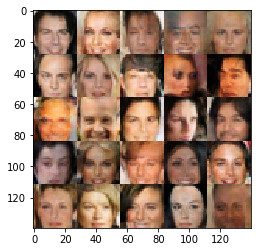

Epoch 3/4... Discriminator Loss: 1.0130... Generator Loss: 0.8307
Epoch 3/4... Discriminator Loss: 1.1976... Generator Loss: 0.6757
Epoch 3/4... Discriminator Loss: 0.9192... Generator Loss: 1.0028
Epoch 3/4... Discriminator Loss: 1.8944... Generator Loss: 0.2867
Epoch 3/4... Discriminator Loss: 1.1454... Generator Loss: 0.7108
Epoch 3/4... Discriminator Loss: 1.2570... Generator Loss: 0.5839
Epoch 3/4... Discriminator Loss: 1.2652... Generator Loss: 0.6086
Epoch 3/4... Discriminator Loss: 0.9616... Generator Loss: 1.0449
Epoch 3/4... Discriminator Loss: 0.7683... Generator Loss: 1.3263
Epoch 3/4... Discriminator Loss: 1.3167... Generator Loss: 0.5219


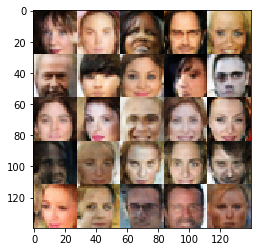

Epoch 3/4... Discriminator Loss: 0.7758... Generator Loss: 1.2855
Epoch 3/4... Discriminator Loss: 1.5727... Generator Loss: 0.4047
Epoch 3/4... Discriminator Loss: 0.6017... Generator Loss: 2.2026
Epoch 3/4... Discriminator Loss: 1.3720... Generator Loss: 0.4944
Epoch 3/4... Discriminator Loss: 1.0454... Generator Loss: 0.8965
Epoch 3/4... Discriminator Loss: 0.8722... Generator Loss: 1.0301
Epoch 3/4... Discriminator Loss: 1.3117... Generator Loss: 0.5714
Epoch 3/4... Discriminator Loss: 1.1870... Generator Loss: 0.6594
Epoch 3/4... Discriminator Loss: 0.8235... Generator Loss: 1.2938
Epoch 3/4... Discriminator Loss: 0.9649... Generator Loss: 1.1351


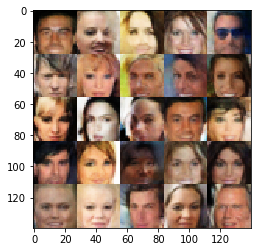

Epoch 3/4... Discriminator Loss: 0.9654... Generator Loss: 0.8492
Epoch 3/4... Discriminator Loss: 0.6269... Generator Loss: 1.9327
Epoch 3/4... Discriminator Loss: 0.9206... Generator Loss: 0.9507
Epoch 3/4... Discriminator Loss: 0.9729... Generator Loss: 0.8778
Epoch 3/4... Discriminator Loss: 0.8921... Generator Loss: 1.2587
Epoch 3/4... Discriminator Loss: 0.8509... Generator Loss: 1.3760
Epoch 3/4... Discriminator Loss: 0.8209... Generator Loss: 1.3004
Epoch 3/4... Discriminator Loss: 1.3323... Generator Loss: 0.5245
Epoch 3/4... Discriminator Loss: 0.8211... Generator Loss: 1.2960
Epoch 3/4... Discriminator Loss: 0.9183... Generator Loss: 0.9767


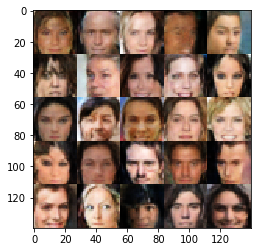

Epoch 3/4... Discriminator Loss: 0.8820... Generator Loss: 1.3336
Epoch 3/4... Discriminator Loss: 1.1133... Generator Loss: 0.7666
Epoch 3/4... Discriminator Loss: 1.0446... Generator Loss: 0.9447
Epoch 3/4... Discriminator Loss: 0.8711... Generator Loss: 1.2275
Epoch 3/4... Discriminator Loss: 1.5495... Generator Loss: 0.4225
Epoch 3/4... Discriminator Loss: 0.9525... Generator Loss: 1.3475
Epoch 3/4... Discriminator Loss: 0.8195... Generator Loss: 2.5782
Epoch 3/4... Discriminator Loss: 1.6223... Generator Loss: 0.3698
Epoch 3/4... Discriminator Loss: 0.7682... Generator Loss: 1.9082
Epoch 3/4... Discriminator Loss: 1.0427... Generator Loss: 0.8237


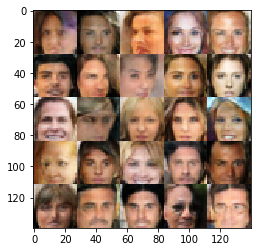

Epoch 3/4... Discriminator Loss: 0.7399... Generator Loss: 1.4135
Epoch 3/4... Discriminator Loss: 1.1965... Generator Loss: 0.6699
Epoch 3/4... Discriminator Loss: 0.8664... Generator Loss: 2.2614
Epoch 3/4... Discriminator Loss: 0.9550... Generator Loss: 0.9552
Epoch 3/4... Discriminator Loss: 0.9134... Generator Loss: 1.1943
Epoch 3/4... Discriminator Loss: 0.9340... Generator Loss: 1.2067
Epoch 3/4... Discriminator Loss: 1.3399... Generator Loss: 0.5375
Epoch 3/4... Discriminator Loss: 0.6050... Generator Loss: 1.7320
Epoch 3/4... Discriminator Loss: 1.3426... Generator Loss: 0.5397
Epoch 3/4... Discriminator Loss: 1.4209... Generator Loss: 0.4552


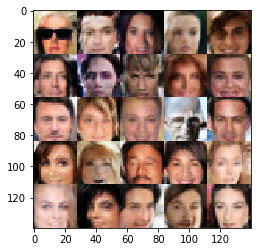

Epoch 3/4... Discriminator Loss: 1.0365... Generator Loss: 0.7611
Epoch 3/4... Discriminator Loss: 1.2740... Generator Loss: 0.5844
Epoch 3/4... Discriminator Loss: 1.4686... Generator Loss: 0.4592
Epoch 3/4... Discriminator Loss: 0.7868... Generator Loss: 1.5558
Epoch 3/4... Discriminator Loss: 0.9699... Generator Loss: 1.0833
Epoch 3/4... Discriminator Loss: 0.9996... Generator Loss: 0.7880
Epoch 3/4... Discriminator Loss: 0.8594... Generator Loss: 1.1895
Epoch 3/4... Discriminator Loss: 0.9287... Generator Loss: 1.0070
Epoch 3/4... Discriminator Loss: 1.0974... Generator Loss: 0.7633
Epoch 3/4... Discriminator Loss: 0.7402... Generator Loss: 1.2791


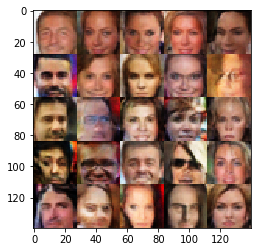

Epoch 3/4... Discriminator Loss: 1.4749... Generator Loss: 0.5163
Epoch 3/4... Discriminator Loss: 0.6513... Generator Loss: 1.6415
Epoch 3/4... Discriminator Loss: 1.1831... Generator Loss: 0.6371
Epoch 3/4... Discriminator Loss: 0.7798... Generator Loss: 1.5108
Epoch 3/4... Discriminator Loss: 0.8091... Generator Loss: 1.1650
Epoch 3/4... Discriminator Loss: 1.0776... Generator Loss: 0.7578
Epoch 3/4... Discriminator Loss: 1.3112... Generator Loss: 0.6315
Epoch 3/4... Discriminator Loss: 0.8538... Generator Loss: 1.1206
Epoch 3/4... Discriminator Loss: 0.8949... Generator Loss: 1.1045
Epoch 3/4... Discriminator Loss: 0.9243... Generator Loss: 0.9994


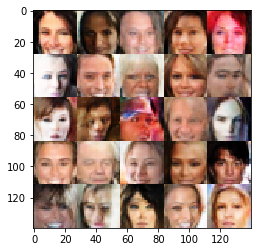

Epoch 3/4... Discriminator Loss: 0.7915... Generator Loss: 1.1282
Epoch 3/4... Discriminator Loss: 0.9241... Generator Loss: 1.0501
Epoch 3/4... Discriminator Loss: 1.0984... Generator Loss: 0.7266
Epoch 3/4... Discriminator Loss: 0.9847... Generator Loss: 0.9436
Epoch 3/4... Discriminator Loss: 1.3814... Generator Loss: 0.5295
Epoch 3/4... Discriminator Loss: 0.8587... Generator Loss: 1.1296
Epoch 3/4... Discriminator Loss: 0.9593... Generator Loss: 1.0889
Epoch 3/4... Discriminator Loss: 1.5561... Generator Loss: 0.4152
Epoch 3/4... Discriminator Loss: 0.7465... Generator Loss: 2.0511
Epoch 3/4... Discriminator Loss: 1.0322... Generator Loss: 0.7896


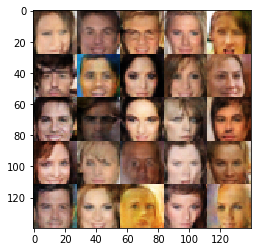

Epoch 3/4... Discriminator Loss: 1.7803... Generator Loss: 0.3326
Epoch 3/4... Discriminator Loss: 1.0555... Generator Loss: 0.7805
Epoch 3/4... Discriminator Loss: 1.1650... Generator Loss: 0.6887
Epoch 3/4... Discriminator Loss: 1.0819... Generator Loss: 0.7375
Epoch 3/4... Discriminator Loss: 0.9841... Generator Loss: 1.3175
Epoch 3/4... Discriminator Loss: 0.6652... Generator Loss: 1.8391
Epoch 3/4... Discriminator Loss: 0.8563... Generator Loss: 1.0925
Epoch 3/4... Discriminator Loss: 0.9350... Generator Loss: 1.0225
Epoch 3/4... Discriminator Loss: 0.6667... Generator Loss: 1.5826
Epoch 3/4... Discriminator Loss: 0.6932... Generator Loss: 1.6211


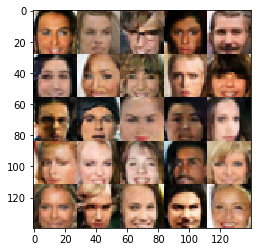

Epoch 3/4... Discriminator Loss: 0.7565... Generator Loss: 1.3166
Epoch 3/4... Discriminator Loss: 0.7842... Generator Loss: 1.4253
Epoch 3/4... Discriminator Loss: 1.1079... Generator Loss: 0.6784
Epoch 3/4... Discriminator Loss: 0.8485... Generator Loss: 1.1011
Epoch 3/4... Discriminator Loss: 1.1348... Generator Loss: 0.8130
Epoch 3/4... Discriminator Loss: 0.9452... Generator Loss: 1.0595
Epoch 3/4... Discriminator Loss: 0.6360... Generator Loss: 1.7624
Epoch 3/4... Discriminator Loss: 0.9198... Generator Loss: 0.9190
Epoch 3/4... Discriminator Loss: 0.9166... Generator Loss: 1.3309
Epoch 3/4... Discriminator Loss: 1.3599... Generator Loss: 0.5157


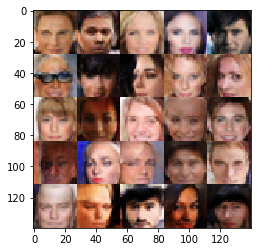

Epoch 3/4... Discriminator Loss: 1.3605... Generator Loss: 0.5524
Epoch 3/4... Discriminator Loss: 0.9377... Generator Loss: 0.9480
Epoch 3/4... Discriminator Loss: 1.0557... Generator Loss: 0.7743
Epoch 3/4... Discriminator Loss: 0.8980... Generator Loss: 1.8277
Epoch 3/4... Discriminator Loss: 0.9363... Generator Loss: 0.9478
Epoch 3/4... Discriminator Loss: 0.8689... Generator Loss: 0.9890
Epoch 3/4... Discriminator Loss: 1.1885... Generator Loss: 0.6682
Epoch 3/4... Discriminator Loss: 1.4309... Generator Loss: 0.5242
Epoch 3/4... Discriminator Loss: 0.9795... Generator Loss: 0.8946
Epoch 3/4... Discriminator Loss: 1.1174... Generator Loss: 0.7714


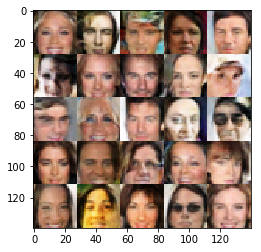

Epoch 3/4... Discriminator Loss: 1.0308... Generator Loss: 0.8622
Epoch 3/4... Discriminator Loss: 1.0090... Generator Loss: 0.9119
Epoch 3/4... Discriminator Loss: 1.3980... Generator Loss: 0.5273
Epoch 3/4... Discriminator Loss: 0.6637... Generator Loss: 1.8063
Epoch 3/4... Discriminator Loss: 0.9916... Generator Loss: 0.8674
Epoch 3/4... Discriminator Loss: 1.7563... Generator Loss: 0.3267
Epoch 3/4... Discriminator Loss: 1.3641... Generator Loss: 0.5265
Epoch 3/4... Discriminator Loss: 0.7998... Generator Loss: 1.6699
Epoch 3/4... Discriminator Loss: 1.2273... Generator Loss: 0.6689
Epoch 3/4... Discriminator Loss: 0.6612... Generator Loss: 1.7620


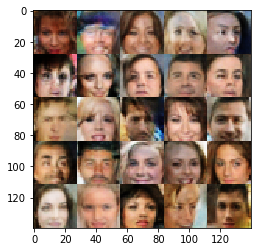

Epoch 3/4... Discriminator Loss: 0.8972... Generator Loss: 1.0951
Epoch 3/4... Discriminator Loss: 0.7898... Generator Loss: 1.2346
Epoch 3/4... Discriminator Loss: 1.2115... Generator Loss: 0.6484
Epoch 3/4... Discriminator Loss: 0.6718... Generator Loss: 1.7908
Epoch 3/4... Discriminator Loss: 1.4713... Generator Loss: 0.4580
Epoch 3/4... Discriminator Loss: 1.1542... Generator Loss: 0.6946
Epoch 3/4... Discriminator Loss: 0.9263... Generator Loss: 0.9846
Epoch 3/4... Discriminator Loss: 0.8615... Generator Loss: 1.0900
Epoch 3/4... Discriminator Loss: 1.2154... Generator Loss: 2.7201
Epoch 3/4... Discriminator Loss: 0.7197... Generator Loss: 1.3672


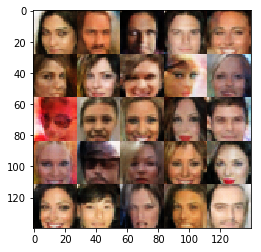

Epoch 3/4... Discriminator Loss: 1.2350... Generator Loss: 0.6191
Epoch 3/4... Discriminator Loss: 0.8647... Generator Loss: 1.1363
Epoch 3/4... Discriminator Loss: 0.8468... Generator Loss: 1.3480
Epoch 3/4... Discriminator Loss: 1.1889... Generator Loss: 0.6543
Epoch 3/4... Discriminator Loss: 1.0452... Generator Loss: 0.7774
Epoch 3/4... Discriminator Loss: 0.9600... Generator Loss: 0.9042
Epoch 3/4... Discriminator Loss: 0.9331... Generator Loss: 0.9182
Epoch 3/4... Discriminator Loss: 0.6490... Generator Loss: 1.7658
Epoch 3/4... Discriminator Loss: 0.7632... Generator Loss: 1.3180
Epoch 3/4... Discriminator Loss: 0.7236... Generator Loss: 1.6082


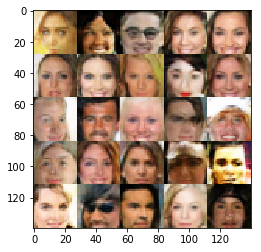

Epoch 3/4... Discriminator Loss: 1.6749... Generator Loss: 0.3731
Epoch 3/4... Discriminator Loss: 1.6575... Generator Loss: 0.4039
Epoch 3/4... Discriminator Loss: 0.7560... Generator Loss: 1.3660
Epoch 3/4... Discriminator Loss: 0.6642... Generator Loss: 1.5002
Epoch 3/4... Discriminator Loss: 1.2427... Generator Loss: 0.5958
Epoch 3/4... Discriminator Loss: 1.0340... Generator Loss: 0.8037
Epoch 3/4... Discriminator Loss: 0.9828... Generator Loss: 0.8972
Epoch 3/4... Discriminator Loss: 1.2085... Generator Loss: 0.6780
Epoch 3/4... Discriminator Loss: 0.7799... Generator Loss: 1.3352
Epoch 3/4... Discriminator Loss: 0.8662... Generator Loss: 1.1600


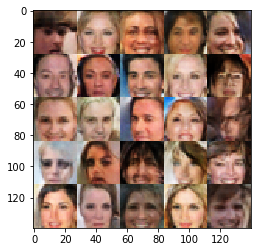

Epoch 3/4... Discriminator Loss: 1.2029... Generator Loss: 0.6644
Epoch 3/4... Discriminator Loss: 0.8067... Generator Loss: 1.2659
Epoch 3/4... Discriminator Loss: 0.7303... Generator Loss: 2.2081
Epoch 3/4... Discriminator Loss: 1.2265... Generator Loss: 0.6400
Epoch 3/4... Discriminator Loss: 1.6071... Generator Loss: 0.3992
Epoch 3/4... Discriminator Loss: 0.9889... Generator Loss: 0.7968
Epoch 3/4... Discriminator Loss: 0.9908... Generator Loss: 0.8726
Epoch 3/4... Discriminator Loss: 1.0980... Generator Loss: 0.7300
Epoch 3/4... Discriminator Loss: 0.7834... Generator Loss: 1.4911
Epoch 3/4... Discriminator Loss: 1.1801... Generator Loss: 0.7160


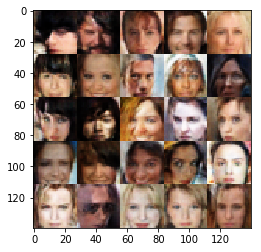

Epoch 3/4... Discriminator Loss: 1.2586... Generator Loss: 0.6413
Epoch 3/4... Discriminator Loss: 0.8249... Generator Loss: 1.6041
Epoch 3/4... Discriminator Loss: 0.7904... Generator Loss: 1.2187
Epoch 3/4... Discriminator Loss: 0.9366... Generator Loss: 1.0643
Epoch 3/4... Discriminator Loss: 0.9412... Generator Loss: 1.1323
Epoch 3/4... Discriminator Loss: 1.3757... Generator Loss: 0.4947
Epoch 3/4... Discriminator Loss: 0.9199... Generator Loss: 2.5678
Epoch 3/4... Discriminator Loss: 1.0236... Generator Loss: 1.9156
Epoch 3/4... Discriminator Loss: 0.8923... Generator Loss: 1.1954
Epoch 3/4... Discriminator Loss: 0.5866... Generator Loss: 2.0011


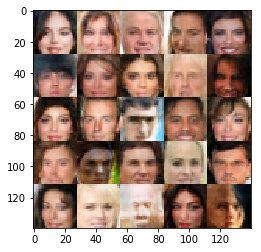

Epoch 3/4... Discriminator Loss: 1.2117... Generator Loss: 0.6474
Epoch 3/4... Discriminator Loss: 0.8845... Generator Loss: 0.9639
Epoch 3/4... Discriminator Loss: 1.3506... Generator Loss: 0.5015
Epoch 3/4... Discriminator Loss: 0.9425... Generator Loss: 1.1137
Epoch 3/4... Discriminator Loss: 0.9542... Generator Loss: 1.6268
Epoch 3/4... Discriminator Loss: 1.0023... Generator Loss: 0.8548
Epoch 3/4... Discriminator Loss: 1.6338... Generator Loss: 0.3923
Epoch 3/4... Discriminator Loss: 0.8490... Generator Loss: 1.3608
Epoch 3/4... Discriminator Loss: 0.8660... Generator Loss: 1.0129
Epoch 3/4... Discriminator Loss: 1.0469... Generator Loss: 0.7669


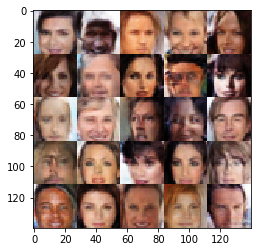

Epoch 3/4... Discriminator Loss: 0.7021... Generator Loss: 1.9298
Epoch 3/4... Discriminator Loss: 0.7981... Generator Loss: 1.5586
Epoch 3/4... Discriminator Loss: 1.1941... Generator Loss: 0.6474
Epoch 3/4... Discriminator Loss: 0.8867... Generator Loss: 1.0984
Epoch 3/4... Discriminator Loss: 0.8356... Generator Loss: 1.7299
Epoch 3/4... Discriminator Loss: 1.2932... Generator Loss: 0.5875
Epoch 3/4... Discriminator Loss: 0.7195... Generator Loss: 2.0101
Epoch 3/4... Discriminator Loss: 1.2520... Generator Loss: 0.5871
Epoch 3/4... Discriminator Loss: 0.6300... Generator Loss: 1.7088
Epoch 3/4... Discriminator Loss: 0.6021... Generator Loss: 2.1672


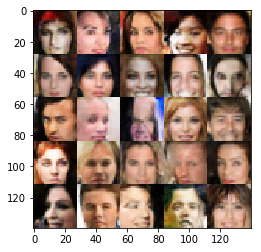

Epoch 3/4... Discriminator Loss: 1.3339... Generator Loss: 0.5101
Epoch 3/4... Discriminator Loss: 1.0590... Generator Loss: 0.9537
Epoch 3/4... Discriminator Loss: 0.8406... Generator Loss: 1.0534
Epoch 3/4... Discriminator Loss: 1.0439... Generator Loss: 0.8009
Epoch 3/4... Discriminator Loss: 0.8956... Generator Loss: 1.0142
Epoch 3/4... Discriminator Loss: 1.1013... Generator Loss: 0.6946
Epoch 3/4... Discriminator Loss: 1.3129... Generator Loss: 0.5609
Epoch 3/4... Discriminator Loss: 1.7541... Generator Loss: 0.3446
Epoch 3/4... Discriminator Loss: 0.9825... Generator Loss: 1.0011
Epoch 3/4... Discriminator Loss: 0.9236... Generator Loss: 1.0338


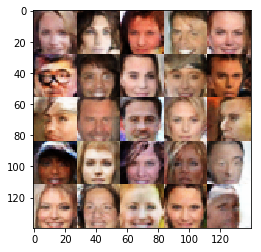

Epoch 3/4... Discriminator Loss: 0.6086... Generator Loss: 1.8102
Epoch 3/4... Discriminator Loss: 1.0346... Generator Loss: 0.8153
Epoch 3/4... Discriminator Loss: 1.3159... Generator Loss: 0.5494
Epoch 3/4... Discriminator Loss: 1.0095... Generator Loss: 0.8717
Epoch 3/4... Discriminator Loss: 1.0113... Generator Loss: 0.9915
Epoch 3/4... Discriminator Loss: 0.7277... Generator Loss: 1.4612
Epoch 3/4... Discriminator Loss: 1.5779... Generator Loss: 0.4213
Epoch 3/4... Discriminator Loss: 0.8022... Generator Loss: 1.6521
Epoch 3/4... Discriminator Loss: 0.9005... Generator Loss: 0.9530
Epoch 3/4... Discriminator Loss: 0.9864... Generator Loss: 0.9024


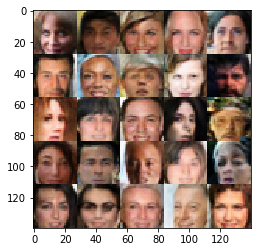

Epoch 3/4... Discriminator Loss: 1.0831... Generator Loss: 0.7513
Epoch 3/4... Discriminator Loss: 1.0867... Generator Loss: 0.7336
Epoch 3/4... Discriminator Loss: 1.0383... Generator Loss: 0.8134
Epoch 3/4... Discriminator Loss: 0.8161... Generator Loss: 1.2671
Epoch 3/4... Discriminator Loss: 1.4351... Generator Loss: 0.4639
Epoch 3/4... Discriminator Loss: 0.9368... Generator Loss: 0.9884
Epoch 3/4... Discriminator Loss: 0.8372... Generator Loss: 1.2293
Epoch 3/4... Discriminator Loss: 0.9772... Generator Loss: 1.1366
Epoch 3/4... Discriminator Loss: 1.4396... Generator Loss: 0.5876
Epoch 4/4... Discriminator Loss: 0.9290... Generator Loss: 1.0532


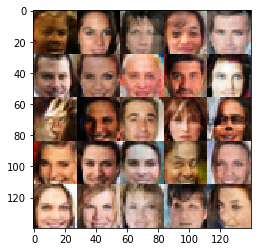

Epoch 4/4... Discriminator Loss: 1.1721... Generator Loss: 0.6385
Epoch 4/4... Discriminator Loss: 1.4744... Generator Loss: 0.5497
Epoch 4/4... Discriminator Loss: 1.5243... Generator Loss: 0.4749
Epoch 4/4... Discriminator Loss: 1.0886... Generator Loss: 0.7048
Epoch 4/4... Discriminator Loss: 0.8447... Generator Loss: 1.2928
Epoch 4/4... Discriminator Loss: 1.1952... Generator Loss: 0.7789
Epoch 4/4... Discriminator Loss: 0.9101... Generator Loss: 1.0623
Epoch 4/4... Discriminator Loss: 1.3214... Generator Loss: 0.5336
Epoch 4/4... Discriminator Loss: 0.8227... Generator Loss: 1.2021
Epoch 4/4... Discriminator Loss: 1.2128... Generator Loss: 0.6854


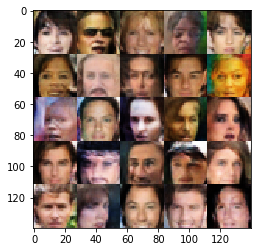

Epoch 4/4... Discriminator Loss: 1.3076... Generator Loss: 0.5685
Epoch 4/4... Discriminator Loss: 0.7177... Generator Loss: 1.4886
Epoch 4/4... Discriminator Loss: 0.5901... Generator Loss: 1.7059
Epoch 4/4... Discriminator Loss: 1.0077... Generator Loss: 1.0437
Epoch 4/4... Discriminator Loss: 0.8733... Generator Loss: 1.0438
Epoch 4/4... Discriminator Loss: 0.6342... Generator Loss: 1.7416
Epoch 4/4... Discriminator Loss: 1.5463... Generator Loss: 0.4382
Epoch 4/4... Discriminator Loss: 0.8471... Generator Loss: 1.1459
Epoch 4/4... Discriminator Loss: 1.4475... Generator Loss: 0.4629
Epoch 4/4... Discriminator Loss: 1.4025... Generator Loss: 0.4915


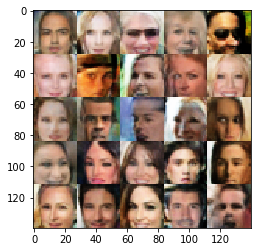

Epoch 4/4... Discriminator Loss: 1.1442... Generator Loss: 0.6839
Epoch 4/4... Discriminator Loss: 0.9853... Generator Loss: 0.9724
Epoch 4/4... Discriminator Loss: 0.7860... Generator Loss: 1.5125
Epoch 4/4... Discriminator Loss: 1.1660... Generator Loss: 0.6743
Epoch 4/4... Discriminator Loss: 0.9040... Generator Loss: 0.9473
Epoch 4/4... Discriminator Loss: 0.8764... Generator Loss: 1.0013
Epoch 4/4... Discriminator Loss: 1.2010... Generator Loss: 0.6665
Epoch 4/4... Discriminator Loss: 0.6910... Generator Loss: 1.5649
Epoch 4/4... Discriminator Loss: 0.7816... Generator Loss: 1.1684
Epoch 4/4... Discriminator Loss: 1.2151... Generator Loss: 0.6212


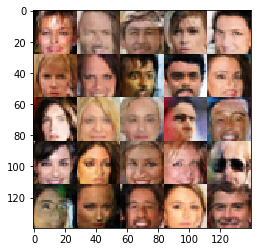

Epoch 4/4... Discriminator Loss: 1.2198... Generator Loss: 0.5920
Epoch 4/4... Discriminator Loss: 1.3793... Generator Loss: 0.4943
Epoch 4/4... Discriminator Loss: 0.8966... Generator Loss: 2.2006
Epoch 4/4... Discriminator Loss: 0.8444... Generator Loss: 1.1549
Epoch 4/4... Discriminator Loss: 0.9293... Generator Loss: 1.0071
Epoch 4/4... Discriminator Loss: 0.7080... Generator Loss: 1.5155
Epoch 4/4... Discriminator Loss: 1.4892... Generator Loss: 0.4317
Epoch 4/4... Discriminator Loss: 1.0232... Generator Loss: 1.0576
Epoch 4/4... Discriminator Loss: 0.8202... Generator Loss: 1.2199
Epoch 4/4... Discriminator Loss: 0.9243... Generator Loss: 0.9003


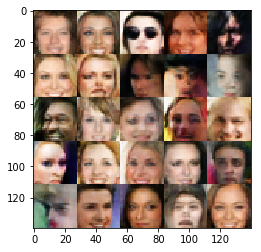

Epoch 4/4... Discriminator Loss: 0.8025... Generator Loss: 1.6227
Epoch 4/4... Discriminator Loss: 0.8662... Generator Loss: 1.9598
Epoch 4/4... Discriminator Loss: 0.8612... Generator Loss: 1.2022
Epoch 4/4... Discriminator Loss: 1.0281... Generator Loss: 0.8862
Epoch 4/4... Discriminator Loss: 0.8957... Generator Loss: 1.0183
Epoch 4/4... Discriminator Loss: 0.8403... Generator Loss: 1.3683
Epoch 4/4... Discriminator Loss: 1.1078... Generator Loss: 0.6801
Epoch 4/4... Discriminator Loss: 0.7678... Generator Loss: 1.6772
Epoch 4/4... Discriminator Loss: 1.1269... Generator Loss: 0.7939
Epoch 4/4... Discriminator Loss: 1.0805... Generator Loss: 0.7679


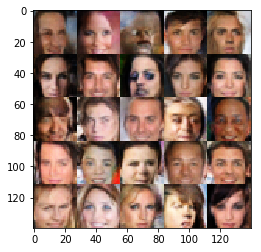

Epoch 4/4... Discriminator Loss: 0.9325... Generator Loss: 1.3083
Epoch 4/4... Discriminator Loss: 1.3007... Generator Loss: 0.5611
Epoch 4/4... Discriminator Loss: 0.9061... Generator Loss: 0.9904
Epoch 4/4... Discriminator Loss: 0.8140... Generator Loss: 1.1738
Epoch 4/4... Discriminator Loss: 0.7548... Generator Loss: 1.4524
Epoch 4/4... Discriminator Loss: 1.0126... Generator Loss: 0.9321
Epoch 4/4... Discriminator Loss: 1.0358... Generator Loss: 0.7591
Epoch 4/4... Discriminator Loss: 1.2505... Generator Loss: 2.4069
Epoch 4/4... Discriminator Loss: 0.8834... Generator Loss: 1.6120
Epoch 4/4... Discriminator Loss: 1.4693... Generator Loss: 0.4762


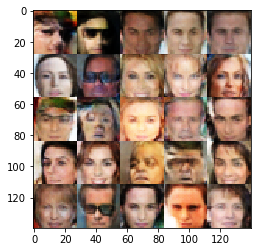

Epoch 4/4... Discriminator Loss: 0.9678... Generator Loss: 0.9553
Epoch 4/4... Discriminator Loss: 1.2329... Generator Loss: 0.5756
Epoch 4/4... Discriminator Loss: 0.8491... Generator Loss: 1.7874
Epoch 4/4... Discriminator Loss: 1.0079... Generator Loss: 0.9758
Epoch 4/4... Discriminator Loss: 0.7226... Generator Loss: 1.3515
Epoch 4/4... Discriminator Loss: 1.2082... Generator Loss: 0.6385
Epoch 4/4... Discriminator Loss: 1.1418... Generator Loss: 0.7456
Epoch 4/4... Discriminator Loss: 0.8090... Generator Loss: 1.2232
Epoch 4/4... Discriminator Loss: 0.9368... Generator Loss: 0.9139
Epoch 4/4... Discriminator Loss: 1.7889... Generator Loss: 0.3252


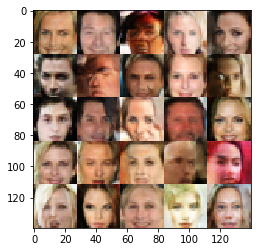

Epoch 4/4... Discriminator Loss: 1.0761... Generator Loss: 0.9869
Epoch 4/4... Discriminator Loss: 1.4332... Generator Loss: 0.4646
Epoch 4/4... Discriminator Loss: 0.7464... Generator Loss: 1.2096
Epoch 4/4... Discriminator Loss: 0.8497... Generator Loss: 1.1555
Epoch 4/4... Discriminator Loss: 1.1226... Generator Loss: 0.7186
Epoch 4/4... Discriminator Loss: 1.1502... Generator Loss: 0.6727
Epoch 4/4... Discriminator Loss: 1.1634... Generator Loss: 0.6488
Epoch 4/4... Discriminator Loss: 0.8909... Generator Loss: 0.9889
Epoch 4/4... Discriminator Loss: 0.6540... Generator Loss: 1.5415
Epoch 4/4... Discriminator Loss: 1.2058... Generator Loss: 0.6505


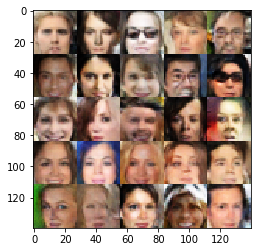

Epoch 4/4... Discriminator Loss: 0.6994... Generator Loss: 1.3770
Epoch 4/4... Discriminator Loss: 1.1645... Generator Loss: 0.6361
Epoch 4/4... Discriminator Loss: 0.8962... Generator Loss: 0.9719
Epoch 4/4... Discriminator Loss: 1.6554... Generator Loss: 0.4374
Epoch 4/4... Discriminator Loss: 0.7559... Generator Loss: 1.5103
Epoch 4/4... Discriminator Loss: 0.8445... Generator Loss: 1.1583
Epoch 4/4... Discriminator Loss: 0.9088... Generator Loss: 1.1023
Epoch 4/4... Discriminator Loss: 0.8128... Generator Loss: 1.1334
Epoch 4/4... Discriminator Loss: 1.0295... Generator Loss: 0.8382
Epoch 4/4... Discriminator Loss: 1.9032... Generator Loss: 0.2752


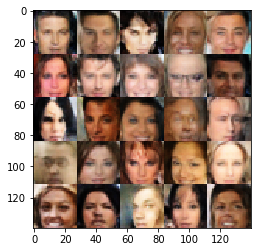

Epoch 4/4... Discriminator Loss: 1.2095... Generator Loss: 0.5971
Epoch 4/4... Discriminator Loss: 1.1202... Generator Loss: 0.6964
Epoch 4/4... Discriminator Loss: 0.8637... Generator Loss: 1.1955
Epoch 4/4... Discriminator Loss: 1.1135... Generator Loss: 0.6877
Epoch 4/4... Discriminator Loss: 0.8902... Generator Loss: 0.9900
Epoch 4/4... Discriminator Loss: 1.3525... Generator Loss: 0.5481
Epoch 4/4... Discriminator Loss: 0.9962... Generator Loss: 0.9078
Epoch 4/4... Discriminator Loss: 0.8578... Generator Loss: 1.1346
Epoch 4/4... Discriminator Loss: 1.0615... Generator Loss: 0.8080
Epoch 4/4... Discriminator Loss: 1.0075... Generator Loss: 0.8320


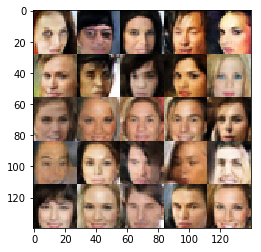

Epoch 4/4... Discriminator Loss: 1.3560... Generator Loss: 0.4940
Epoch 4/4... Discriminator Loss: 0.8541... Generator Loss: 1.0334
Epoch 4/4... Discriminator Loss: 0.9863... Generator Loss: 0.8507
Epoch 4/4... Discriminator Loss: 1.1187... Generator Loss: 0.6730
Epoch 4/4... Discriminator Loss: 1.4771... Generator Loss: 0.4795
Epoch 4/4... Discriminator Loss: 0.8408... Generator Loss: 1.1126
Epoch 4/4... Discriminator Loss: 0.8162... Generator Loss: 1.2870
Epoch 4/4... Discriminator Loss: 0.6946... Generator Loss: 1.4070
Epoch 4/4... Discriminator Loss: 0.7518... Generator Loss: 1.6905
Epoch 4/4... Discriminator Loss: 1.4143... Generator Loss: 0.4880


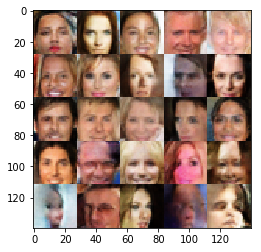

Epoch 4/4... Discriminator Loss: 0.7149... Generator Loss: 1.3811
Epoch 4/4... Discriminator Loss: 0.8893... Generator Loss: 1.4738
Epoch 4/4... Discriminator Loss: 0.7767... Generator Loss: 1.5719
Epoch 4/4... Discriminator Loss: 0.9382... Generator Loss: 0.9701
Epoch 4/4... Discriminator Loss: 1.4292... Generator Loss: 0.4878
Epoch 4/4... Discriminator Loss: 1.1303... Generator Loss: 0.7012
Epoch 4/4... Discriminator Loss: 1.0105... Generator Loss: 0.8876
Epoch 4/4... Discriminator Loss: 0.8443... Generator Loss: 1.0638
Epoch 4/4... Discriminator Loss: 0.7937... Generator Loss: 1.2016
Epoch 4/4... Discriminator Loss: 0.7822... Generator Loss: 1.2427


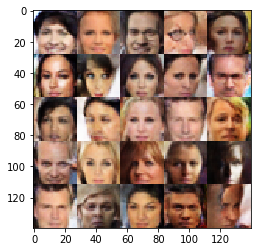

Epoch 4/4... Discriminator Loss: 0.9642... Generator Loss: 0.9411
Epoch 4/4... Discriminator Loss: 0.6990... Generator Loss: 1.7017
Epoch 4/4... Discriminator Loss: 0.9076... Generator Loss: 0.9181
Epoch 4/4... Discriminator Loss: 0.7663... Generator Loss: 1.2040
Epoch 4/4... Discriminator Loss: 0.7327... Generator Loss: 1.4902
Epoch 4/4... Discriminator Loss: 0.8420... Generator Loss: 1.0953
Epoch 4/4... Discriminator Loss: 0.8143... Generator Loss: 1.2644
Epoch 4/4... Discriminator Loss: 0.8940... Generator Loss: 1.0695
Epoch 4/4... Discriminator Loss: 2.0918... Generator Loss: 0.2961
Epoch 4/4... Discriminator Loss: 1.4223... Generator Loss: 0.5354


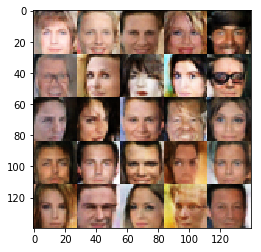

Epoch 4/4... Discriminator Loss: 1.1960... Generator Loss: 0.7752
Epoch 4/4... Discriminator Loss: 0.8592... Generator Loss: 1.1485
Epoch 4/4... Discriminator Loss: 0.9895... Generator Loss: 0.9084
Epoch 4/4... Discriminator Loss: 0.9349... Generator Loss: 1.2646
Epoch 4/4... Discriminator Loss: 0.8481... Generator Loss: 1.4463
Epoch 4/4... Discriminator Loss: 1.3340... Generator Loss: 0.5405
Epoch 4/4... Discriminator Loss: 1.6826... Generator Loss: 0.3554
Epoch 4/4... Discriminator Loss: 1.1462... Generator Loss: 0.7279
Epoch 4/4... Discriminator Loss: 1.9902... Generator Loss: 0.2651
Epoch 4/4... Discriminator Loss: 0.8619... Generator Loss: 1.1803


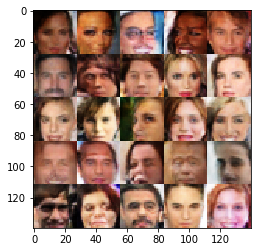

Epoch 4/4... Discriminator Loss: 1.0201... Generator Loss: 1.1343
Epoch 4/4... Discriminator Loss: 1.7740... Generator Loss: 0.3231
Epoch 4/4... Discriminator Loss: 1.2763... Generator Loss: 0.5642
Epoch 4/4... Discriminator Loss: 0.7587... Generator Loss: 1.3126
Epoch 4/4... Discriminator Loss: 1.4299... Generator Loss: 0.4847
Epoch 4/4... Discriminator Loss: 1.0221... Generator Loss: 0.8930
Epoch 4/4... Discriminator Loss: 0.7975... Generator Loss: 1.4825
Epoch 4/4... Discriminator Loss: 0.9380... Generator Loss: 0.9352
Epoch 4/4... Discriminator Loss: 1.1338... Generator Loss: 0.6812
Epoch 4/4... Discriminator Loss: 0.8180... Generator Loss: 1.0837


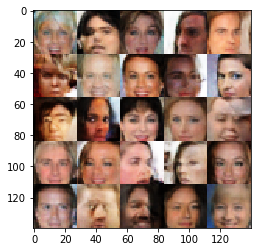

Epoch 4/4... Discriminator Loss: 1.2970... Generator Loss: 0.6158
Epoch 4/4... Discriminator Loss: 1.2207... Generator Loss: 0.6517
Epoch 4/4... Discriminator Loss: 0.6984... Generator Loss: 1.5128
Epoch 4/4... Discriminator Loss: 0.7495... Generator Loss: 2.4163
Epoch 4/4... Discriminator Loss: 0.7169... Generator Loss: 1.3099
Epoch 4/4... Discriminator Loss: 0.9080... Generator Loss: 0.9682
Epoch 4/4... Discriminator Loss: 1.0402... Generator Loss: 2.1002
Epoch 4/4... Discriminator Loss: 0.6480... Generator Loss: 1.6405
Epoch 4/4... Discriminator Loss: 0.9907... Generator Loss: 0.8940
Epoch 4/4... Discriminator Loss: 0.8768... Generator Loss: 1.0744


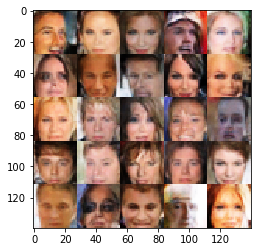

Epoch 4/4... Discriminator Loss: 1.0518... Generator Loss: 0.7588
Epoch 4/4... Discriminator Loss: 0.6107... Generator Loss: 1.6563
Epoch 4/4... Discriminator Loss: 0.9586... Generator Loss: 0.8939
Epoch 4/4... Discriminator Loss: 0.5804... Generator Loss: 1.9147
Epoch 4/4... Discriminator Loss: 0.9495... Generator Loss: 1.0345
Epoch 4/4... Discriminator Loss: 1.7536... Generator Loss: 0.3513
Epoch 4/4... Discriminator Loss: 0.8927... Generator Loss: 1.0675
Epoch 4/4... Discriminator Loss: 0.6208... Generator Loss: 1.6589
Epoch 4/4... Discriminator Loss: 0.9424... Generator Loss: 1.0306
Epoch 4/4... Discriminator Loss: 0.9434... Generator Loss: 1.0918


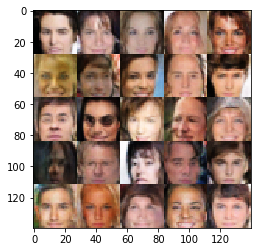

Epoch 4/4... Discriminator Loss: 1.3946... Generator Loss: 0.5328
Epoch 4/4... Discriminator Loss: 0.8069... Generator Loss: 1.3237
Epoch 4/4... Discriminator Loss: 1.4079... Generator Loss: 0.5153
Epoch 4/4... Discriminator Loss: 0.7687... Generator Loss: 1.8243
Epoch 4/4... Discriminator Loss: 0.7452... Generator Loss: 1.3183
Epoch 4/4... Discriminator Loss: 0.9454... Generator Loss: 2.3698
Epoch 4/4... Discriminator Loss: 0.9152... Generator Loss: 0.9365
Epoch 4/4... Discriminator Loss: 0.7686... Generator Loss: 1.6590
Epoch 4/4... Discriminator Loss: 0.7655... Generator Loss: 1.3454
Epoch 4/4... Discriminator Loss: 0.8096... Generator Loss: 1.9306


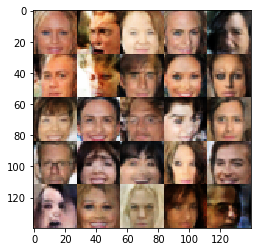

Epoch 4/4... Discriminator Loss: 1.1589... Generator Loss: 0.6587
Epoch 4/4... Discriminator Loss: 1.0942... Generator Loss: 0.7381
Epoch 4/4... Discriminator Loss: 0.9743... Generator Loss: 0.9522
Epoch 4/4... Discriminator Loss: 1.1294... Generator Loss: 0.7241
Epoch 4/4... Discriminator Loss: 0.7501... Generator Loss: 1.3287
Epoch 4/4... Discriminator Loss: 1.0857... Generator Loss: 0.9614
Epoch 4/4... Discriminator Loss: 0.6495... Generator Loss: 1.5747
Epoch 4/4... Discriminator Loss: 1.0136... Generator Loss: 0.7963
Epoch 4/4... Discriminator Loss: 0.7769... Generator Loss: 1.3266
Epoch 4/4... Discriminator Loss: 1.0580... Generator Loss: 0.7748


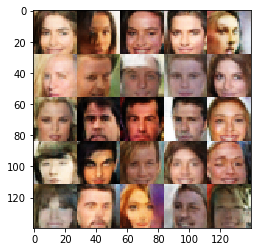

Epoch 4/4... Discriminator Loss: 1.5613... Generator Loss: 0.3934
Epoch 4/4... Discriminator Loss: 0.9697... Generator Loss: 0.9769
Epoch 4/4... Discriminator Loss: 0.9042... Generator Loss: 0.9991
Epoch 4/4... Discriminator Loss: 1.2010... Generator Loss: 0.6272
Epoch 4/4... Discriminator Loss: 1.3147... Generator Loss: 0.5188
Epoch 4/4... Discriminator Loss: 1.3125... Generator Loss: 0.5776
Epoch 4/4... Discriminator Loss: 1.0194... Generator Loss: 0.8190
Epoch 4/4... Discriminator Loss: 1.0847... Generator Loss: 0.7661
Epoch 4/4... Discriminator Loss: 0.9333... Generator Loss: 1.0887
Epoch 4/4... Discriminator Loss: 1.0023... Generator Loss: 0.9417


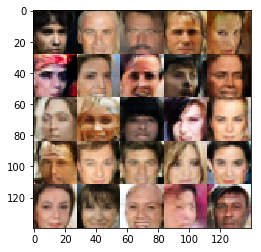

Epoch 4/4... Discriminator Loss: 1.1970... Generator Loss: 0.6720
Epoch 4/4... Discriminator Loss: 0.8230... Generator Loss: 1.6750
Epoch 4/4... Discriminator Loss: 1.4598... Generator Loss: 0.4479
Epoch 4/4... Discriminator Loss: 0.6619... Generator Loss: 1.9176
Epoch 4/4... Discriminator Loss: 1.0075... Generator Loss: 0.9556
Epoch 4/4... Discriminator Loss: 0.8333... Generator Loss: 1.1269
Epoch 4/4... Discriminator Loss: 0.8966... Generator Loss: 1.2043
Epoch 4/4... Discriminator Loss: 1.0058... Generator Loss: 1.1913
Epoch 4/4... Discriminator Loss: 1.2096... Generator Loss: 0.6986
Epoch 4/4... Discriminator Loss: 1.0125... Generator Loss: 0.8059


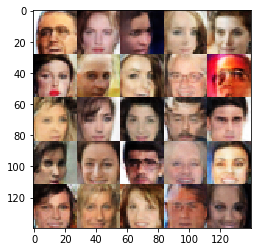

Epoch 4/4... Discriminator Loss: 0.9809... Generator Loss: 0.9064
Epoch 4/4... Discriminator Loss: 0.6059... Generator Loss: 1.9237
Epoch 4/4... Discriminator Loss: 0.8104... Generator Loss: 1.5496
Epoch 4/4... Discriminator Loss: 0.8237... Generator Loss: 1.1792
Epoch 4/4... Discriminator Loss: 1.2045... Generator Loss: 0.6359
Epoch 4/4... Discriminator Loss: 1.0053... Generator Loss: 1.0427
Epoch 4/4... Discriminator Loss: 1.1810... Generator Loss: 0.7020
Epoch 4/4... Discriminator Loss: 0.7227... Generator Loss: 1.5443
Epoch 4/4... Discriminator Loss: 0.5567... Generator Loss: 2.1189
Epoch 4/4... Discriminator Loss: 1.1379... Generator Loss: 0.7386


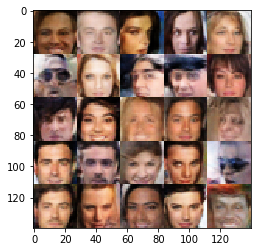

Epoch 4/4... Discriminator Loss: 1.2000... Generator Loss: 0.6843
Epoch 4/4... Discriminator Loss: 0.8705... Generator Loss: 1.7788
Epoch 4/4... Discriminator Loss: 0.7823... Generator Loss: 1.2186
Epoch 4/4... Discriminator Loss: 1.1560... Generator Loss: 0.6798
Epoch 4/4... Discriminator Loss: 0.6188... Generator Loss: 1.8466
Epoch 4/4... Discriminator Loss: 1.0023... Generator Loss: 0.8165
Epoch 4/4... Discriminator Loss: 1.3959... Generator Loss: 0.5074
Epoch 4/4... Discriminator Loss: 1.4434... Generator Loss: 0.5066
Epoch 4/4... Discriminator Loss: 1.0883... Generator Loss: 1.8685
Epoch 4/4... Discriminator Loss: 0.8264... Generator Loss: 1.1953


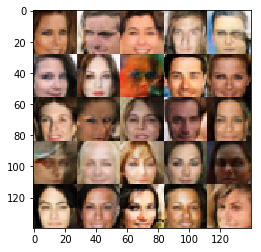

Epoch 4/4... Discriminator Loss: 1.0740... Generator Loss: 0.8006
Epoch 4/4... Discriminator Loss: 1.5764... Generator Loss: 0.4284
Epoch 4/4... Discriminator Loss: 0.9240... Generator Loss: 1.0995
Epoch 4/4... Discriminator Loss: 0.8183... Generator Loss: 1.3621
Epoch 4/4... Discriminator Loss: 1.1919... Generator Loss: 0.6261
Epoch 4/4... Discriminator Loss: 0.8667... Generator Loss: 1.0648
Epoch 4/4... Discriminator Loss: 0.7972... Generator Loss: 1.2223
Epoch 4/4... Discriminator Loss: 0.9320... Generator Loss: 0.9534
Epoch 4/4... Discriminator Loss: 0.6309... Generator Loss: 1.7182
Epoch 4/4... Discriminator Loss: 0.8193... Generator Loss: 1.2468


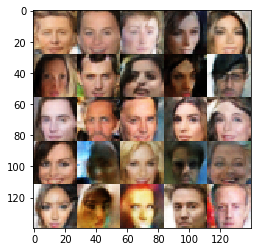

Epoch 4/4... Discriminator Loss: 0.7570... Generator Loss: 1.2083
Epoch 4/4... Discriminator Loss: 0.9954... Generator Loss: 0.8934
Epoch 4/4... Discriminator Loss: 0.9579... Generator Loss: 0.9781
Epoch 4/4... Discriminator Loss: 0.8448... Generator Loss: 1.1474
Epoch 4/4... Discriminator Loss: 0.8020... Generator Loss: 1.2580
Epoch 4/4... Discriminator Loss: 1.1043... Generator Loss: 0.7201
Epoch 4/4... Discriminator Loss: 0.6167... Generator Loss: 1.5852
Epoch 4/4... Discriminator Loss: 1.0687... Generator Loss: 0.7646
Epoch 4/4... Discriminator Loss: 1.1524... Generator Loss: 0.7257
Epoch 4/4... Discriminator Loss: 0.9689... Generator Loss: 0.9559


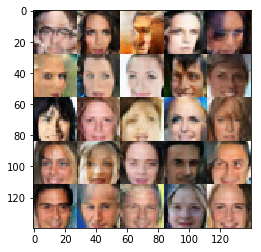

Epoch 4/4... Discriminator Loss: 0.9033... Generator Loss: 1.0204
Epoch 4/4... Discriminator Loss: 0.8510... Generator Loss: 1.4033
Epoch 4/4... Discriminator Loss: 0.8836... Generator Loss: 1.1627
Epoch 4/4... Discriminator Loss: 0.7565... Generator Loss: 1.5740
Epoch 4/4... Discriminator Loss: 0.6085... Generator Loss: 1.9994
Epoch 4/4... Discriminator Loss: 1.5689... Generator Loss: 0.4618
Epoch 4/4... Discriminator Loss: 0.7072... Generator Loss: 1.7282
Epoch 4/4... Discriminator Loss: 0.8775... Generator Loss: 1.1175
Epoch 4/4... Discriminator Loss: 0.6710... Generator Loss: 1.4961
Epoch 4/4... Discriminator Loss: 0.7552... Generator Loss: 1.3737


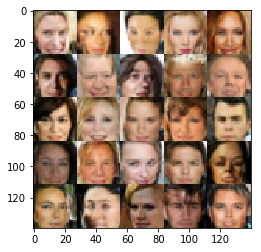

Epoch 4/4... Discriminator Loss: 1.3001... Generator Loss: 0.5834
Epoch 4/4... Discriminator Loss: 1.0103... Generator Loss: 0.8577
Epoch 4/4... Discriminator Loss: 1.1290... Generator Loss: 0.7208
Epoch 4/4... Discriminator Loss: 1.0438... Generator Loss: 0.7892
Epoch 4/4... Discriminator Loss: 0.9237... Generator Loss: 1.0375
Epoch 4/4... Discriminator Loss: 1.0300... Generator Loss: 0.8076
Epoch 4/4... Discriminator Loss: 1.1839... Generator Loss: 0.6563
Epoch 4/4... Discriminator Loss: 0.5265... Generator Loss: 2.3966
Epoch 4/4... Discriminator Loss: 1.0728... Generator Loss: 0.7892
Epoch 4/4... Discriminator Loss: 0.8514... Generator Loss: 1.0786


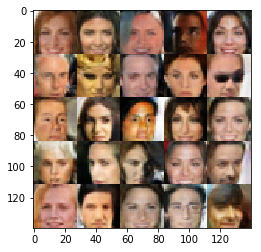

Epoch 4/4... Discriminator Loss: 0.9203... Generator Loss: 0.9946
Epoch 4/4... Discriminator Loss: 0.9330... Generator Loss: 1.0157
Epoch 4/4... Discriminator Loss: 1.6349... Generator Loss: 0.3689
Epoch 4/4... Discriminator Loss: 0.8927... Generator Loss: 1.2221
Epoch 4/4... Discriminator Loss: 1.7562... Generator Loss: 0.3202
Epoch 4/4... Discriminator Loss: 0.7144... Generator Loss: 1.9818
Epoch 4/4... Discriminator Loss: 1.2832... Generator Loss: 0.5365
Epoch 4/4... Discriminator Loss: 0.8693... Generator Loss: 1.0930
Epoch 4/4... Discriminator Loss: 1.1974... Generator Loss: 0.6496
Epoch 4/4... Discriminator Loss: 0.8302... Generator Loss: 1.2636


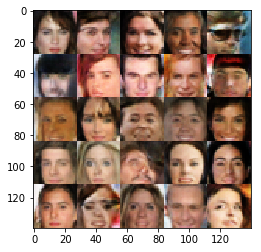

Epoch 4/4... Discriminator Loss: 0.8430... Generator Loss: 1.1574
Epoch 4/4... Discriminator Loss: 0.7835... Generator Loss: 1.1743
Epoch 4/4... Discriminator Loss: 1.8323... Generator Loss: 0.3145
Epoch 4/4... Discriminator Loss: 1.0528... Generator Loss: 0.7968
Epoch 4/4... Discriminator Loss: 1.1900... Generator Loss: 0.7152
Epoch 4/4... Discriminator Loss: 0.8433... Generator Loss: 1.3430
Epoch 4/4... Discriminator Loss: 0.6900... Generator Loss: 1.9043
Epoch 4/4... Discriminator Loss: 1.3815... Generator Loss: 0.5003
Epoch 4/4... Discriminator Loss: 1.1382... Generator Loss: 0.6763
Epoch 4/4... Discriminator Loss: 0.8749... Generator Loss: 1.1584


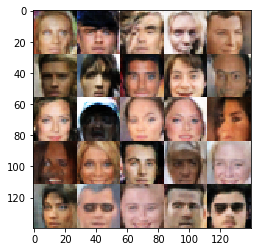

Epoch 4/4... Discriminator Loss: 1.2251... Generator Loss: 0.6270
Epoch 4/4... Discriminator Loss: 1.1734... Generator Loss: 0.6625
Epoch 4/4... Discriminator Loss: 0.8747... Generator Loss: 1.0756
Epoch 4/4... Discriminator Loss: 0.8886... Generator Loss: 1.1652
Epoch 4/4... Discriminator Loss: 1.0152... Generator Loss: 1.9845
Epoch 4/4... Discriminator Loss: 1.0131... Generator Loss: 0.8299
Epoch 4/4... Discriminator Loss: 1.2038... Generator Loss: 0.8089
Epoch 4/4... Discriminator Loss: 1.0770... Generator Loss: 0.7582
Epoch 4/4... Discriminator Loss: 1.3049... Generator Loss: 0.6257
Epoch 4/4... Discriminator Loss: 1.2114... Generator Loss: 0.6605


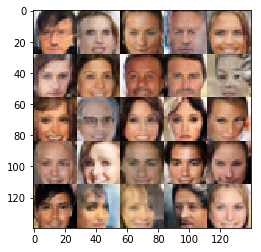

Epoch 4/4... Discriminator Loss: 0.9449... Generator Loss: 0.9398
Epoch 4/4... Discriminator Loss: 0.9848... Generator Loss: 0.9462
Epoch 4/4... Discriminator Loss: 0.7533... Generator Loss: 1.4239
Epoch 4/4... Discriminator Loss: 0.7762... Generator Loss: 1.2216
Epoch 4/4... Discriminator Loss: 0.6664... Generator Loss: 1.7079
Epoch 4/4... Discriminator Loss: 1.1627... Generator Loss: 0.6625
Epoch 4/4... Discriminator Loss: 1.0885... Generator Loss: 0.9111
Epoch 4/4... Discriminator Loss: 0.8920... Generator Loss: 1.0223
Epoch 4/4... Discriminator Loss: 1.4107... Generator Loss: 0.4889
Epoch 4/4... Discriminator Loss: 0.9131... Generator Loss: 1.0016


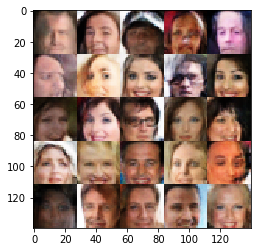

Epoch 4/4... Discriminator Loss: 0.8971... Generator Loss: 1.0564
Epoch 4/4... Discriminator Loss: 0.7728... Generator Loss: 1.5871
Epoch 4/4... Discriminator Loss: 1.0791... Generator Loss: 1.0097
Epoch 4/4... Discriminator Loss: 0.9523... Generator Loss: 0.9246
Epoch 4/4... Discriminator Loss: 0.9767... Generator Loss: 1.4179
Epoch 4/4... Discriminator Loss: 1.0783... Generator Loss: 0.7724
Epoch 4/4... Discriminator Loss: 1.0944... Generator Loss: 0.8161
Epoch 4/4... Discriminator Loss: 0.9502... Generator Loss: 0.9186
Epoch 4/4... Discriminator Loss: 1.2571... Generator Loss: 0.6237
Epoch 4/4... Discriminator Loss: 1.0793... Generator Loss: 0.8748


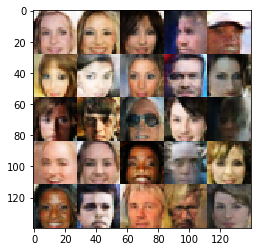

Epoch 4/4... Discriminator Loss: 0.7677... Generator Loss: 1.4124
Epoch 4/4... Discriminator Loss: 0.8544... Generator Loss: 1.4143
Epoch 4/4... Discriminator Loss: 0.6815... Generator Loss: 1.6006
Epoch 4/4... Discriminator Loss: 0.7377... Generator Loss: 1.5610
Epoch 4/4... Discriminator Loss: 0.8533... Generator Loss: 1.1588
Epoch 4/4... Discriminator Loss: 1.5116... Generator Loss: 0.5069
Epoch 4/4... Discriminator Loss: 1.1240... Generator Loss: 0.7472
Epoch 4/4... Discriminator Loss: 0.8808... Generator Loss: 0.9932
Epoch 4/4... Discriminator Loss: 0.9802... Generator Loss: 0.9947
Epoch 4/4... Discriminator Loss: 1.3424... Generator Loss: 0.5325


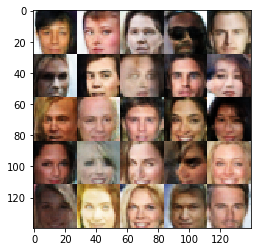

Epoch 4/4... Discriminator Loss: 0.9869... Generator Loss: 0.8311
Epoch 4/4... Discriminator Loss: 1.5285... Generator Loss: 0.4315
Epoch 4/4... Discriminator Loss: 1.0488... Generator Loss: 0.8175
Epoch 4/4... Discriminator Loss: 1.6544... Generator Loss: 0.3557
Epoch 4/4... Discriminator Loss: 1.2022... Generator Loss: 0.6431
Epoch 4/4... Discriminator Loss: 0.8891... Generator Loss: 0.9624
Epoch 4/4... Discriminator Loss: 1.0246... Generator Loss: 0.8718
Epoch 4/4... Discriminator Loss: 1.5137... Generator Loss: 0.4249
Epoch 4/4... Discriminator Loss: 0.6615... Generator Loss: 1.5590
Epoch 4/4... Discriminator Loss: 0.9237... Generator Loss: 0.9786


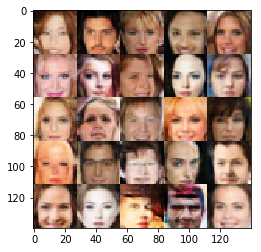

Epoch 4/4... Discriminator Loss: 1.2348... Generator Loss: 0.6797
Epoch 4/4... Discriminator Loss: 0.7456... Generator Loss: 1.3528
Epoch 4/4... Discriminator Loss: 0.6663... Generator Loss: 1.7019
Epoch 4/4... Discriminator Loss: 1.3890... Generator Loss: 0.5466
Epoch 4/4... Discriminator Loss: 0.6668... Generator Loss: 1.6650
Epoch 4/4... Discriminator Loss: 0.9371... Generator Loss: 0.9529
Epoch 4/4... Discriminator Loss: 0.6921... Generator Loss: 2.0206
Epoch 4/4... Discriminator Loss: 1.0173... Generator Loss: 0.8390
Epoch 4/4... Discriminator Loss: 1.9179... Generator Loss: 0.3403
Epoch 4/4... Discriminator Loss: 0.7039... Generator Loss: 1.5073


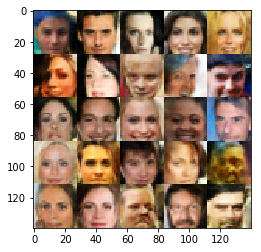

Epoch 4/4... Discriminator Loss: 1.1418... Generator Loss: 0.6741
Epoch 4/4... Discriminator Loss: 1.4065... Generator Loss: 0.4578
Epoch 4/4... Discriminator Loss: 0.9601... Generator Loss: 0.8957
Epoch 4/4... Discriminator Loss: 1.7785... Generator Loss: 0.3289
Epoch 4/4... Discriminator Loss: 1.2922... Generator Loss: 0.5869
Epoch 4/4... Discriminator Loss: 1.1450... Generator Loss: 0.6724
Epoch 4/4... Discriminator Loss: 0.8997... Generator Loss: 1.0036
Epoch 4/4... Discriminator Loss: 0.9917... Generator Loss: 0.8690
Epoch 4/4... Discriminator Loss: 1.3517... Generator Loss: 0.5369
Epoch 4/4... Discriminator Loss: 0.7348... Generator Loss: 1.2513


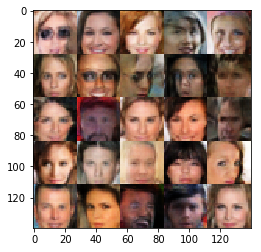

Epoch 4/4... Discriminator Loss: 1.0783... Generator Loss: 0.8932
Epoch 4/4... Discriminator Loss: 0.6358... Generator Loss: 1.6701
Epoch 4/4... Discriminator Loss: 0.7160... Generator Loss: 1.4277
Epoch 4/4... Discriminator Loss: 0.9150... Generator Loss: 0.9919
Epoch 4/4... Discriminator Loss: 1.0614... Generator Loss: 0.8150
Epoch 4/4... Discriminator Loss: 1.0445... Generator Loss: 0.7777
Epoch 4/4... Discriminator Loss: 1.4138... Generator Loss: 0.5339
Epoch 4/4... Discriminator Loss: 1.5937... Generator Loss: 0.4237
Epoch 4/4... Discriminator Loss: 0.9170... Generator Loss: 1.1324
Epoch 4/4... Discriminator Loss: 1.3309... Generator Loss: 0.6379


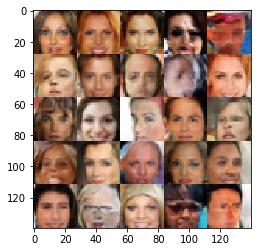

Epoch 4/4... Discriminator Loss: 1.3837... Generator Loss: 0.5811
Epoch 4/4... Discriminator Loss: 1.3173... Generator Loss: 0.5312
Epoch 4/4... Discriminator Loss: 0.7098... Generator Loss: 1.5289
Epoch 4/4... Discriminator Loss: 1.0034... Generator Loss: 0.7909
Epoch 4/4... Discriminator Loss: 0.8949... Generator Loss: 1.2008
Epoch 4/4... Discriminator Loss: 0.7541... Generator Loss: 1.9508
Epoch 4/4... Discriminator Loss: 0.9912... Generator Loss: 0.8757
Epoch 4/4... Discriminator Loss: 1.5369... Generator Loss: 0.4302
Epoch 4/4... Discriminator Loss: 1.5293... Generator Loss: 0.4195
Epoch 4/4... Discriminator Loss: 0.7727... Generator Loss: 1.1519


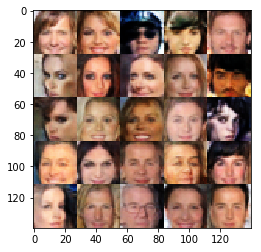

Epoch 4/4... Discriminator Loss: 0.7553... Generator Loss: 1.3459
Epoch 4/4... Discriminator Loss: 0.8846... Generator Loss: 1.3306
Epoch 4/4... Discriminator Loss: 0.8456... Generator Loss: 1.2159
Epoch 4/4... Discriminator Loss: 0.7999... Generator Loss: 1.7218
Epoch 4/4... Discriminator Loss: 0.7459... Generator Loss: 1.2413
Epoch 4/4... Discriminator Loss: 0.6771... Generator Loss: 1.8411
Epoch 4/4... Discriminator Loss: 0.8609... Generator Loss: 1.0784
Epoch 4/4... Discriminator Loss: 1.1304... Generator Loss: 0.7421
Epoch 4/4... Discriminator Loss: 1.2062... Generator Loss: 0.7027
Epoch 4/4... Discriminator Loss: 0.9294... Generator Loss: 0.9734


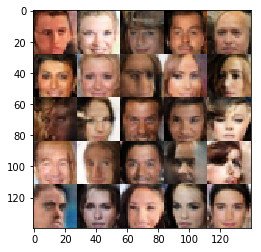

Epoch 4/4... Discriminator Loss: 1.0438... Generator Loss: 0.9217
Epoch 4/4... Discriminator Loss: 0.6176... Generator Loss: 2.4142
Epoch 4/4... Discriminator Loss: 1.6773... Generator Loss: 0.3459
Epoch 4/4... Discriminator Loss: 1.7251... Generator Loss: 0.3770
Epoch 4/4... Discriminator Loss: 1.0056... Generator Loss: 0.8462
Epoch 4/4... Discriminator Loss: 0.9300... Generator Loss: 0.9696
Epoch 4/4... Discriminator Loss: 0.9807... Generator Loss: 0.8690
Epoch 4/4... Discriminator Loss: 0.9778... Generator Loss: 1.0979
Epoch 4/4... Discriminator Loss: 0.9687... Generator Loss: 1.0619
Epoch 4/4... Discriminator Loss: 0.7884... Generator Loss: 1.2869


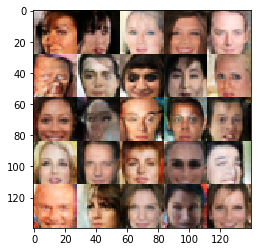

Epoch 4/4... Discriminator Loss: 0.7096... Generator Loss: 1.4954
Epoch 4/4... Discriminator Loss: 0.9404... Generator Loss: 0.9756
Epoch 4/4... Discriminator Loss: 1.0624... Generator Loss: 0.8117
Epoch 4/4... Discriminator Loss: 1.1360... Generator Loss: 0.7378
Epoch 4/4... Discriminator Loss: 0.8886... Generator Loss: 0.9759
Epoch 4/4... Discriminator Loss: 0.8243... Generator Loss: 1.1039
Epoch 4/4... Discriminator Loss: 0.9275... Generator Loss: 0.9844
Epoch 4/4... Discriminator Loss: 0.8832... Generator Loss: 0.9755
Epoch 4/4... Discriminator Loss: 1.1974... Generator Loss: 0.6539
Epoch 4/4... Discriminator Loss: 0.7566... Generator Loss: 2.5559


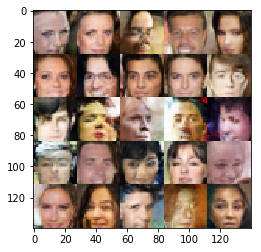

Epoch 4/4... Discriminator Loss: 1.0037... Generator Loss: 0.8348
Epoch 4/4... Discriminator Loss: 0.6837... Generator Loss: 1.4824
Epoch 4/4... Discriminator Loss: 1.0324... Generator Loss: 0.7677
Epoch 4/4... Discriminator Loss: 0.7445... Generator Loss: 1.3090
Epoch 4/4... Discriminator Loss: 0.8831... Generator Loss: 1.3506
Epoch 4/4... Discriminator Loss: 1.1625... Generator Loss: 0.6735
Epoch 4/4... Discriminator Loss: 0.8105... Generator Loss: 1.2337
Epoch 4/4... Discriminator Loss: 0.8350... Generator Loss: 1.4234
Epoch 4/4... Discriminator Loss: 0.8458... Generator Loss: 1.0313
Epoch 4/4... Discriminator Loss: 0.5696... Generator Loss: 2.0171


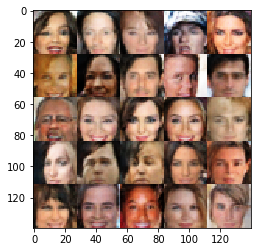

Epoch 4/4... Discriminator Loss: 1.3204... Generator Loss: 0.5172
Epoch 4/4... Discriminator Loss: 0.6638... Generator Loss: 1.5195
Epoch 4/4... Discriminator Loss: 1.0739... Generator Loss: 0.8502
Epoch 4/4... Discriminator Loss: 1.2647... Generator Loss: 0.6358
Epoch 4/4... Discriminator Loss: 0.8520... Generator Loss: 1.0907
Epoch 4/4... Discriminator Loss: 0.8063... Generator Loss: 2.1924
Epoch 4/4... Discriminator Loss: 0.7640... Generator Loss: 1.2723
Epoch 4/4... Discriminator Loss: 0.6265... Generator Loss: 1.8791
Epoch 4/4... Discriminator Loss: 0.8083... Generator Loss: 1.4425
Epoch 4/4... Discriminator Loss: 0.8571... Generator Loss: 1.1664


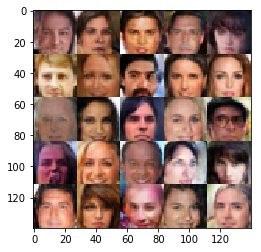

Epoch 4/4... Discriminator Loss: 0.8977... Generator Loss: 1.0535
Epoch 4/4... Discriminator Loss: 1.1294... Generator Loss: 0.7174
Epoch 4/4... Discriminator Loss: 1.2196... Generator Loss: 0.6096
Epoch 4/4... Discriminator Loss: 1.1294... Generator Loss: 0.7524
Epoch 4/4... Discriminator Loss: 0.9774... Generator Loss: 0.8976
Epoch 4/4... Discriminator Loss: 1.0188... Generator Loss: 0.8339
Epoch 4/4... Discriminator Loss: 0.9703... Generator Loss: 0.9119
Epoch 4/4... Discriminator Loss: 1.2487... Generator Loss: 0.5798
Epoch 4/4... Discriminator Loss: 1.4463... Generator Loss: 0.5108
Epoch 4/4... Discriminator Loss: 1.0152... Generator Loss: 0.9285


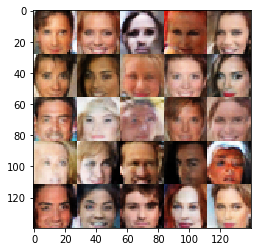

Epoch 4/4... Discriminator Loss: 1.2506... Generator Loss: 0.7262
Epoch 4/4... Discriminator Loss: 0.7187... Generator Loss: 2.1837
Epoch 4/4... Discriminator Loss: 1.0559... Generator Loss: 0.7933
Epoch 4/4... Discriminator Loss: 1.3570... Generator Loss: 0.5953
Epoch 4/4... Discriminator Loss: 0.9557... Generator Loss: 0.9370
Epoch 4/4... Discriminator Loss: 1.4304... Generator Loss: 0.4740
Epoch 4/4... Discriminator Loss: 1.1826... Generator Loss: 2.1971
Epoch 4/4... Discriminator Loss: 0.8020... Generator Loss: 1.1843
Epoch 4/4... Discriminator Loss: 0.9738... Generator Loss: 0.8156
Epoch 4/4... Discriminator Loss: 1.3518... Generator Loss: 0.5371


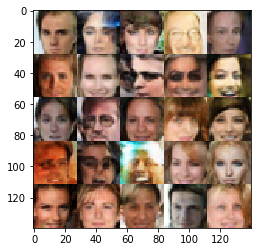

Epoch 4/4... Discriminator Loss: 0.9985... Generator Loss: 0.8648
Epoch 4/4... Discriminator Loss: 1.1478... Generator Loss: 0.7306
Epoch 4/4... Discriminator Loss: 0.8353... Generator Loss: 1.2536
Epoch 4/4... Discriminator Loss: 1.1418... Generator Loss: 0.6509
Epoch 4/4... Discriminator Loss: 1.0651... Generator Loss: 0.8690
Epoch 4/4... Discriminator Loss: 0.8922... Generator Loss: 1.1476
Epoch 4/4... Discriminator Loss: 0.9574... Generator Loss: 0.9889
Epoch 4/4... Discriminator Loss: 0.8814... Generator Loss: 1.2286
Epoch 4/4... Discriminator Loss: 0.9319... Generator Loss: 0.9636
Epoch 4/4... Discriminator Loss: 0.7628... Generator Loss: 1.5697


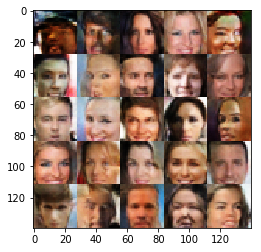

Epoch 4/4... Discriminator Loss: 0.9632... Generator Loss: 0.8741
Epoch 4/4... Discriminator Loss: 0.8395... Generator Loss: 1.1435
Epoch 4/4... Discriminator Loss: 0.8411... Generator Loss: 1.7957
Epoch 4/4... Discriminator Loss: 0.7858... Generator Loss: 1.3407
Epoch 4/4... Discriminator Loss: 0.7662... Generator Loss: 1.3585
Epoch 4/4... Discriminator Loss: 0.8804... Generator Loss: 1.1349
Epoch 4/4... Discriminator Loss: 1.1706... Generator Loss: 0.6738
Epoch 4/4... Discriminator Loss: 1.1383... Generator Loss: 0.7105
Epoch 4/4... Discriminator Loss: 0.9853... Generator Loss: 0.9206
Epoch 4/4... Discriminator Loss: 0.8574... Generator Loss: 1.0301


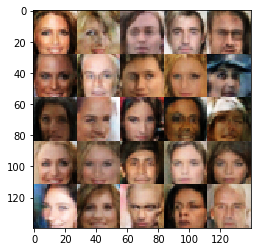

Epoch 4/4... Discriminator Loss: 1.2082... Generator Loss: 0.5973
Epoch 4/4... Discriminator Loss: 0.8349... Generator Loss: 1.1185
Epoch 4/4... Discriminator Loss: 0.9840... Generator Loss: 0.9412
Epoch 4/4... Discriminator Loss: 0.7657... Generator Loss: 2.0080
Epoch 4/4... Discriminator Loss: 1.1535... Generator Loss: 0.6965
Epoch 4/4... Discriminator Loss: 1.3910... Generator Loss: 0.5577
Epoch 4/4... Discriminator Loss: 0.7171... Generator Loss: 1.3961
Epoch 4/4... Discriminator Loss: 1.2081... Generator Loss: 0.6637
Epoch 4/4... Discriminator Loss: 0.8107... Generator Loss: 1.2270
Epoch 4/4... Discriminator Loss: 0.8358... Generator Loss: 1.0810


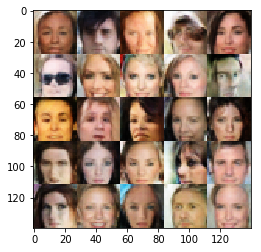

Epoch 4/4... Discriminator Loss: 0.7972... Generator Loss: 1.3773
Epoch 4/4... Discriminator Loss: 0.7397... Generator Loss: 1.5302
Epoch 4/4... Discriminator Loss: 0.9373... Generator Loss: 1.3222
Epoch 4/4... Discriminator Loss: 0.9040... Generator Loss: 1.0095
Epoch 4/4... Discriminator Loss: 1.0831... Generator Loss: 0.8961
Epoch 4/4... Discriminator Loss: 1.0322... Generator Loss: 1.0076
Epoch 4/4... Discriminator Loss: 1.5707... Generator Loss: 0.4865
Epoch 4/4... Discriminator Loss: 0.8356... Generator Loss: 1.2675
Epoch 4/4... Discriminator Loss: 0.9346... Generator Loss: 1.0343
Epoch 4/4... Discriminator Loss: 1.2238... Generator Loss: 0.6086


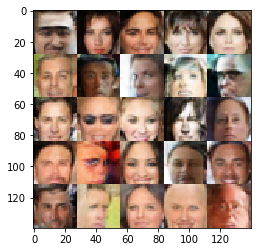

Epoch 4/4... Discriminator Loss: 0.8963... Generator Loss: 0.9886
Epoch 4/4... Discriminator Loss: 0.8118... Generator Loss: 2.1025
Epoch 4/4... Discriminator Loss: 0.7465... Generator Loss: 1.5542
Epoch 4/4... Discriminator Loss: 0.6811... Generator Loss: 1.6681
Epoch 4/4... Discriminator Loss: 0.8537... Generator Loss: 1.2971
Epoch 4/4... Discriminator Loss: 0.9543... Generator Loss: 1.0007
Epoch 4/4... Discriminator Loss: 1.6022... Generator Loss: 0.3967
Epoch 4/4... Discriminator Loss: 1.0062... Generator Loss: 0.9318
Epoch 4/4... Discriminator Loss: 0.7116... Generator Loss: 1.4058
Epoch 4/4... Discriminator Loss: 0.8396... Generator Loss: 1.4092


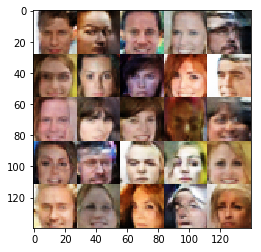

Epoch 4/4... Discriminator Loss: 0.9943... Generator Loss: 0.8247
Epoch 4/4... Discriminator Loss: 0.8637... Generator Loss: 1.8402
Epoch 4/4... Discriminator Loss: 0.7052... Generator Loss: 1.5453
Epoch 4/4... Discriminator Loss: 1.1444... Generator Loss: 0.6733
Epoch 4/4... Discriminator Loss: 0.7461... Generator Loss: 1.3274
Epoch 4/4... Discriminator Loss: 1.2949... Generator Loss: 0.6149
Epoch 4/4... Discriminator Loss: 0.9070... Generator Loss: 0.9717
Epoch 4/4... Discriminator Loss: 0.9263... Generator Loss: 0.9496
Epoch 4/4... Discriminator Loss: 0.7069... Generator Loss: 1.4653
Epoch 4/4... Discriminator Loss: 1.0803... Generator Loss: 0.7394


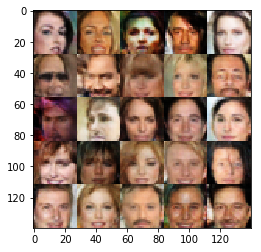

Epoch 4/4... Discriminator Loss: 0.6420... Generator Loss: 1.7640
Epoch 4/4... Discriminator Loss: 1.4539... Generator Loss: 0.4675
Epoch 4/4... Discriminator Loss: 0.7638... Generator Loss: 1.3606
Epoch 4/4... Discriminator Loss: 0.6022... Generator Loss: 1.7129
Epoch 4/4... Discriminator Loss: 1.2391... Generator Loss: 0.5576
Epoch 4/4... Discriminator Loss: 0.8107... Generator Loss: 1.9889
Epoch 4/4... Discriminator Loss: 0.9413... Generator Loss: 0.9388
Epoch 4/4... Discriminator Loss: 0.8554... Generator Loss: 1.0742
Epoch 4/4... Discriminator Loss: 1.4747... Generator Loss: 0.4694
Epoch 4/4... Discriminator Loss: 0.8880... Generator Loss: 0.9885


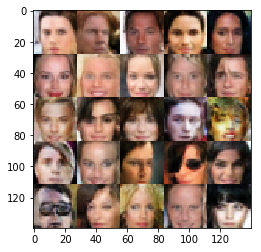

Epoch 4/4... Discriminator Loss: 0.6821... Generator Loss: 1.3909
Epoch 4/4... Discriminator Loss: 0.9697... Generator Loss: 0.8215
Epoch 4/4... Discriminator Loss: 0.6856... Generator Loss: 1.4200
Epoch 4/4... Discriminator Loss: 0.6160... Generator Loss: 1.7382
Epoch 4/4... Discriminator Loss: 1.1728... Generator Loss: 0.6633
Epoch 4/4... Discriminator Loss: 1.0834... Generator Loss: 0.7585
Epoch 4/4... Discriminator Loss: 0.7428... Generator Loss: 1.5683
Epoch 4/4... Discriminator Loss: 0.7690... Generator Loss: 1.4179
Epoch 4/4... Discriminator Loss: 0.8123... Generator Loss: 1.1415
Epoch 4/4... Discriminator Loss: 0.8438... Generator Loss: 1.1691


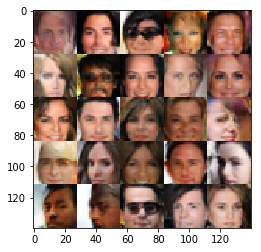

Epoch 4/4... Discriminator Loss: 1.0897... Generator Loss: 0.8086
Epoch 4/4... Discriminator Loss: 0.6907... Generator Loss: 1.6547
Epoch 4/4... Discriminator Loss: 0.9438... Generator Loss: 1.3128
Epoch 4/4... Discriminator Loss: 1.0001... Generator Loss: 0.8439
Epoch 4/4... Discriminator Loss: 0.9426... Generator Loss: 0.9215
Epoch 4/4... Discriminator Loss: 0.8273... Generator Loss: 1.1378
Epoch 4/4... Discriminator Loss: 0.8138... Generator Loss: 1.5495
Epoch 4/4... Discriminator Loss: 0.6113... Generator Loss: 1.9213
Epoch 4/4... Discriminator Loss: 1.1465... Generator Loss: 0.6951
Epoch 4/4... Discriminator Loss: 0.7275... Generator Loss: 1.2489


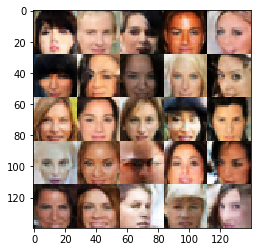

Epoch 4/4... Discriminator Loss: 0.8851... Generator Loss: 1.1593
Epoch 4/4... Discriminator Loss: 1.1299... Generator Loss: 0.7205
Epoch 4/4... Discriminator Loss: 1.2113... Generator Loss: 0.6376
Epoch 4/4... Discriminator Loss: 0.9267... Generator Loss: 1.0413
Epoch 4/4... Discriminator Loss: 0.8254... Generator Loss: 1.3409
Epoch 4/4... Discriminator Loss: 1.2792... Generator Loss: 0.5677
Epoch 4/4... Discriminator Loss: 1.2701... Generator Loss: 0.7000
Epoch 4/4... Discriminator Loss: 1.1491... Generator Loss: 0.6955
Epoch 4/4... Discriminator Loss: 1.5883... Generator Loss: 0.3875
Epoch 4/4... Discriminator Loss: 0.9346... Generator Loss: 1.0461


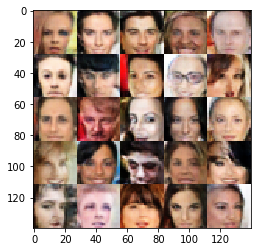

Epoch 4/4... Discriminator Loss: 1.3379... Generator Loss: 0.6745
Epoch 4/4... Discriminator Loss: 0.9984... Generator Loss: 0.9128
Epoch 4/4... Discriminator Loss: 1.1300... Generator Loss: 0.7482
Epoch 4/4... Discriminator Loss: 0.8951... Generator Loss: 1.6428
Epoch 4/4... Discriminator Loss: 0.8453... Generator Loss: 1.2758
Epoch 4/4... Discriminator Loss: 0.7272... Generator Loss: 1.4979
Epoch 4/4... Discriminator Loss: 0.7129... Generator Loss: 1.5268
Epoch 4/4... Discriminator Loss: 1.0038... Generator Loss: 0.8759
Epoch 4/4... Discriminator Loss: 0.8957... Generator Loss: 1.0640
Epoch 4/4... Discriminator Loss: 0.9953... Generator Loss: 0.8961


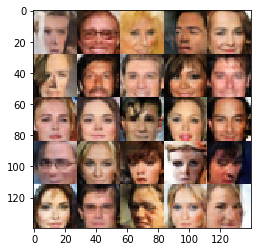

Epoch 4/4... Discriminator Loss: 0.6394... Generator Loss: 1.9889
Epoch 4/4... Discriminator Loss: 1.4684... Generator Loss: 0.4522
Epoch 4/4... Discriminator Loss: 0.8423... Generator Loss: 1.0757
Epoch 4/4... Discriminator Loss: 1.5876... Generator Loss: 0.4083
Epoch 4/4... Discriminator Loss: 1.1642... Generator Loss: 0.6758
Epoch 4/4... Discriminator Loss: 1.3400... Generator Loss: 0.5613
Epoch 4/4... Discriminator Loss: 0.8460... Generator Loss: 1.1431
Epoch 4/4... Discriminator Loss: 1.0630... Generator Loss: 2.5904
Epoch 4/4... Discriminator Loss: 0.7487... Generator Loss: 1.3687
Epoch 4/4... Discriminator Loss: 0.9000... Generator Loss: 0.9624


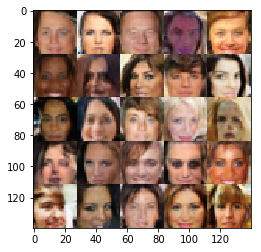

Epoch 4/4... Discriminator Loss: 0.7357... Generator Loss: 1.8756
Epoch 4/4... Discriminator Loss: 0.6064... Generator Loss: 2.0820
Epoch 4/4... Discriminator Loss: 0.7683... Generator Loss: 2.7038
Epoch 4/4... Discriminator Loss: 0.6320... Generator Loss: 1.8592
Epoch 4/4... Discriminator Loss: 0.9063... Generator Loss: 1.0026
Epoch 4/4... Discriminator Loss: 0.6380... Generator Loss: 1.7628
Epoch 4/4... Discriminator Loss: 1.1520... Generator Loss: 0.7344
Epoch 4/4... Discriminator Loss: 0.9962... Generator Loss: 1.5845
Epoch 4/4... Discriminator Loss: 1.0590... Generator Loss: 0.8502
Epoch 4/4... Discriminator Loss: 1.6412... Generator Loss: 0.4239


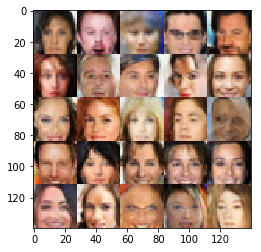

Epoch 4/4... Discriminator Loss: 0.9906... Generator Loss: 0.8259
Epoch 4/4... Discriminator Loss: 1.1576... Generator Loss: 0.6767
Epoch 4/4... Discriminator Loss: 0.8062... Generator Loss: 1.1370
Epoch 4/4... Discriminator Loss: 0.9736... Generator Loss: 0.8898
Epoch 4/4... Discriminator Loss: 0.9144... Generator Loss: 1.3697
Epoch 4/4... Discriminator Loss: 0.9147... Generator Loss: 1.3620
Epoch 4/4... Discriminator Loss: 0.8693... Generator Loss: 1.5607
Epoch 4/4... Discriminator Loss: 0.9961... Generator Loss: 0.9150
Epoch 4/4... Discriminator Loss: 1.1490... Generator Loss: 0.6695
Epoch 4/4... Discriminator Loss: 0.8493... Generator Loss: 1.1183


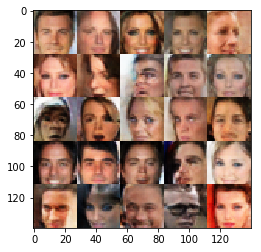

Epoch 4/4... Discriminator Loss: 0.9916... Generator Loss: 1.3685
Epoch 4/4... Discriminator Loss: 0.7434... Generator Loss: 1.3162
Epoch 4/4... Discriminator Loss: 0.8795... Generator Loss: 1.0831
Epoch 4/4... Discriminator Loss: 1.0042... Generator Loss: 0.8092
Epoch 4/4... Discriminator Loss: 0.8828... Generator Loss: 1.1115
Epoch 4/4... Discriminator Loss: 0.9043... Generator Loss: 1.5216
Epoch 4/4... Discriminator Loss: 0.7076... Generator Loss: 2.0135
Epoch 4/4... Discriminator Loss: 1.2982... Generator Loss: 0.5265
Epoch 4/4... Discriminator Loss: 0.7197... Generator Loss: 1.4096
Epoch 4/4... Discriminator Loss: 0.7073... Generator Loss: 1.4896


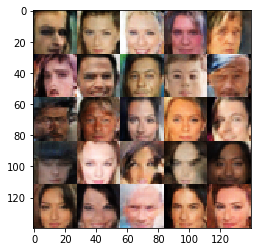

Epoch 4/4... Discriminator Loss: 1.1804... Generator Loss: 0.7053
Epoch 4/4... Discriminator Loss: 0.9773... Generator Loss: 1.1042
Epoch 4/4... Discriminator Loss: 0.9095... Generator Loss: 1.1252
Epoch 4/4... Discriminator Loss: 1.2122... Generator Loss: 0.6961
Epoch 4/4... Discriminator Loss: 0.7932... Generator Loss: 2.3156
Epoch 4/4... Discriminator Loss: 0.9880... Generator Loss: 0.8852
Epoch 4/4... Discriminator Loss: 0.8666... Generator Loss: 1.1408
Epoch 4/4... Discriminator Loss: 1.4881... Generator Loss: 0.4555
Epoch 4/4... Discriminator Loss: 0.9068... Generator Loss: 1.0820
Epoch 4/4... Discriminator Loss: 0.6820... Generator Loss: 1.3484


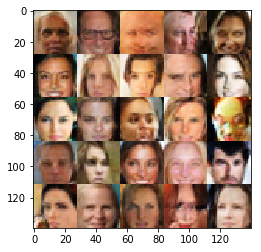

Epoch 4/4... Discriminator Loss: 0.6989... Generator Loss: 1.5188
Epoch 4/4... Discriminator Loss: 1.2743... Generator Loss: 0.5500
Epoch 4/4... Discriminator Loss: 0.9720... Generator Loss: 0.8600
Epoch 4/4... Discriminator Loss: 0.7450... Generator Loss: 1.3701
Epoch 4/4... Discriminator Loss: 0.6552... Generator Loss: 1.6482
Epoch 4/4... Discriminator Loss: 0.8872... Generator Loss: 1.4010
Epoch 4/4... Discriminator Loss: 0.7932... Generator Loss: 1.1966
Epoch 4/4... Discriminator Loss: 0.9560... Generator Loss: 0.9598
Epoch 4/4... Discriminator Loss: 0.6984... Generator Loss: 1.3270
Epoch 4/4... Discriminator Loss: 0.8226... Generator Loss: 1.2352


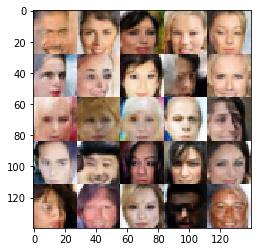

Epoch 4/4... Discriminator Loss: 1.0041... Generator Loss: 0.8626
Epoch 4/4... Discriminator Loss: 0.8746... Generator Loss: 1.0275
Epoch 4/4... Discriminator Loss: 0.7601... Generator Loss: 1.4751
Epoch 4/4... Discriminator Loss: 0.9284... Generator Loss: 0.9483
Epoch 4/4... Discriminator Loss: 1.1133... Generator Loss: 0.6867
Epoch 4/4... Discriminator Loss: 0.8045... Generator Loss: 1.3071
Epoch 4/4... Discriminator Loss: 1.5984... Generator Loss: 0.4083
Epoch 4/4... Discriminator Loss: 0.7076... Generator Loss: 1.4986
Epoch 4/4... Discriminator Loss: 0.9591... Generator Loss: 2.0202
Epoch 4/4... Discriminator Loss: 0.8812... Generator Loss: 1.2449


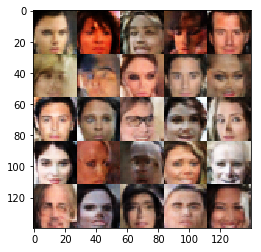

Epoch 4/4... Discriminator Loss: 1.0933... Generator Loss: 0.7584
Epoch 4/4... Discriminator Loss: 0.5332... Generator Loss: 2.3180


In [13]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 4

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.